Looking at how exactly continual learning is going on in the network

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import torch 
import numpy as np
from PIL import Image
from torchvision import transforms
import pandas as pd 
import json 
import copy 
import pickle 
import os 
import sys
import copy
import umap
import wandb
from pytorch_lightning.loggers import WandbLogger
from types import SimpleNamespace
import matplotlib.pyplot as plt
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
sys.path.append('../py_scripts')
from py_scripts import LightningDataModule, get_params_net_dataloader, ModelStyles, DataSet
from py_scripts.dataset_params import DataSet
import glob
import pickle

/home/tbb16/anaconda3/envs/core/lib/python3.8/site-packages/setuptools/distutils_patch.py:25: UserWarning: Distutils was imported before Setuptools. This usage is discouraged and may exhibit undesirable behaviors or errors. Please use Setuptools' objects directly or at least import Setuptools first.
  warnings.warn(


In [2]:
# OUTDATED: SDM model: 1cd30ndy
# SDM linear decay: 5acsdko1
# SDM no L2 norm: z69ejh56
# TopK model: 3f3fxovr
# ReLU: 14kfhln0


model_run_ids = ['z0unvxvg', '3pdsnsk3',  '20runydu', '2vldgubc', 'f2baqhx6']

dataset_path="../data/"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_points = 20

# this is for the pickle activation plots
data_split_or_overall = 'split' # overall

imgs_per_split = 10000

remove_dead = True
dead_threshold_activation_amount = 10

extras = dict(
    epochs_to_train_for=10,
    num_workers=1, 
    adversarial_attacks=True, 
    device=device,
    dataset_path="../data/", 
    log_metrics=False  ,
    check_val_every_n_epoch=1,
)

rand_color_map = {
    0:'red',
    1:'green',
    2:'blue',
    3:'yellow',
    4:'pink',
    5:'black',
    6:'teal',
    7:'brown',
    8:'purple',
    9:'gray',
}
# airplane, 1 automobile (but not truck or pickup truck), 2 bird, 3 cat, 4 deer, 
#5 dog, 6 frog, 7 horse, 8 ship, and truck (but not pickup truck)

def map_colors(labels):
    labels = labels.flatten()
    return [rand_color_map[int(l)] for l in labels] 

def umap_data_and_weights(data, weights):
    
    label1="Data"
    label2="Weights"
    
    reducer = umap.UMAP()  # parallel=False
    reducer.fit(weights)
    data_embedding = reducer.transform(data)
    weights_embedding = reducer.transform(weights)
    plt.figure()
    plt.scatter(data_embedding[:, 0], data_embedding[:, 1], label=label1, alpha=0.5)
    plt.scatter(weights_embedding[:, 0], weights_embedding[:, 1], label=label2, alpha=0.9)
    plt.title("Weights and Training Data - Fit on Weights")
    plt.legend()
    plt.show()
    
    reducer = umap.UMAP()  # parallel=False
    reducer.fit(data)
    data_embedding = reducer.transform(data)
    weights_embedding = reducer.transform(weights)
    plt.figure()
    plt.scatter(data_embedding[:, 0], data_embedding[:, 1], label=label1, alpha=0.5)
    plt.scatter(weights_embedding[:, 0], weights_embedding[:, 1], label=label2)
    plt.title("Weights and Training Data - Fit on Data")
    plt.legend()
    plt.show()
    
    return reducer, data_embedding, weights_embedding
    
def get_weights(ckpt, params):
    if "SDM" in str(params.model_foundation):
        weights = ckpt['state_dict']['sdm_module.fc1.weight']
        out_weights = ckpt['state_dict']['sdm_module.purkinje_layer.weight']
    elif "CLASSIC_FFN" in str(params.model_foundation):
        weights = ckpt['state_dict']['fc1.weight']
        out_weights = ckpt['state_dict']['net.0.weight']
    elif "TOP_K" in str(params.model_foundation):
        weights = ckpt['state_dict']['fc1.weight']
        out_weights = ckpt['state_dict']['output_layer.weight']
    else: 
        raise NotImplementedError()
    return weights, out_weights.T

def get_activations(data, model_path, params, extras):#(data,weights, ckpt):
    
    _, model, _ = get_params_net_dataloader(params.model_style, 
                                                params.dataset, 
                                                load_from_checkpoint=model_path, 
                                                verbose=False,
                                                cont_learn_reset_output_head=False, 
                                                **extras)
    model.reload_neuron_activation_counters()
    with torch.no_grad():
        out = model.forward(data, output_model_data=True)
    logits, model_data_dict = out
    return model_data_dict['post_acts'].T
    '''if "SDM" in str(params.model_foundation):
        activations = weights@data.T
    elif "TOP_K" in str(params.model_foundation) or "CLASSIC_FFN" in str(params.model_foundation):
        activations = (weights@data.T)+ckpt['state_dict']['fc1.bias'].unsqueeze(1)
    else: 
        raise NotImplementedError()
    return activations
    '''
    
def compute_cosine_sim(m1, m2):
    return ( (m1/torch.norm(m1,keepdim=True, dim=1))*(m2/torch.norm(m2,keepdim=True, dim=1))).sum(1)

Run is: z0unvxvg
TopKDefault_Investigate_ContLearning <class 'models.FFN_TOP_K.FFN_TOP_K'>
data path ../data/ params namespace(act_func=ReLU(), act_string='ReLU()', active_threshold=0.0001, adamw_l2_loss_weight=0.001, adversarial_attack_norm=inf, adversarial_attacks=False, adversarial_max_distortion=0.03, alex_net_freeze_layer_swap=False, all_positive_weights=False, batch_size=128, can_enforce_positive_weights_on_bias_terms=True, check_val_every_n_epoch=1, checkpoint_every_n_epochs=100, classification=True, cnn_model=False, continual_learning=True, dataset=<DataSet.SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10: 27>, dataset_path_suffix='CachedOutputs/ConvMixerWTransforms_ImgNet32_CIFAR10/all_data_', dataset_str='SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10', device=device(type='cuda'), dropout_prob=0.0, early_stopping=False, enforce_ewc=False, epoch_relative_to_training_restart=False, epochs_per_dataset=300, epochs_to_train_for=1500, ewc_beta=0.005, ewc_importance=200,

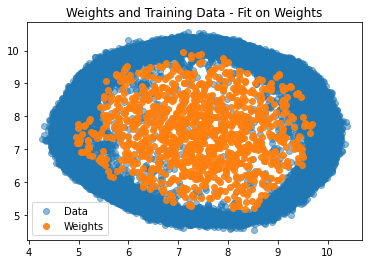

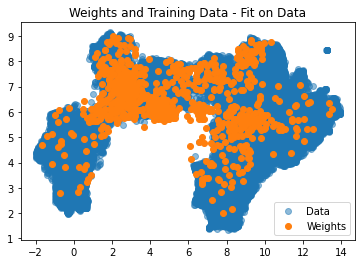

../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/TopKDefault_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks


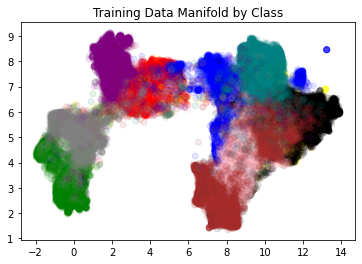

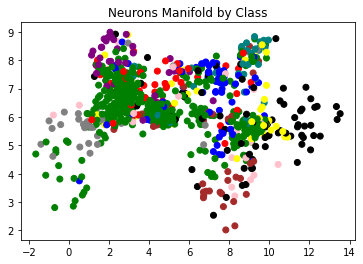

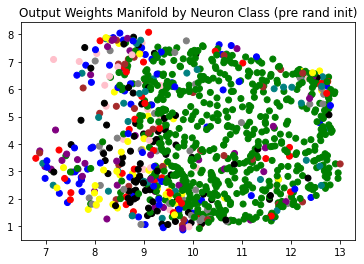

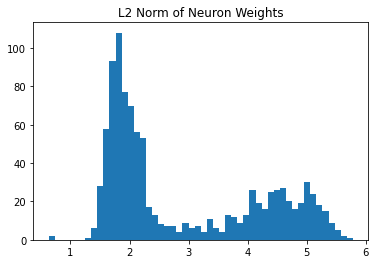

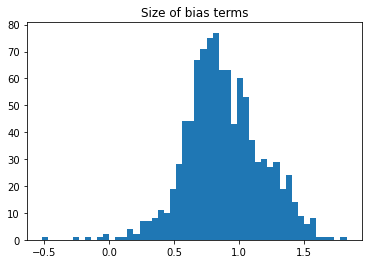

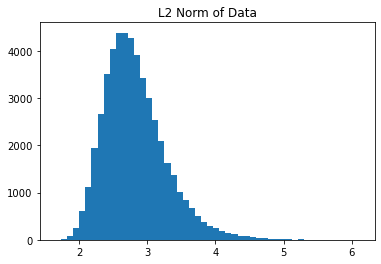

Perc alive neurons tensor(0.4480)


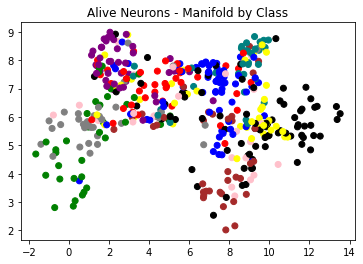

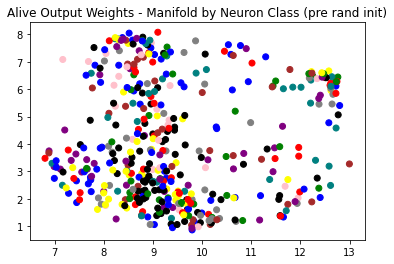

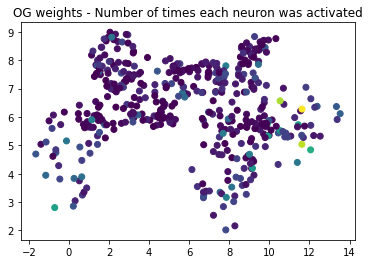

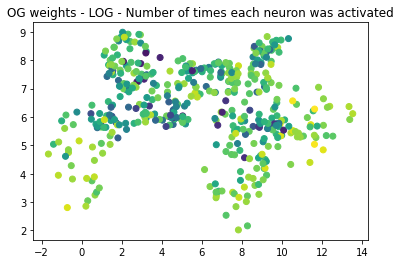

Epoch 0
Data split 0


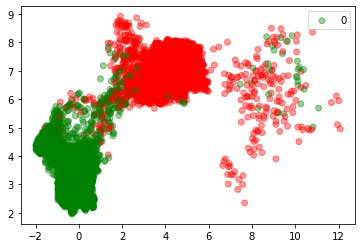

Trimming the output weights. model index is: 0
../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/TopKDefault_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks
Perc alive neurons tensor(0.4280)
Label 0, % neurons most activated=0.1
Label 1, % neurons most activated=0.08


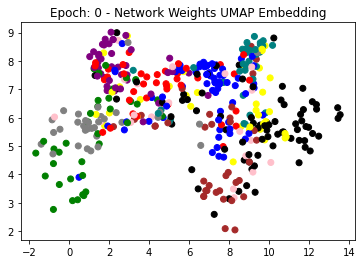

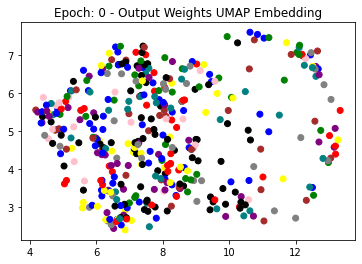

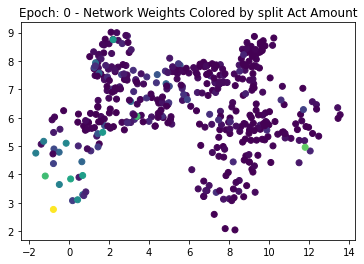

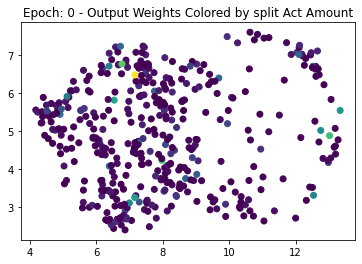

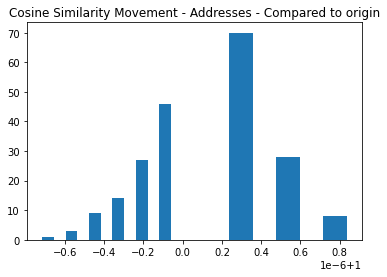

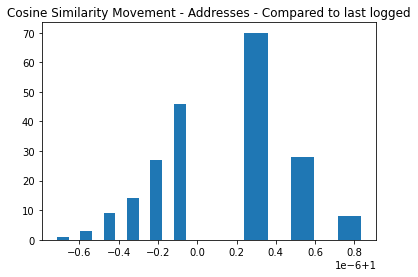

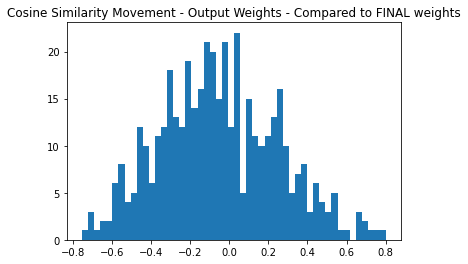

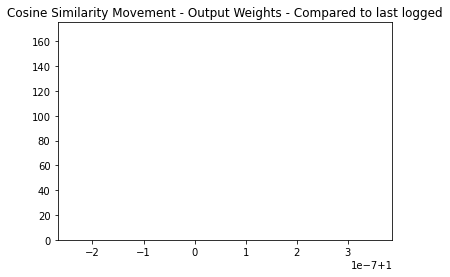

Epoch 99
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=99-step=7899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4280)
Label 0, % neurons most activated=0.09
Label 1, % neurons most activated=0.08


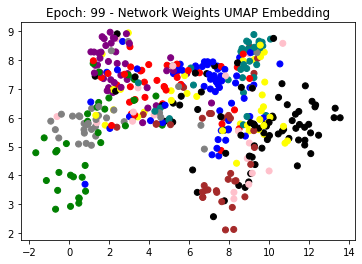

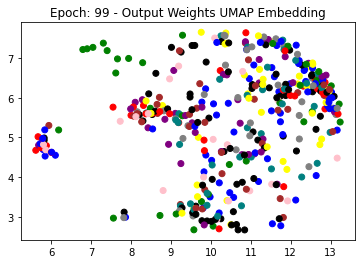

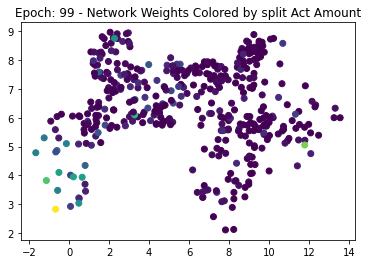

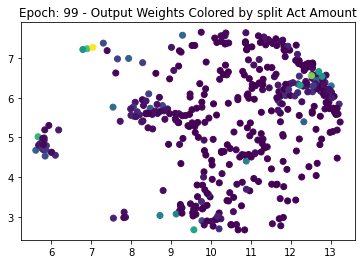

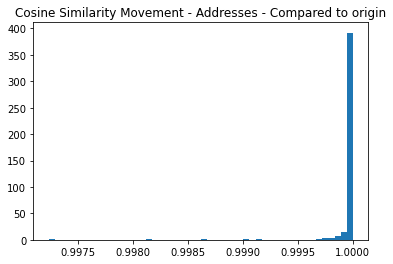

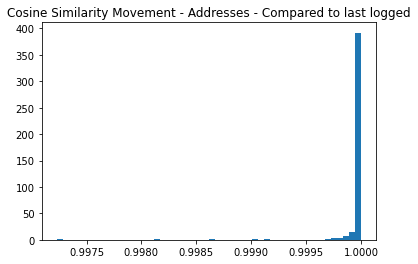

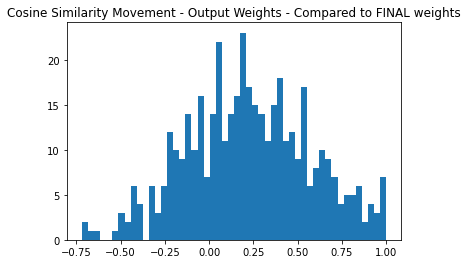

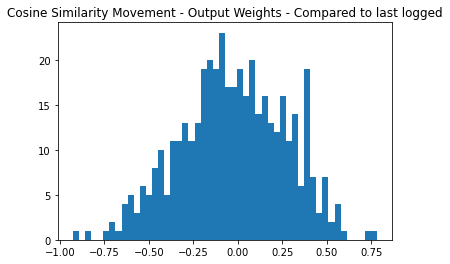

Epoch 199
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=199-step=15799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4280)
Label 0, % neurons most activated=0.09
Label 1, % neurons most activated=0.08


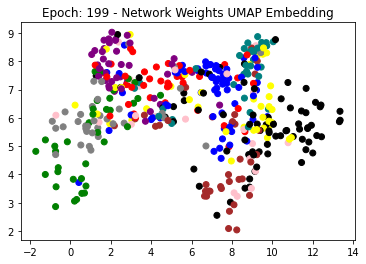

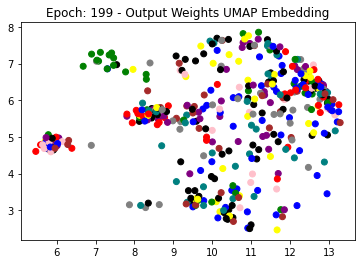

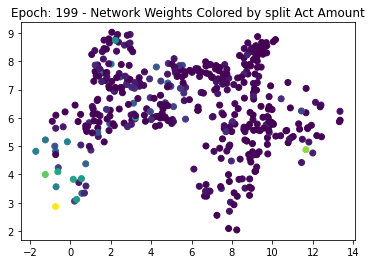

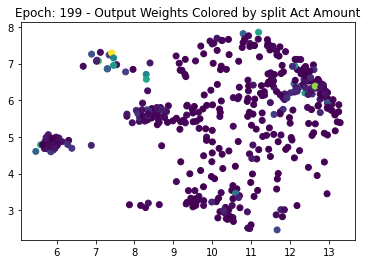

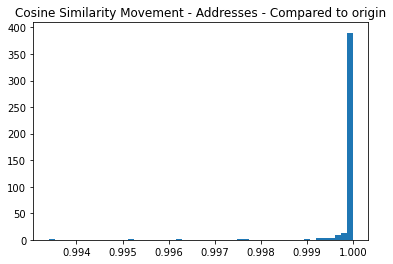

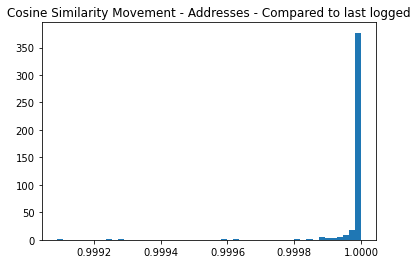

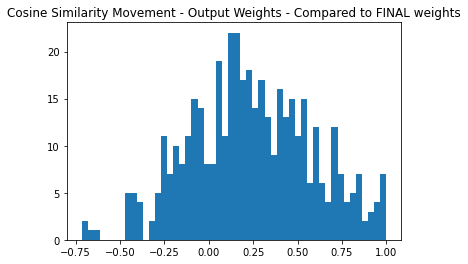

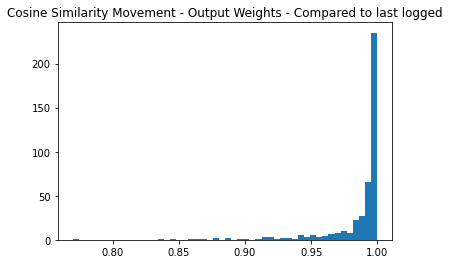

Epoch 299
Data split 1


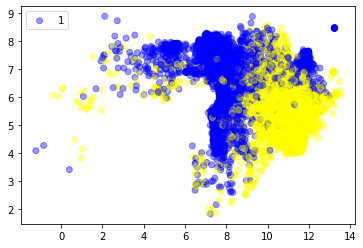

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=299-step=23699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4280)
Label 2, % neurons most activated=0.16
Label 3, % neurons most activated=0.09


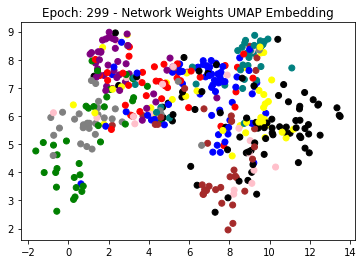

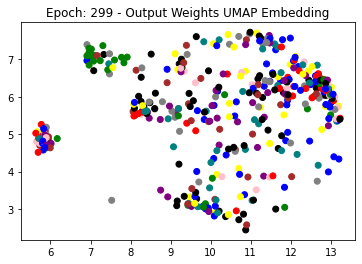

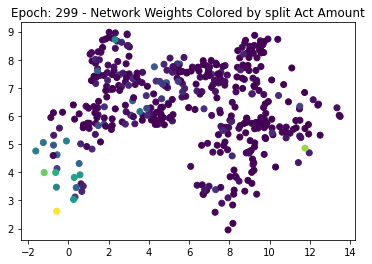

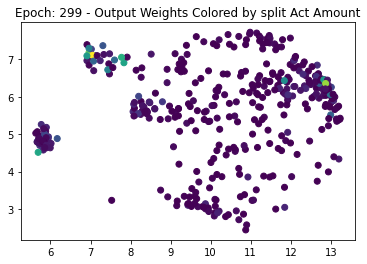

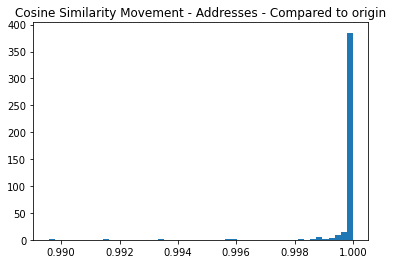

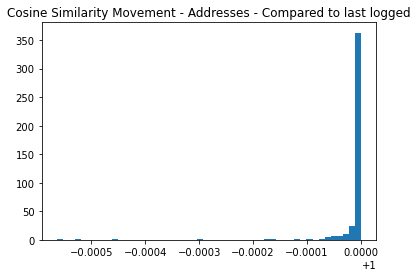

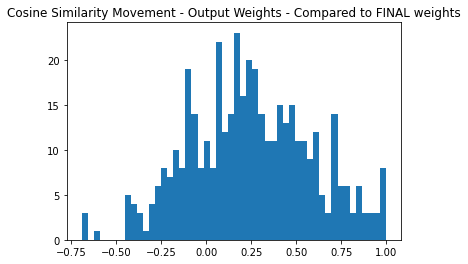

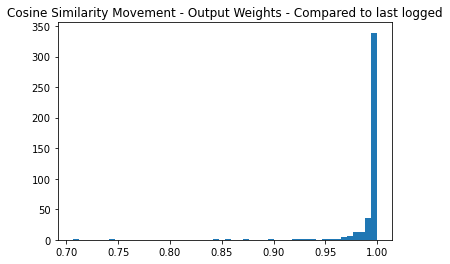

Epoch 399
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=399-step=31599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4250)
Label 2, % neurons most activated=0.16
Label 3, % neurons most activated=0.09


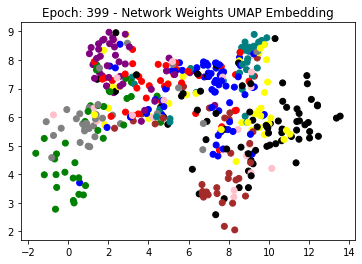

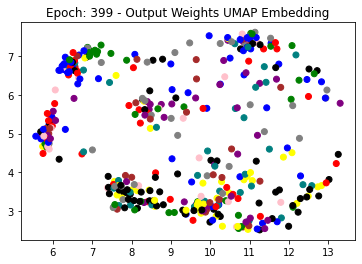

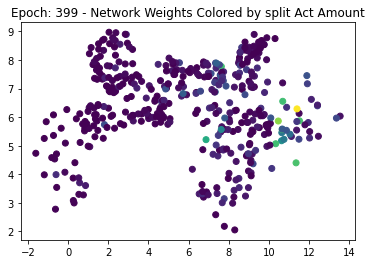

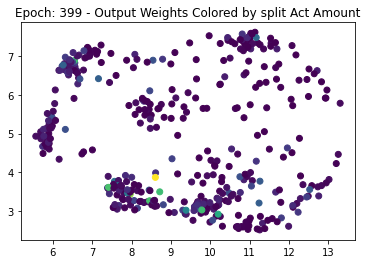

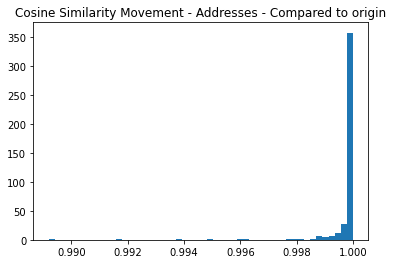

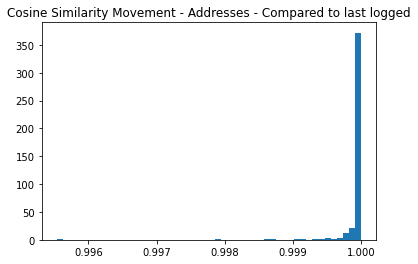

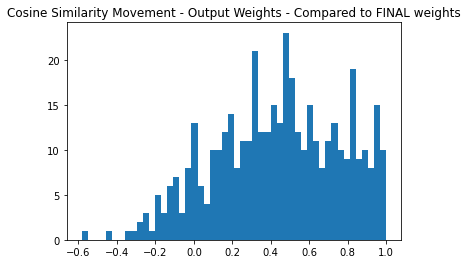

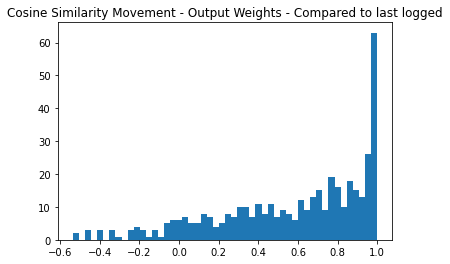

Epoch 499
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=499-step=39499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 2, % neurons most activated=0.16
Label 3, % neurons most activated=0.09


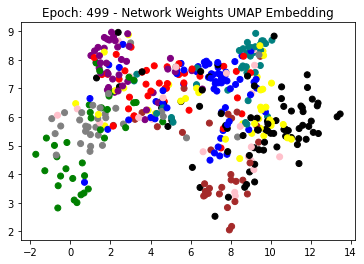

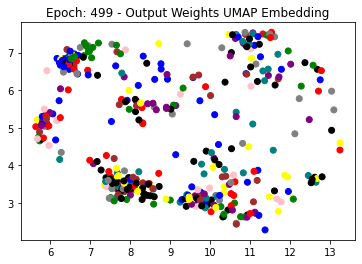

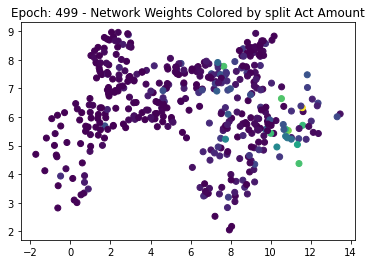

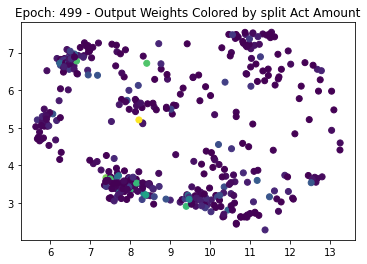

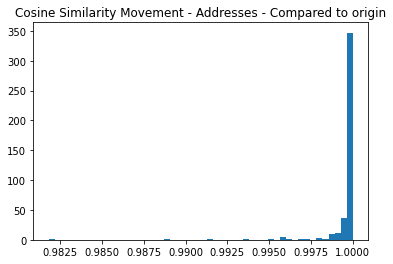

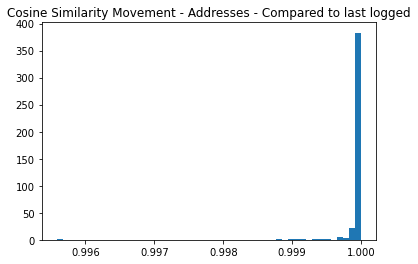

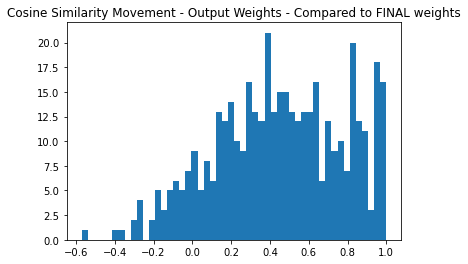

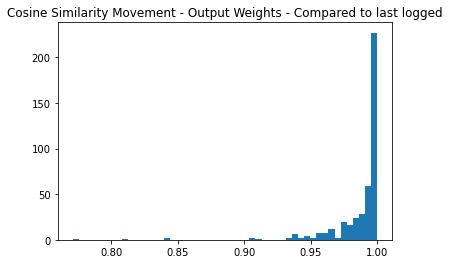

Epoch 599
Data split 2


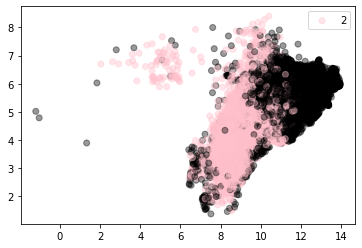

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=599-step=47399.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 4, % neurons most activated=0.05
Label 5, % neurons most activated=0.18


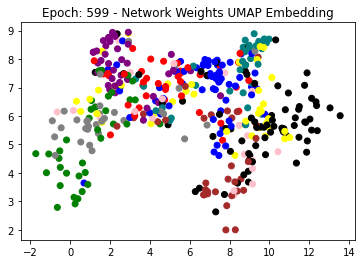

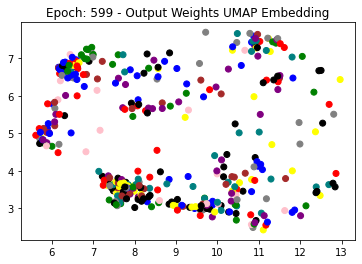

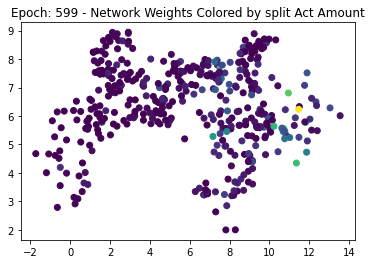

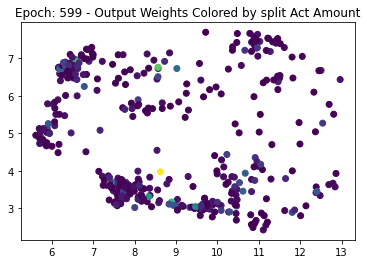

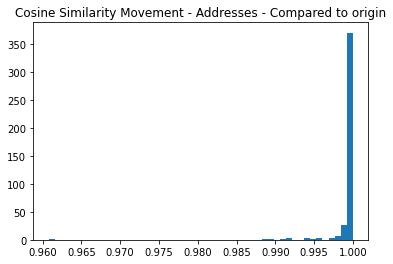

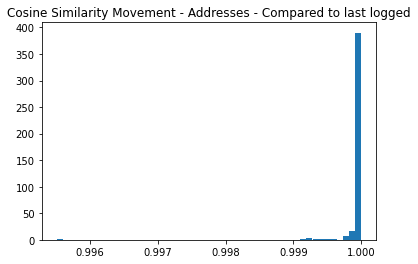

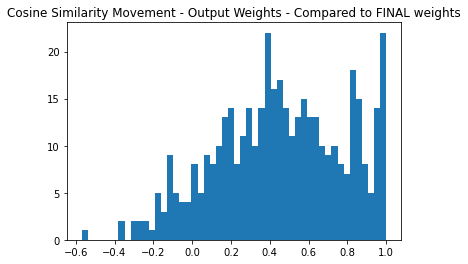

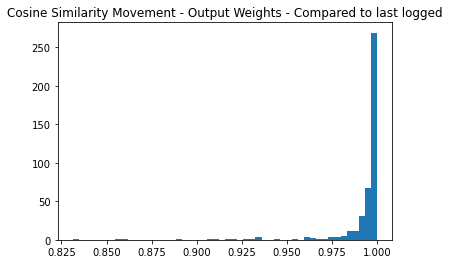

Epoch 699
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=699-step=55299.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 4, % neurons most activated=0.05
Label 5, % neurons most activated=0.18


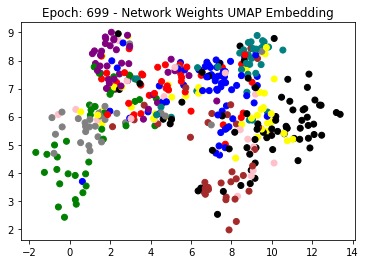

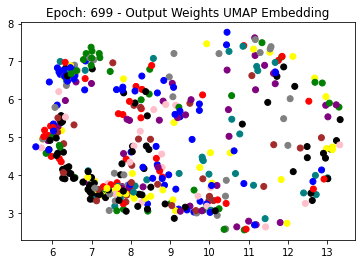

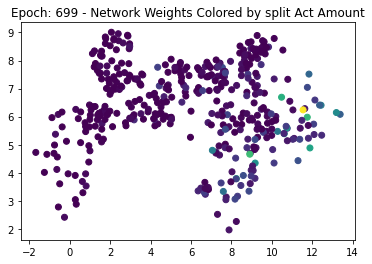

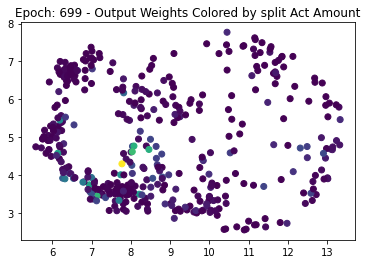

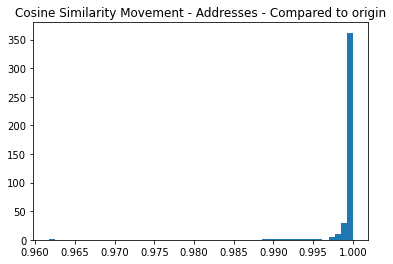

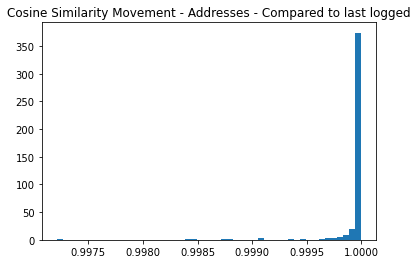

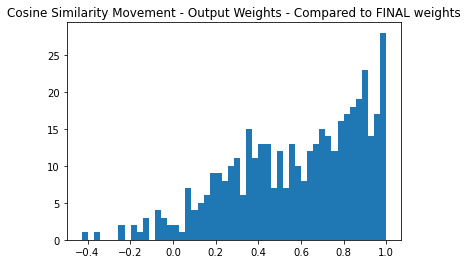

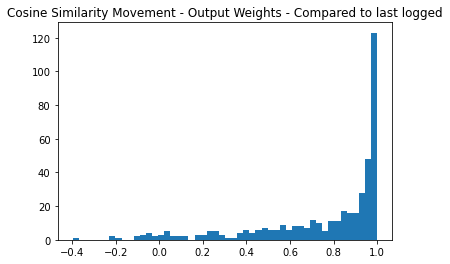

Epoch 799
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=799-step=63199.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 4, % neurons most activated=0.05
Label 5, % neurons most activated=0.18


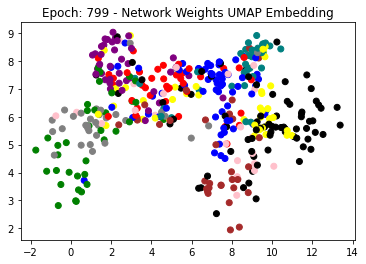

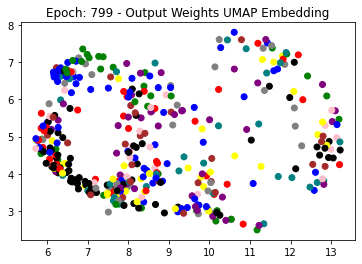

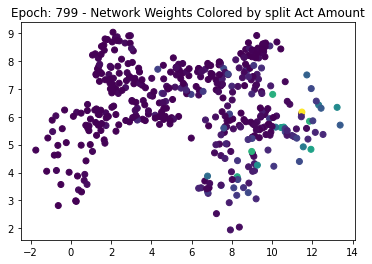

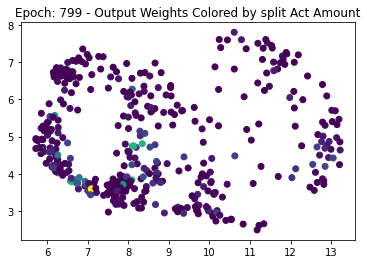

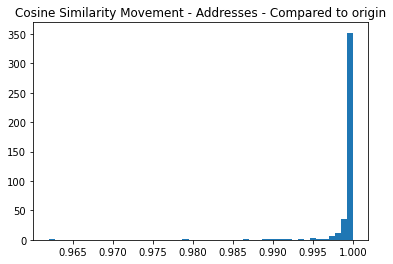

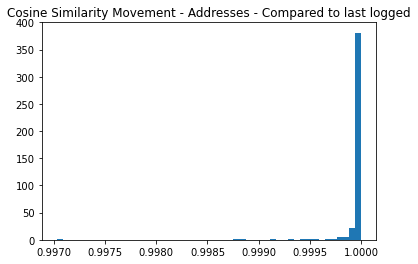

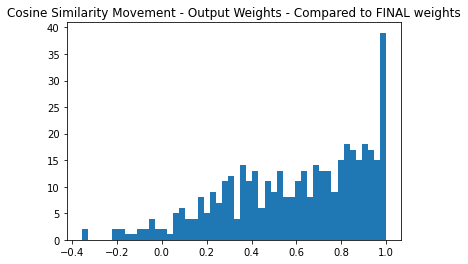

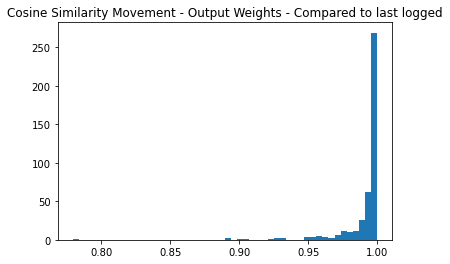

Epoch 899
Data split 3


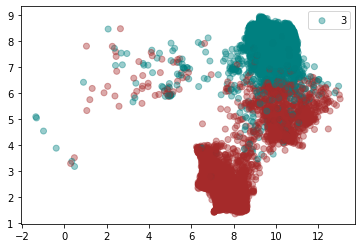

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=899-step=71099.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 6, % neurons most activated=0.08
Label 7, % neurons most activated=0.08


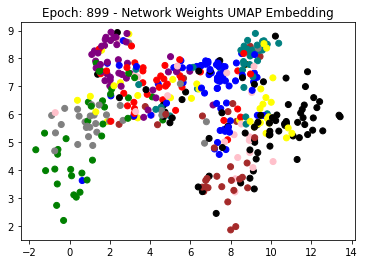

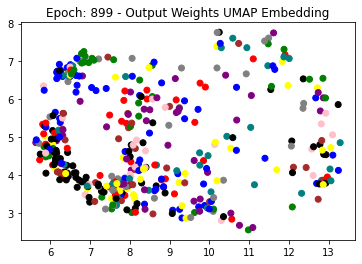

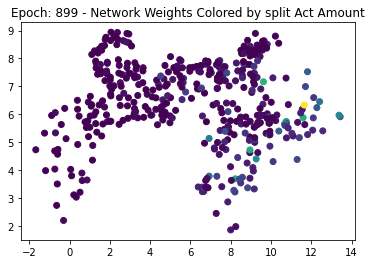

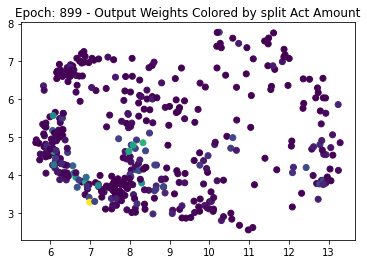

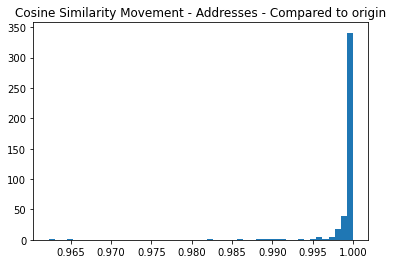

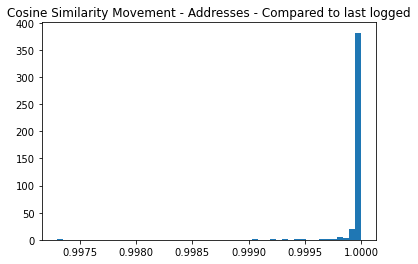

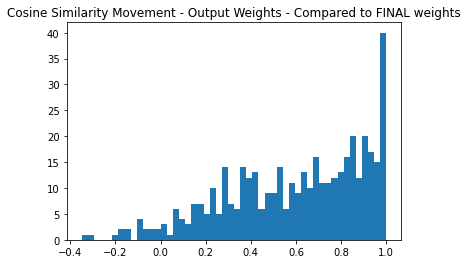

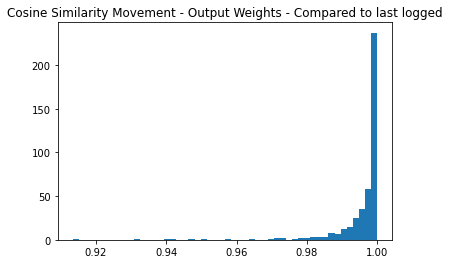

Epoch 999
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=999-step=78999.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 6, % neurons most activated=0.08
Label 7, % neurons most activated=0.08


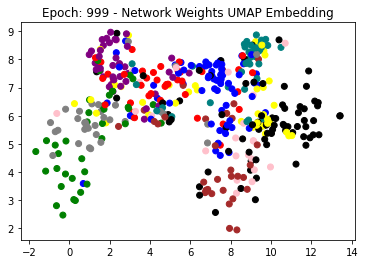

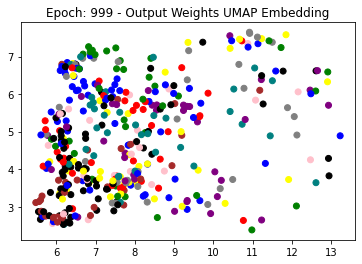

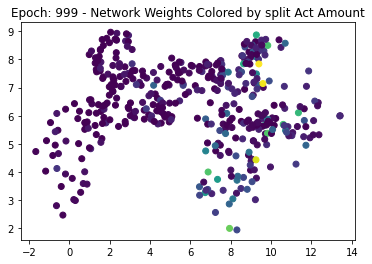

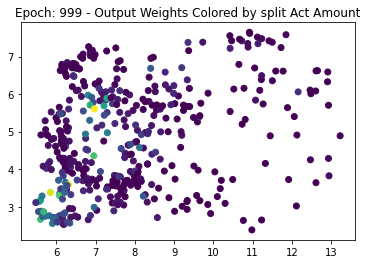

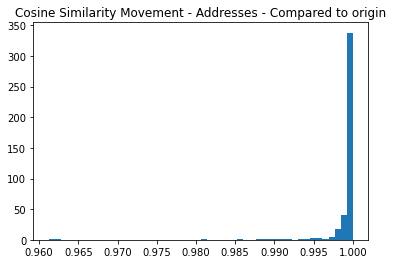

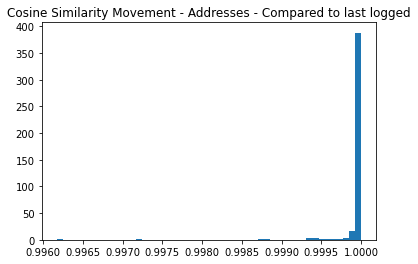

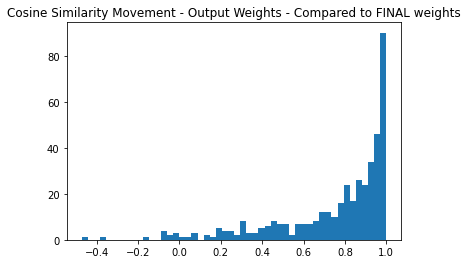

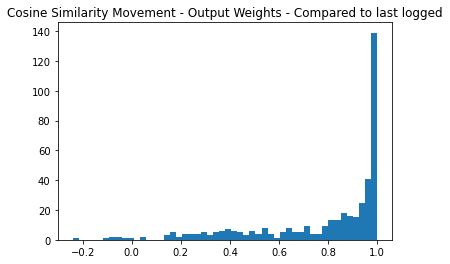

Epoch 1099
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=1099-step=86899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 6, % neurons most activated=0.08
Label 7, % neurons most activated=0.08


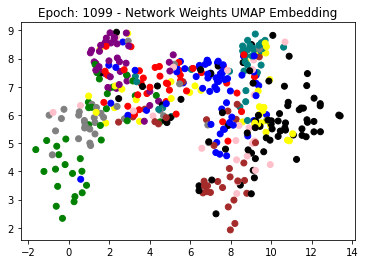

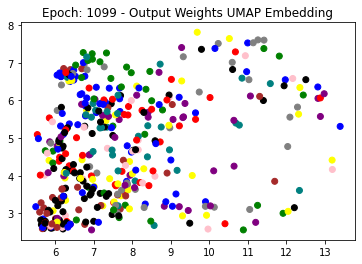

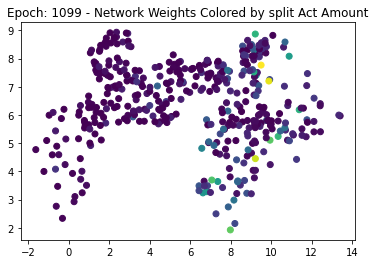

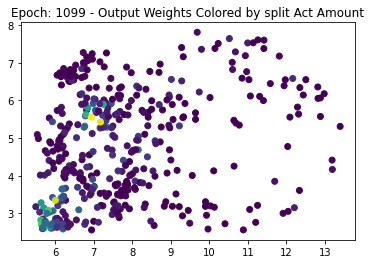

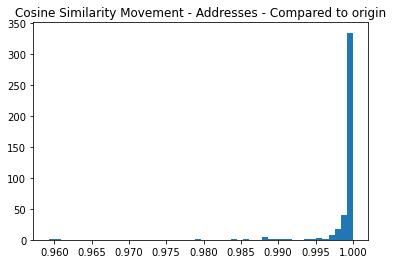

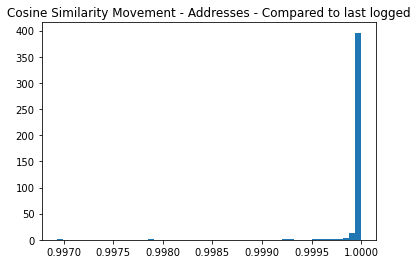

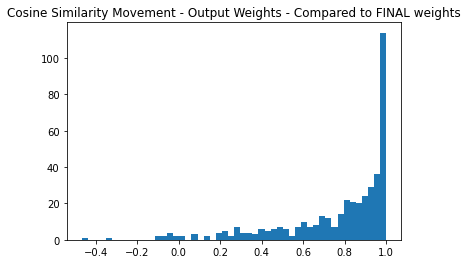

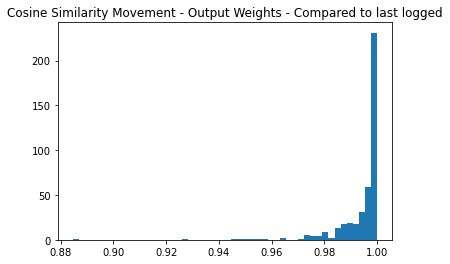

Epoch 1199
Data split 4


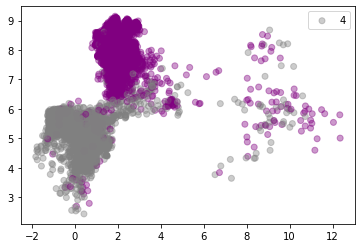

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=1199-step=94799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 8, % neurons most activated=0.09
Label 9, % neurons most activated=0.08


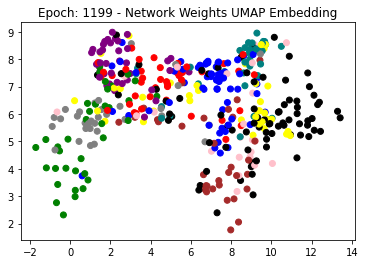

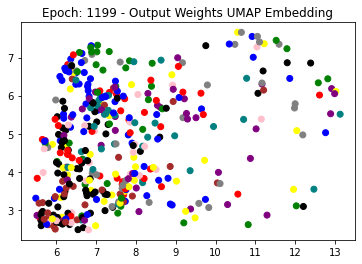

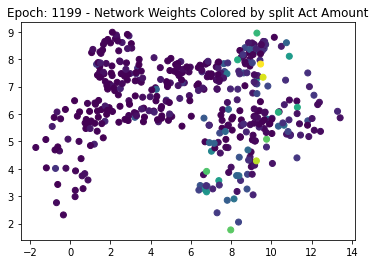

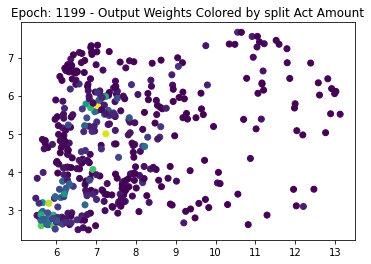

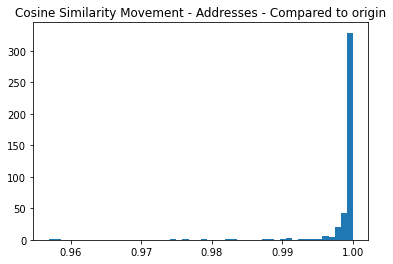

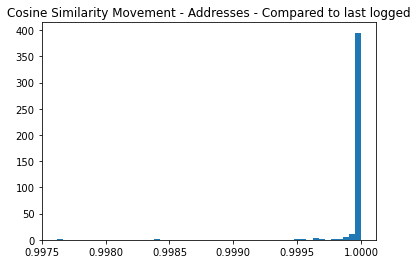

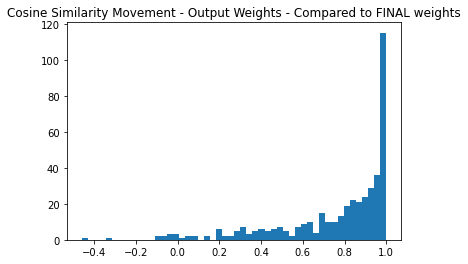

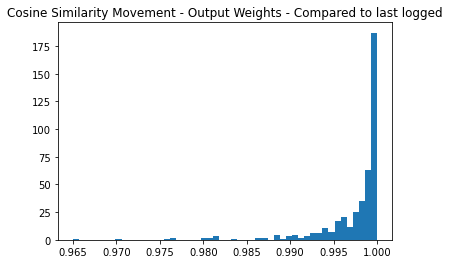

Epoch 1299
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=1299-step=102699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4240)
Label 8, % neurons most activated=0.1
Label 9, % neurons most activated=0.07


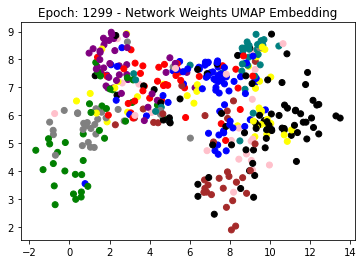

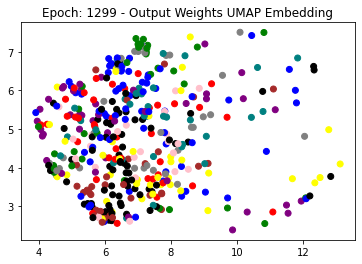

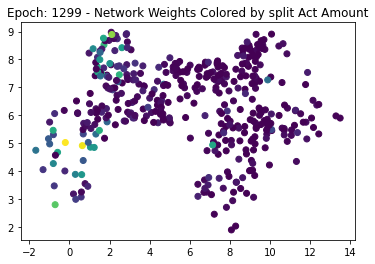

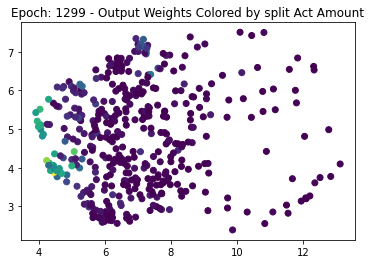

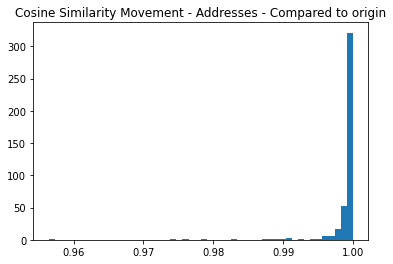

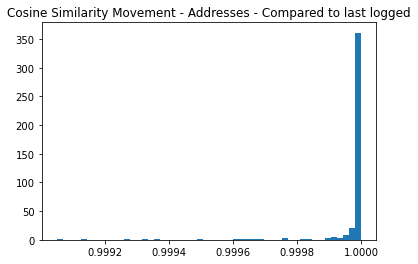

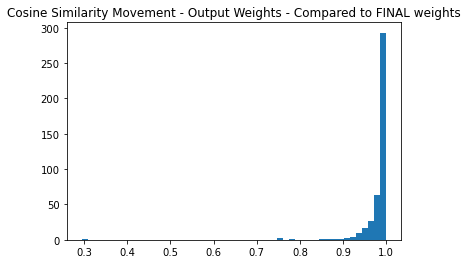

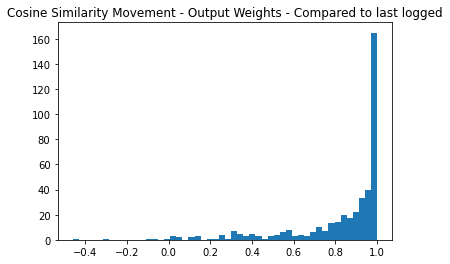

Epoch 1399
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=1399-step=110599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4230)
Label 8, % neurons most activated=0.1
Label 9, % neurons most activated=0.07


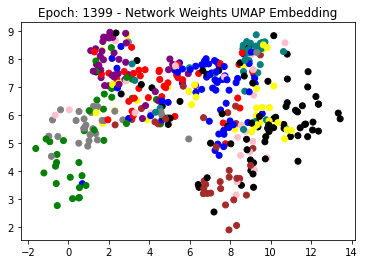

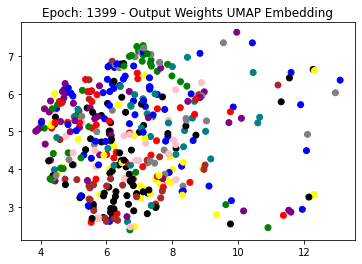

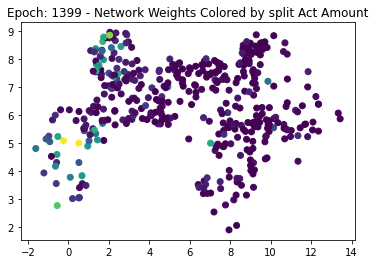

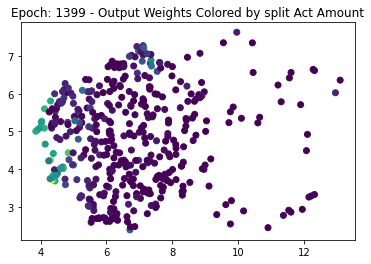

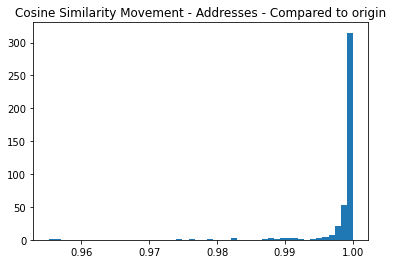

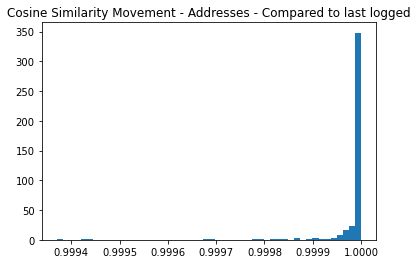

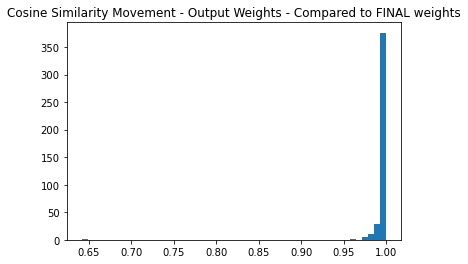

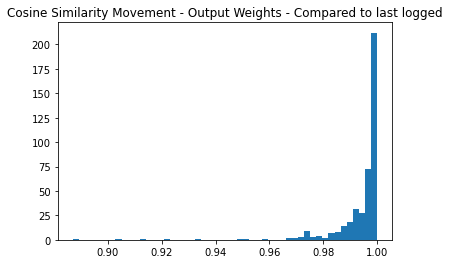

Epoch 1499
Data split 5


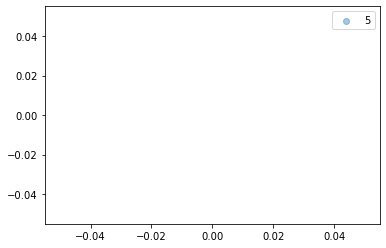

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/z0unvxvg/checkpoints/epoch=1499-step=118499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4220)


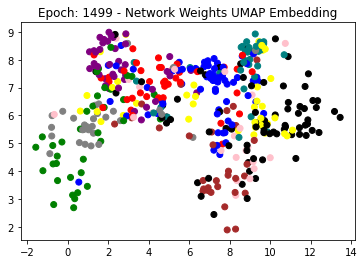

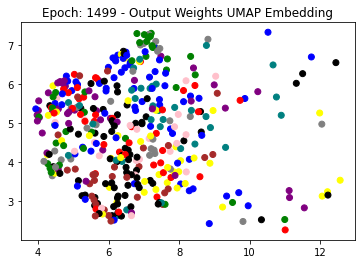

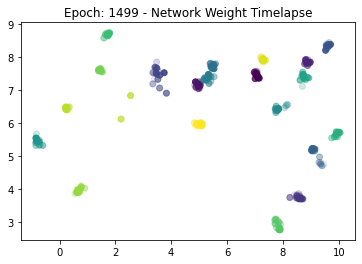

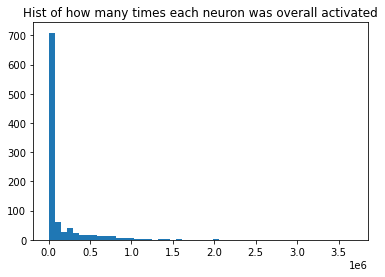

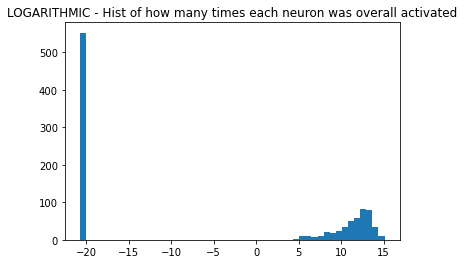

Run is: 3pdsnsk3
SDM_LinearDecayMask_Investigate_ContLearning <class 'models.SDM.SDM'>
data path ../data/ params namespace(act_func=ReLU(), act_string='ReLU()', active_threshold=0.0001, adamw_l2_loss_weight=0.001, adversarial_attack_norm=inf, adversarial_attacks=False, adversarial_max_distortion=0.03, alex_net_freeze_layer_swap=False, all_positive_weights=False, apply_cnn_layer=False, batch_size=128, can_enforce_positive_weights_on_bias_terms=True, check_val_every_n_epoch=1, checkpoint_every_n_epochs=100, classification=True, cnn_kern_size=4, cnn_model=False, cnn_nfilters=128, cnn_padding=0, cnn_relu=True, cnn_stride=None, continual_learning=True, count_dead_train_neurons=False, dataset=<DataSet.SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10: 27>, dataset_path_suffix='CachedOutputs/ConvMixerWTransforms_ImgNet32_CIFAR10/all_data_', dataset_str='SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10', device=device(type='cuda'), dropout_prob=0.0, early_stopping=False, enforce_ewc=F

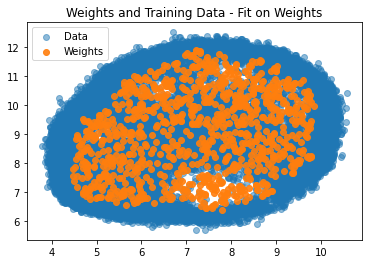

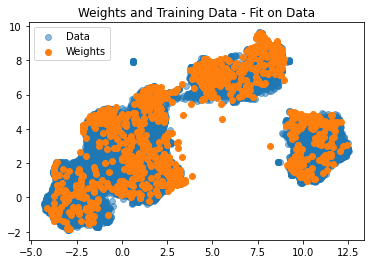

../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/SDM_LinearDecayMask_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks


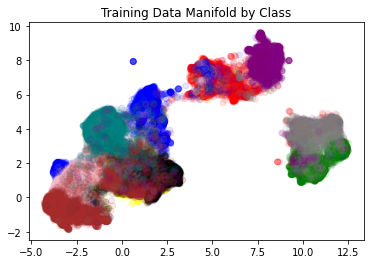

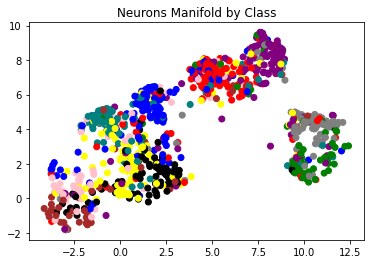

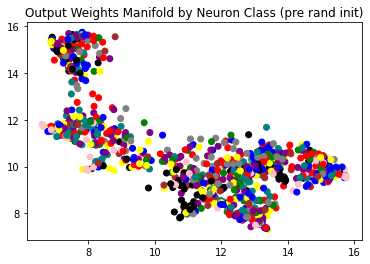

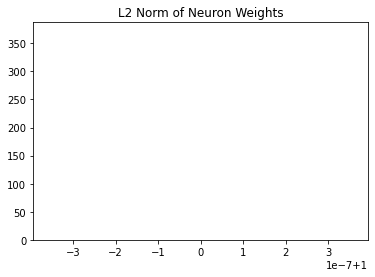

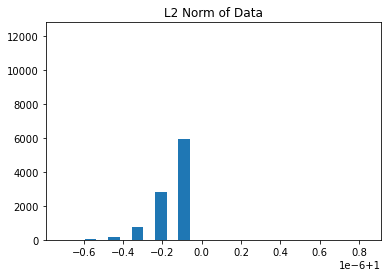

Perc alive neurons tensor(0.9640)


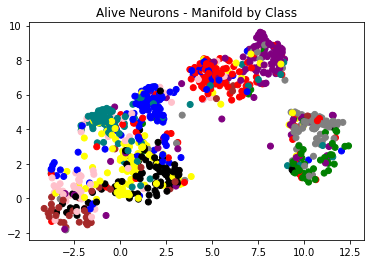

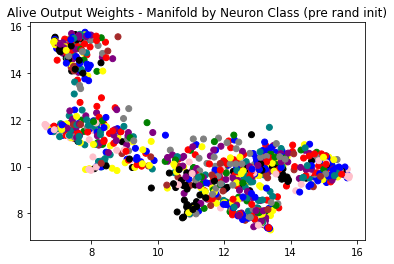

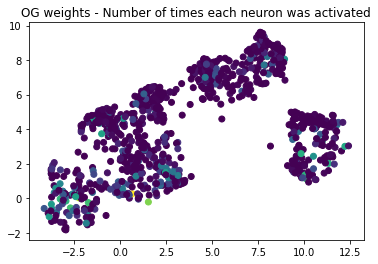

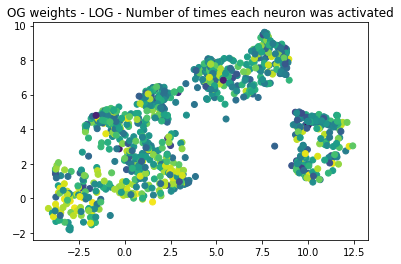

Epoch 0
Data split 0


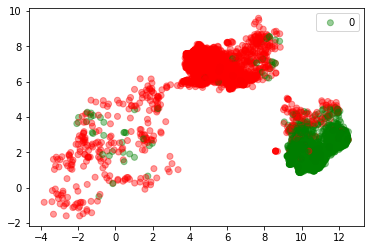

Trimming the output weights. model index is: 0
../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/SDM_LinearDecayMask_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks
Perc alive neurons tensor(0.7720)
Label 0, % neurons most activated=0.14
Label 1, % neurons most activated=0.06


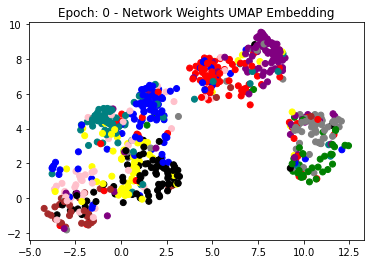

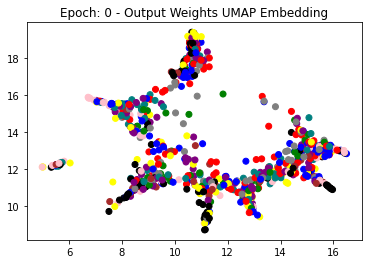

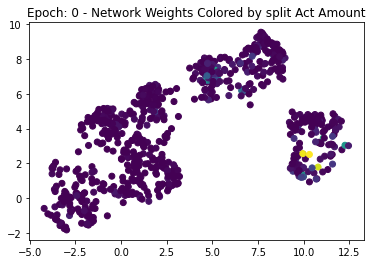

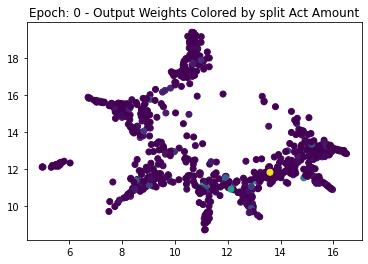

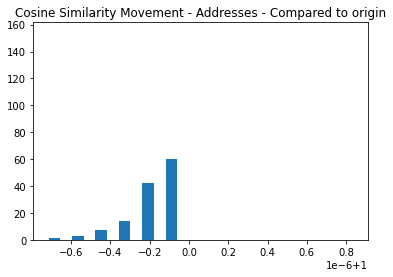

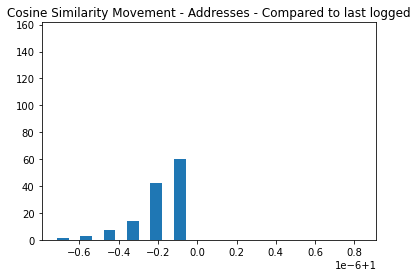

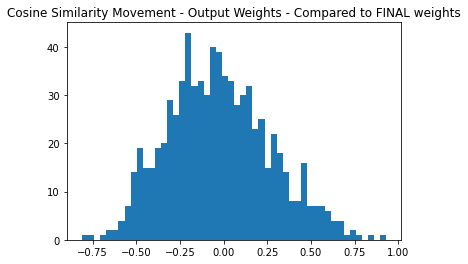

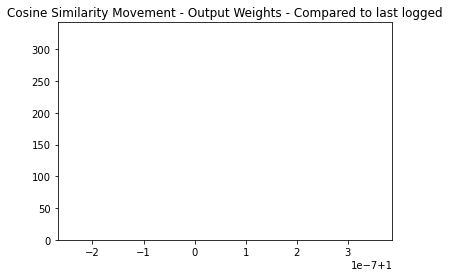

Epoch 99
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=99-step=7899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6260)
Label 0, % neurons most activated=0.15
Label 1, % neurons most activated=0.05


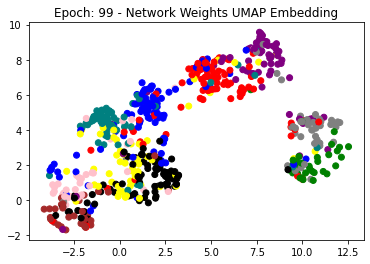

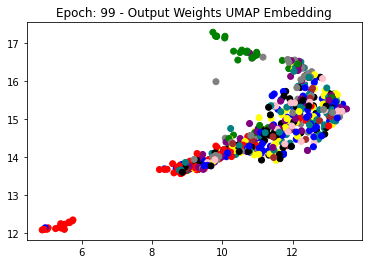

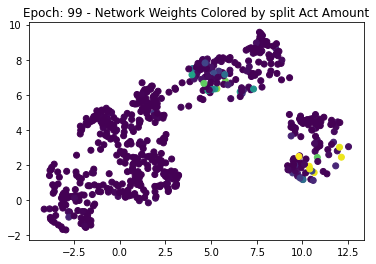

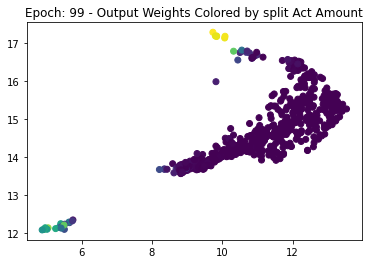

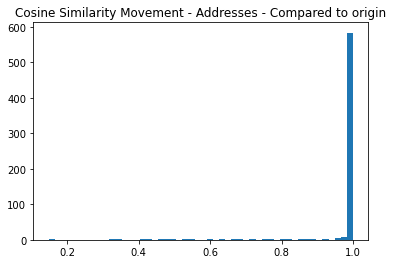

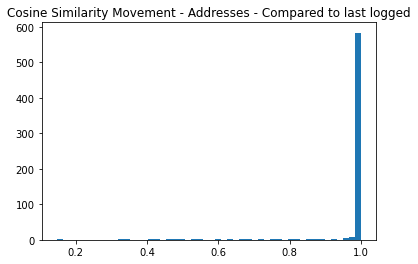

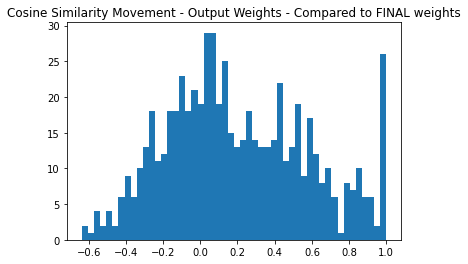

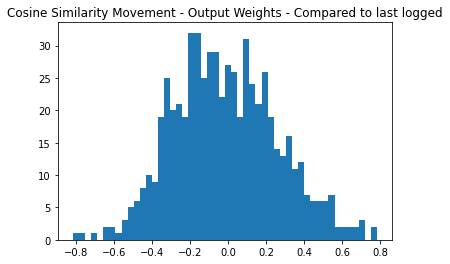

Epoch 199
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=199-step=15799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6120)
Label 0, % neurons most activated=0.15
Label 1, % neurons most activated=0.06


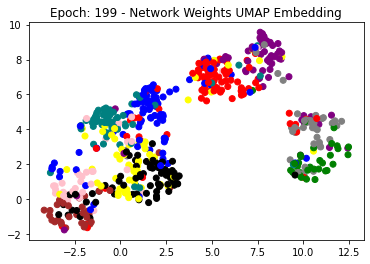

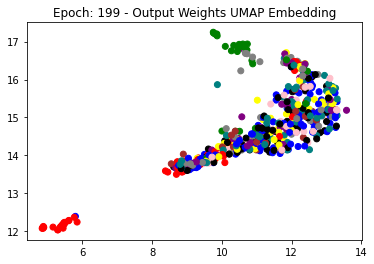

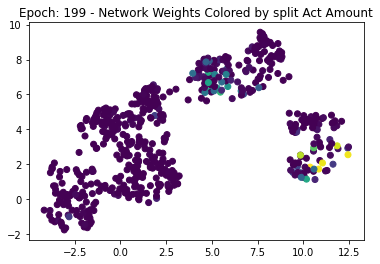

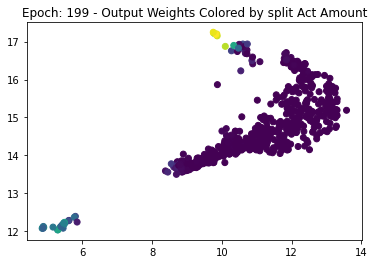

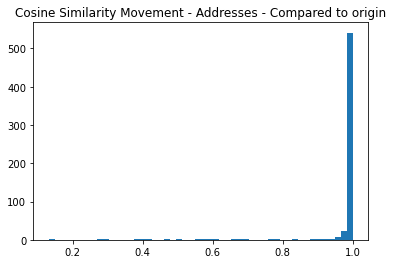

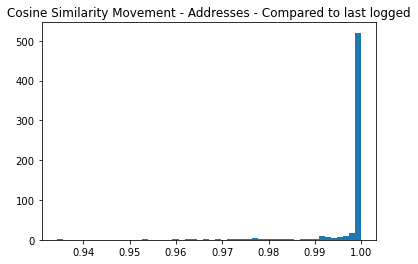

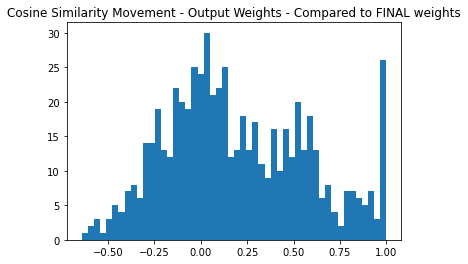

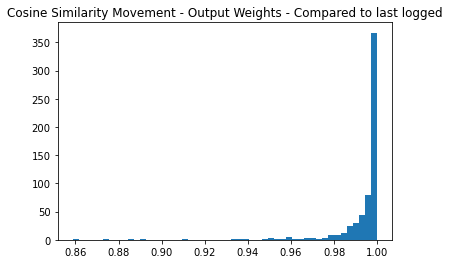

Epoch 299
Data split 1


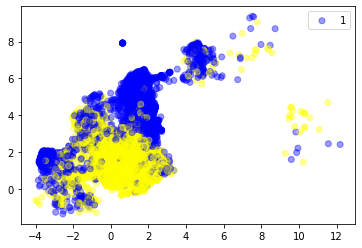

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=299-step=23699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6000)
Label 2, % neurons most activated=0.16
Label 3, % neurons most activated=0.1


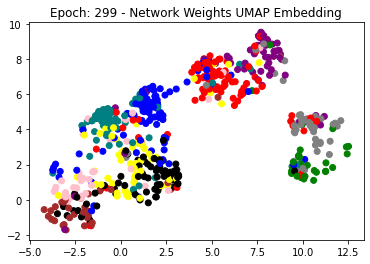

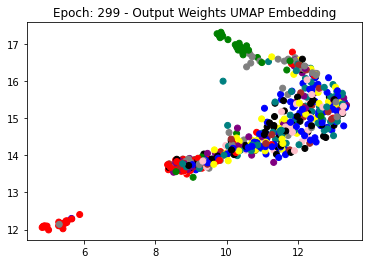

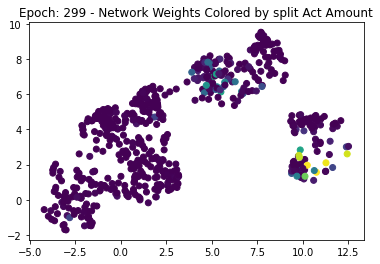

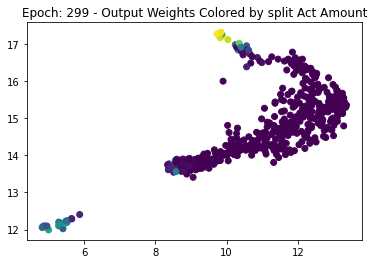

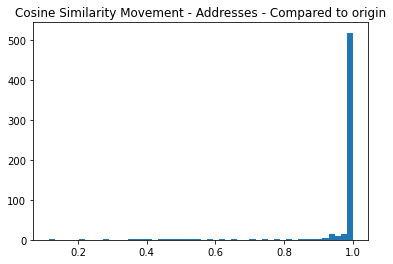

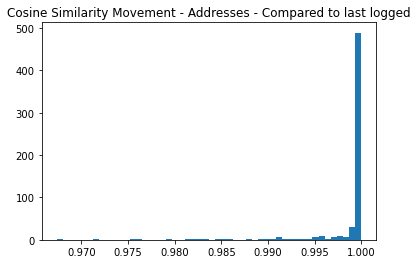

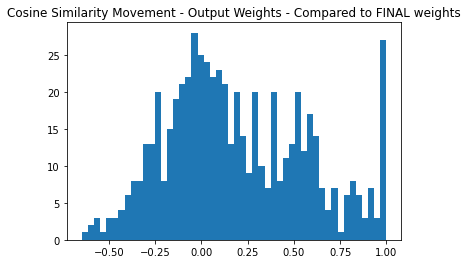

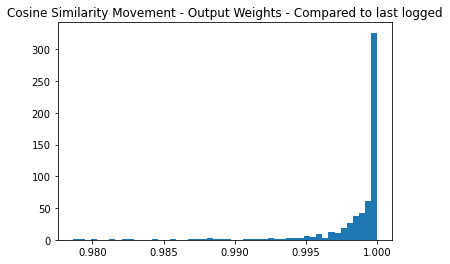

Epoch 399
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=399-step=31599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5460)
Label 2, % neurons most activated=0.15
Label 3, % neurons most activated=0.11


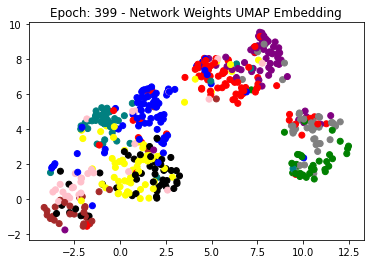

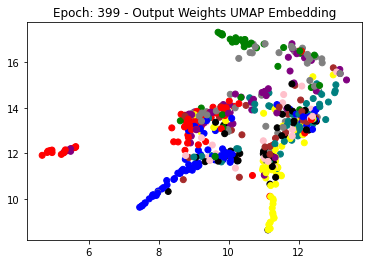

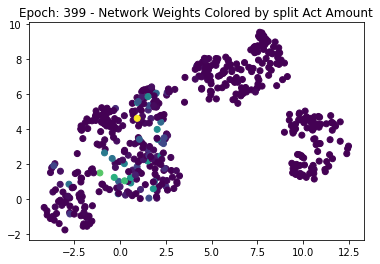

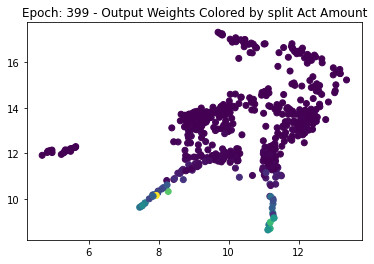

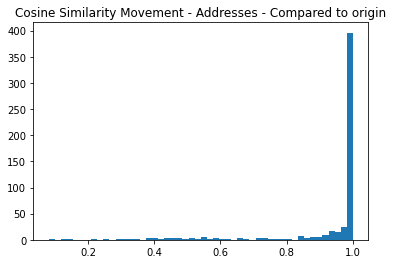

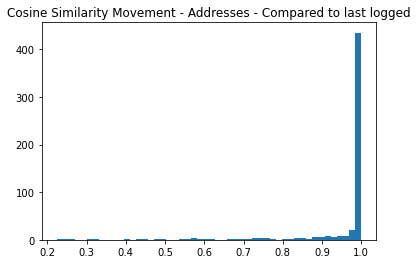

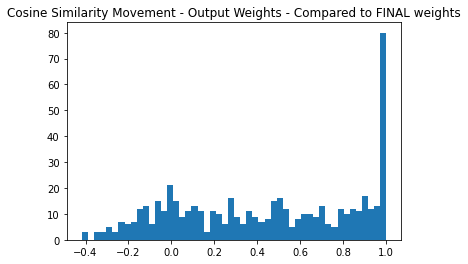

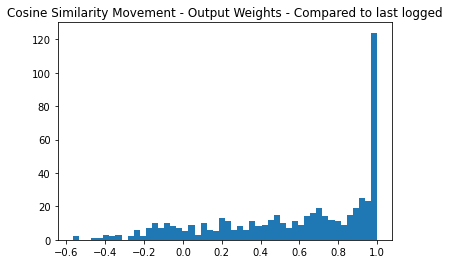

Epoch 499
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=499-step=39499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5380)
Label 2, % neurons most activated=0.17
Label 3, % neurons most activated=0.11


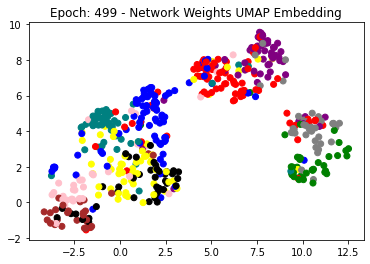

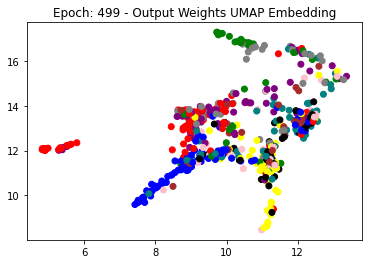

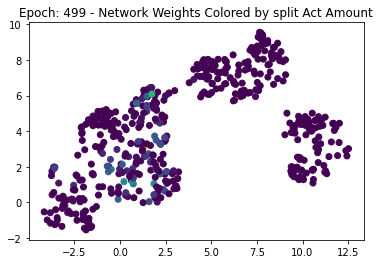

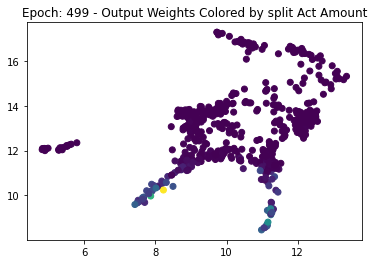

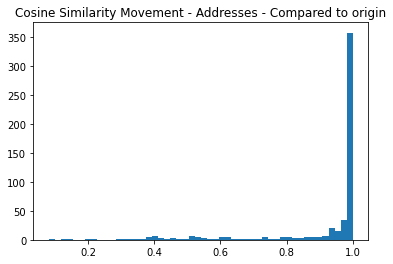

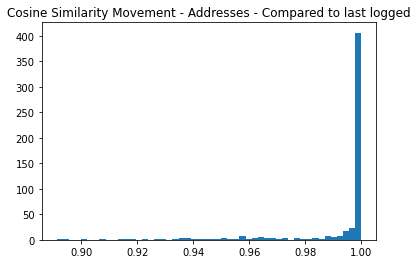

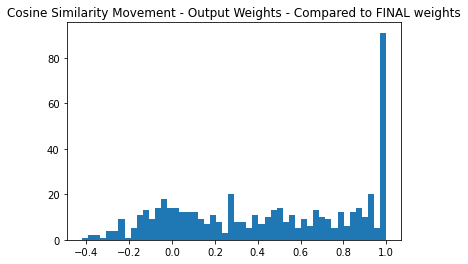

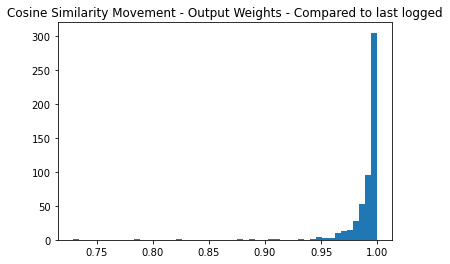

Epoch 599
Data split 2


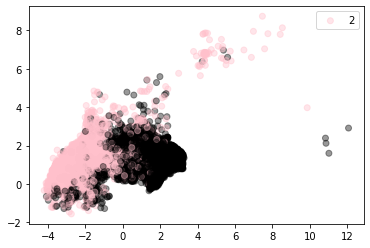

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=599-step=47399.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5330)
Label 4, % neurons most activated=0.06
Label 5, % neurons most activated=0.08


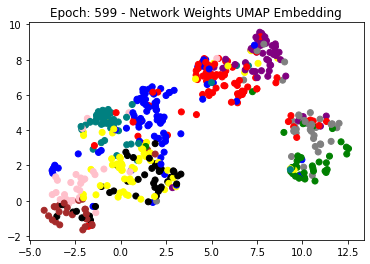

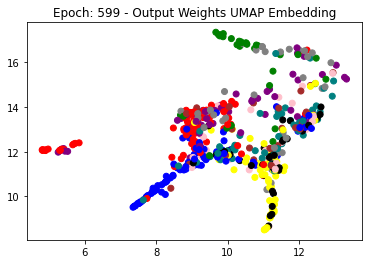

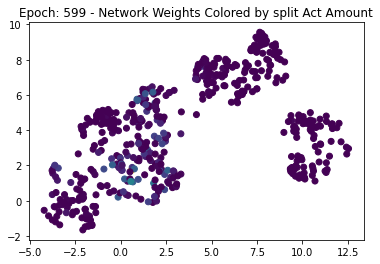

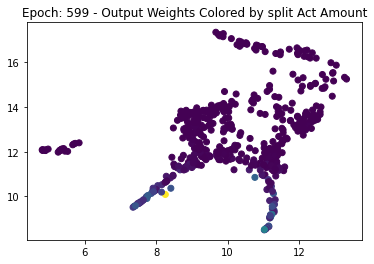

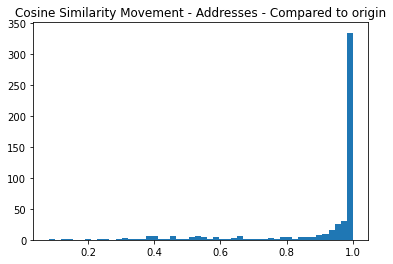

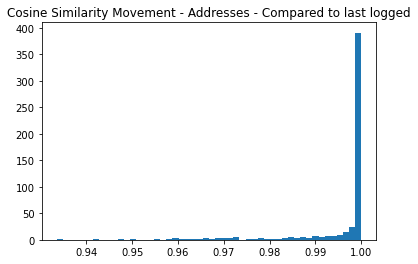

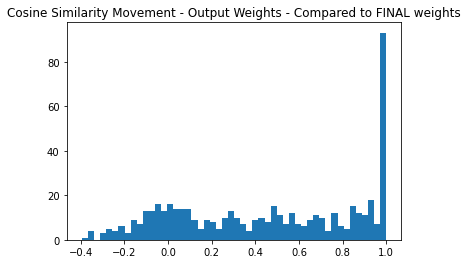

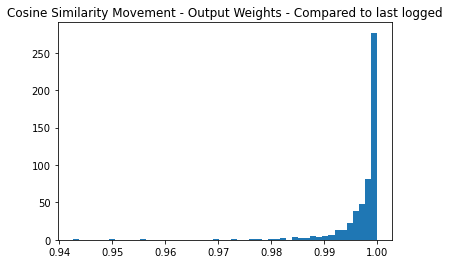

Epoch 699
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=699-step=55299.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5930)
Label 4, % neurons most activated=0.06
Label 5, % neurons most activated=0.07


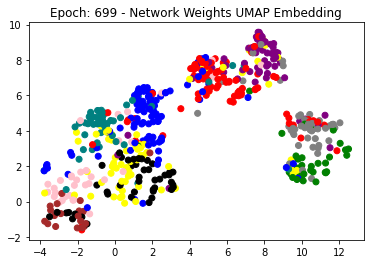

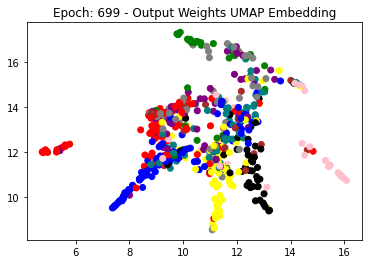

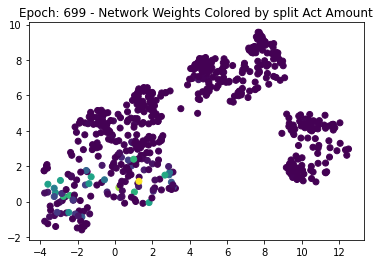

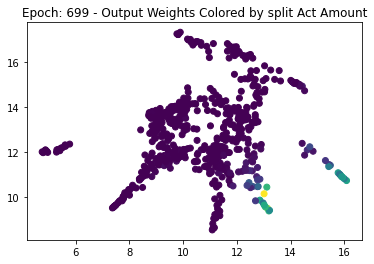

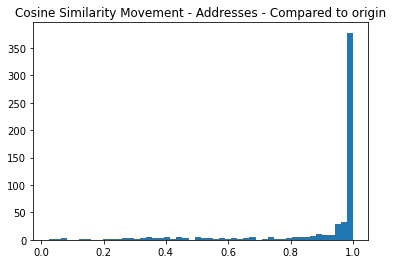

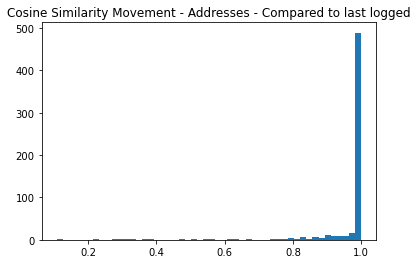

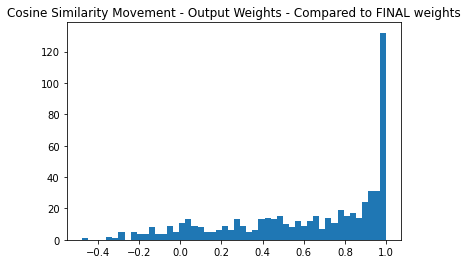

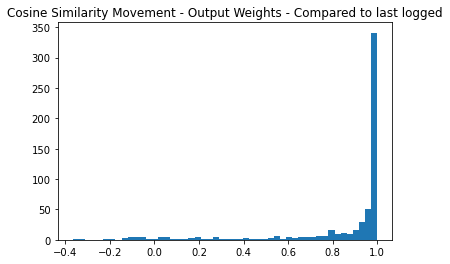

Epoch 799
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=799-step=63199.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5820)
Label 4, % neurons most activated=0.07
Label 5, % neurons most activated=0.08


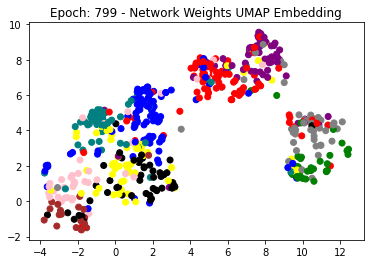

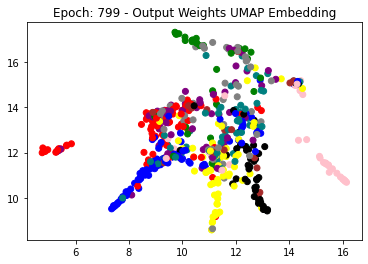

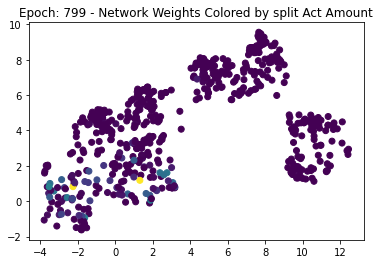

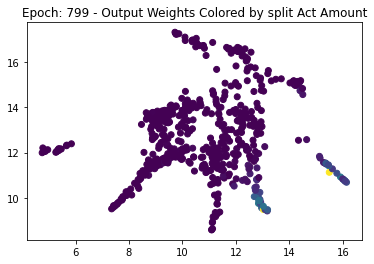

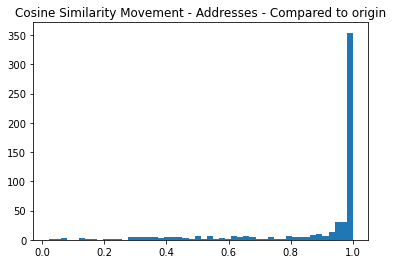

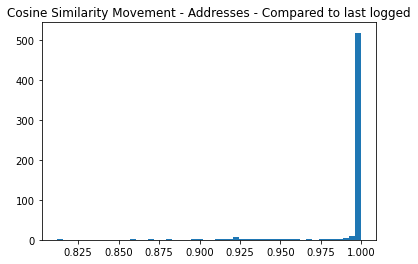

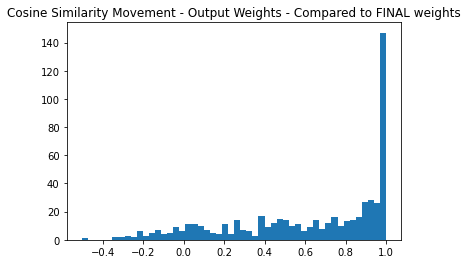

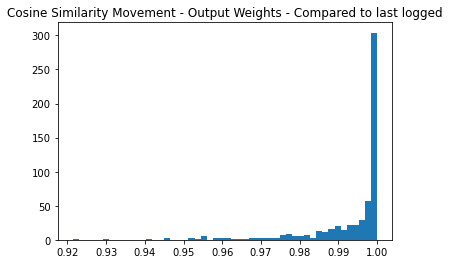

Epoch 899
Data split 3


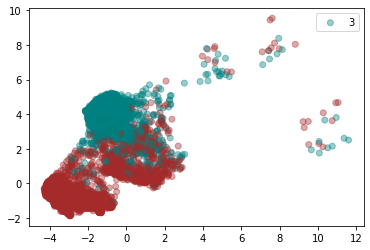

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=899-step=71099.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5820)
Label 6, % neurons most activated=0.1
Label 7, % neurons most activated=0.04


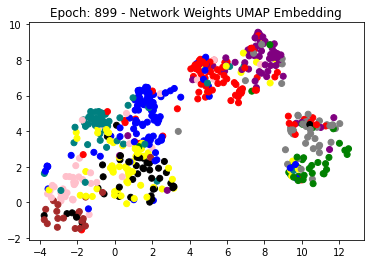

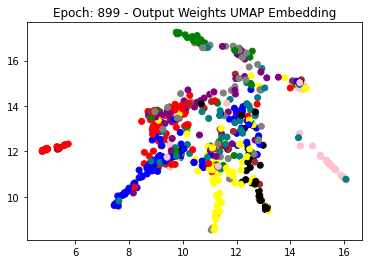

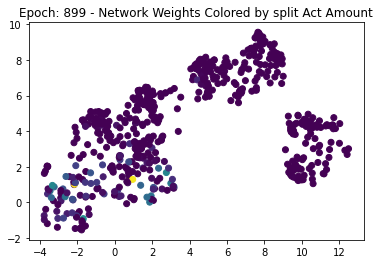

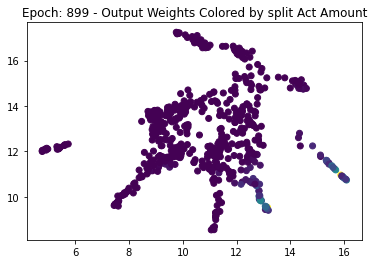

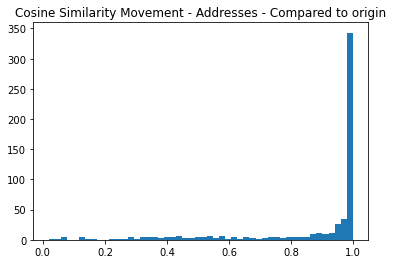

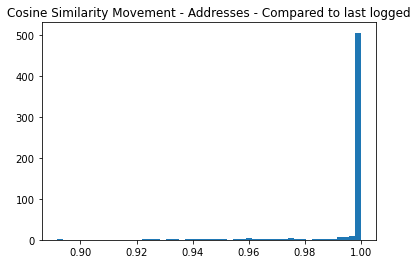

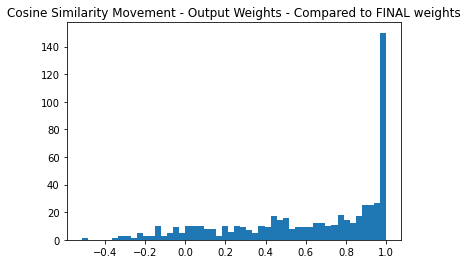

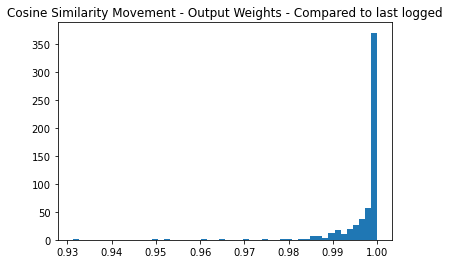

Epoch 999
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=999-step=78999.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6190)
Label 6, % neurons most activated=0.1
Label 7, % neurons most activated=0.04


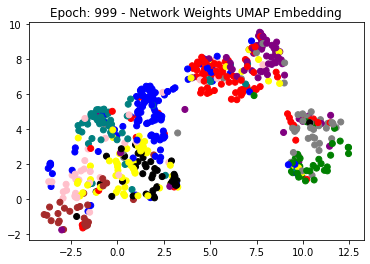

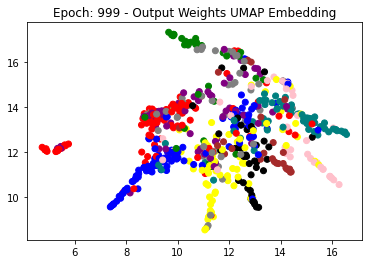

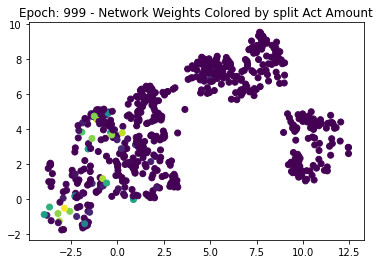

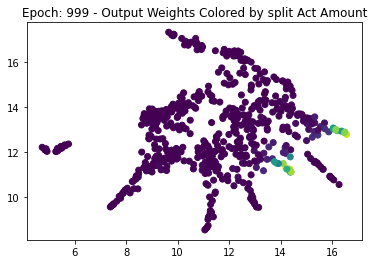

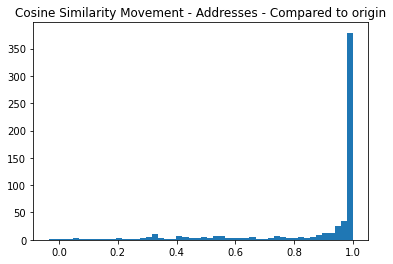

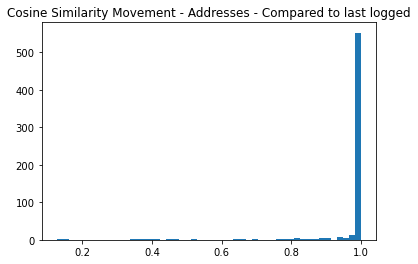

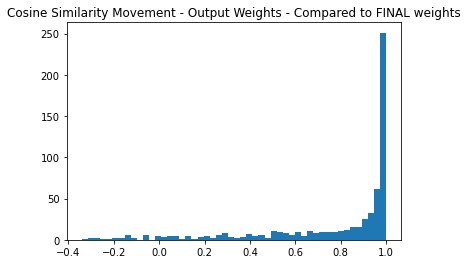

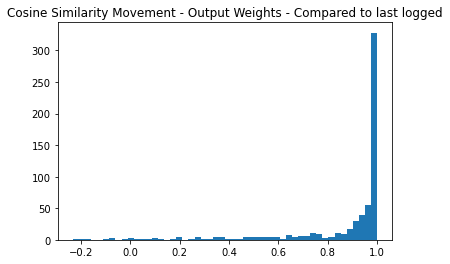

Epoch 1099
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=1099-step=86899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6060)
Label 6, % neurons most activated=0.1
Label 7, % neurons most activated=0.04


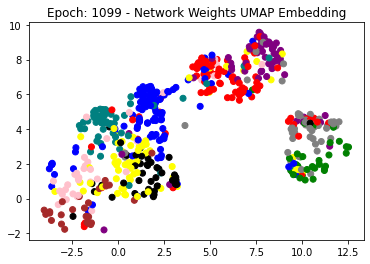

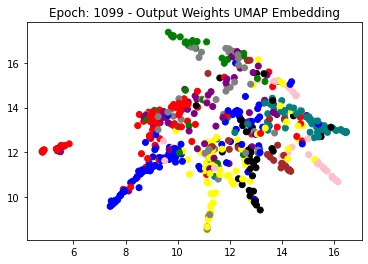

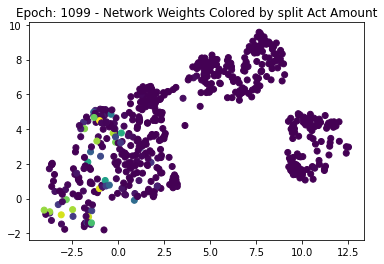

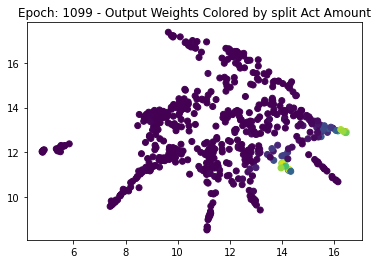

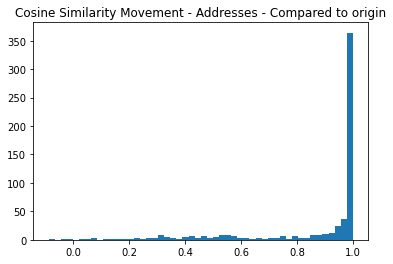

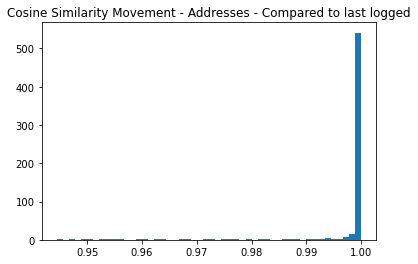

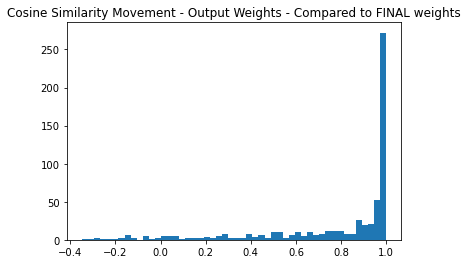

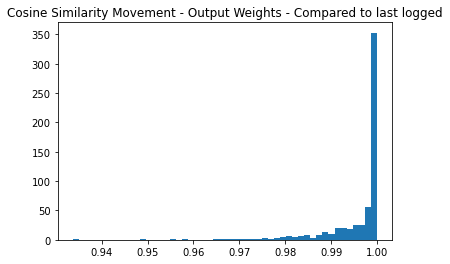

Epoch 1199
Data split 4


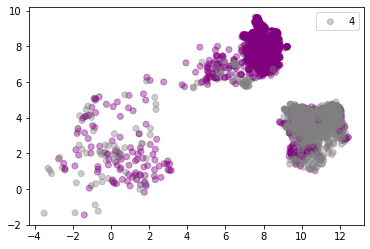

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=1199-step=94799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5910)
Label 8, % neurons most activated=0.11
Label 9, % neurons most activated=0.09


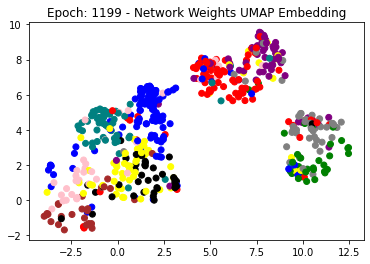

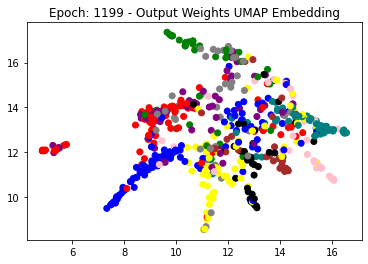

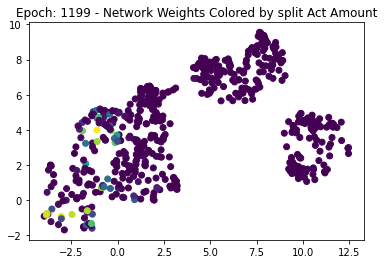

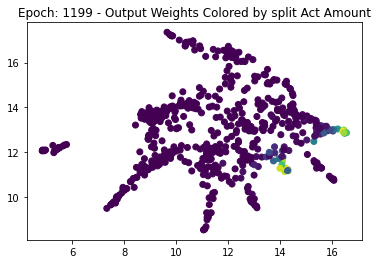

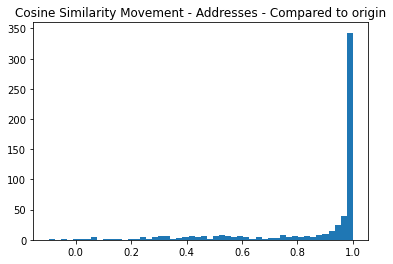

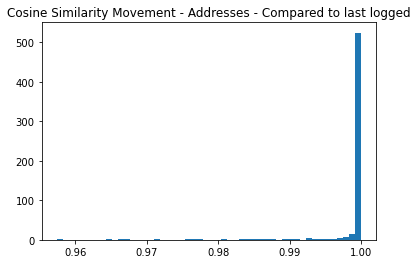

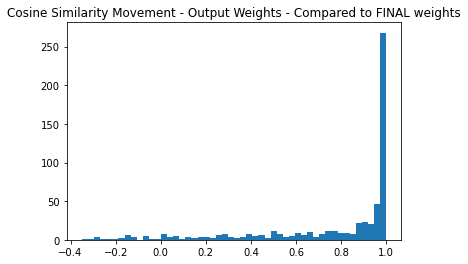

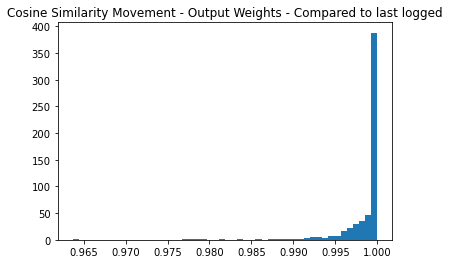

Epoch 1299
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=1299-step=102699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6240)
Label 8, % neurons most activated=0.1
Label 9, % neurons most activated=0.08


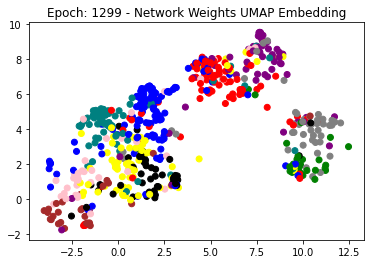

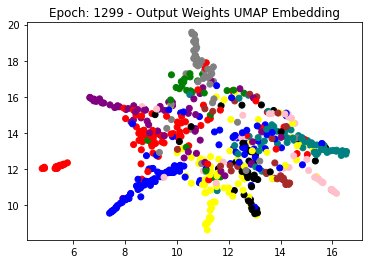

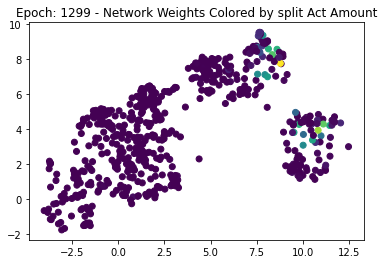

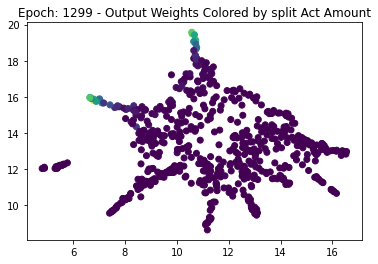

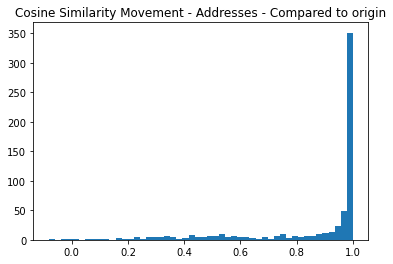

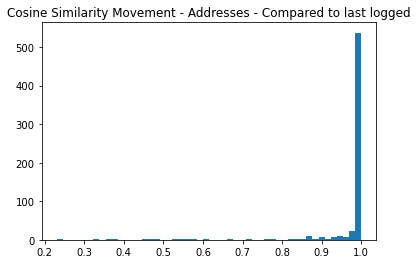

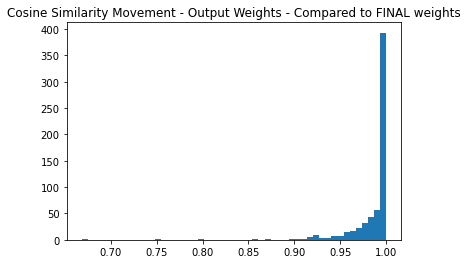

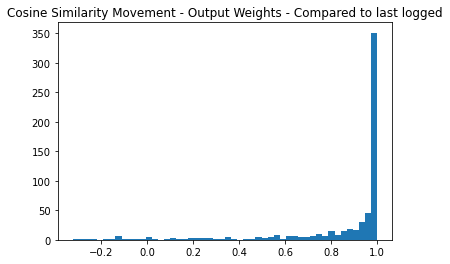

Epoch 1399
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=1399-step=110599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6100)
Label 8, % neurons most activated=0.1
Label 9, % neurons most activated=0.08


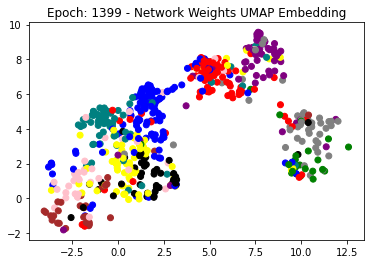

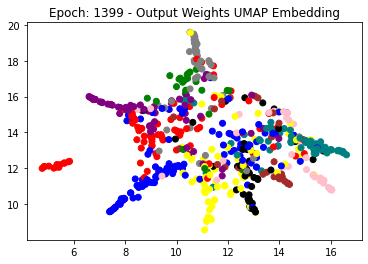

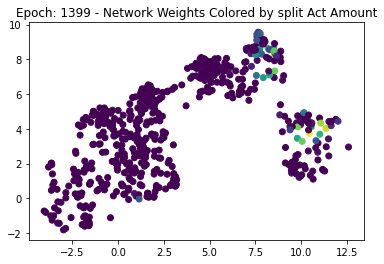

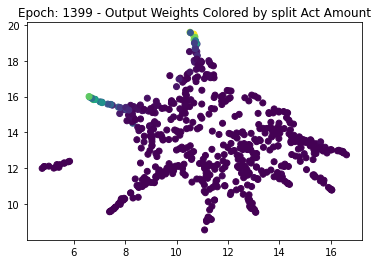

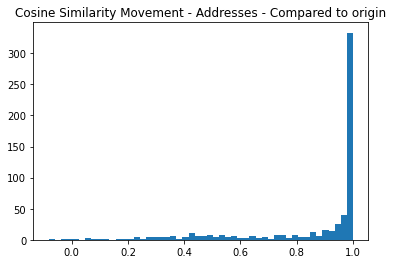

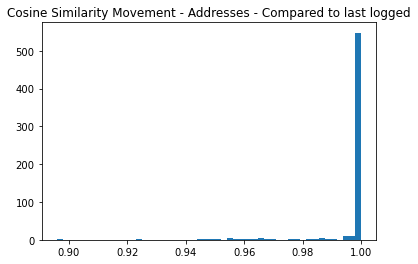

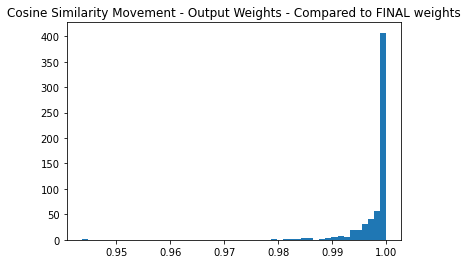

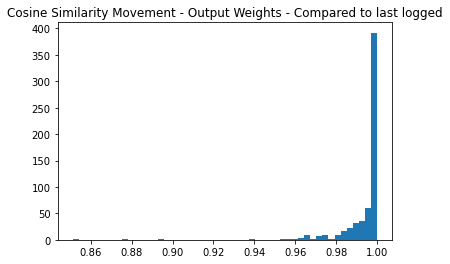

Epoch 1499
Data split 5


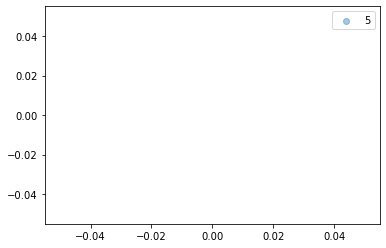

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/3pdsnsk3/checkpoints/epoch=1499-step=118499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.6020)


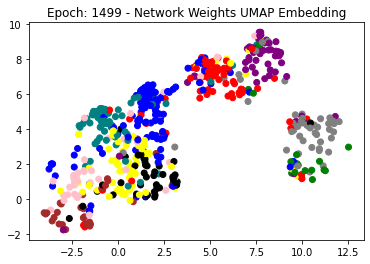

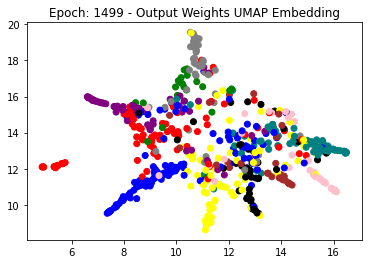

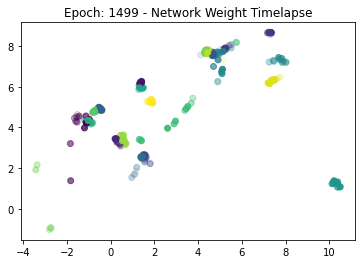

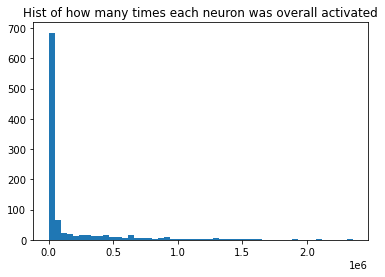

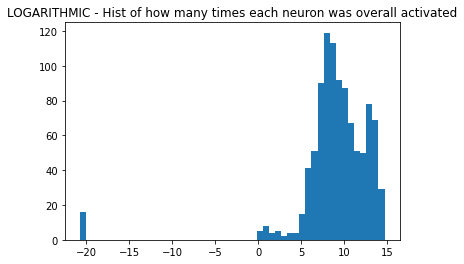

Run is: 20runydu
ReLU_SGD_Investigate_ContLearning <class 'models.CLASSIC_FFN.CLASSIC_FFN'>
data path ../data/ params namespace(act_func=ReLU(), act_string='ReLU()', active_threshold=0.0001, adamw_l2_loss_weight=0.001, adversarial_attack_norm=inf, adversarial_attacks=False, adversarial_max_distortion=0.03, alex_net_freeze_layer_swap=False, all_positive_weights=False, batch_size=128, can_enforce_positive_weights_on_bias_terms=True, check_val_every_n_epoch=1, checkpoint_every_n_epochs=100, classification=True, cnn_model=False, continual_learning=True, dataset=<DataSet.SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10: 27>, dataset_path_suffix='CachedOutputs/ConvMixerWTransforms_ImgNet32_CIFAR10/all_data_', dataset_str='SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10', device=device(type='cuda'), dropout_prob=0.0, early_stopping=False, enforce_ewc=False, epoch_relative_to_training_restart=False, epochs_per_dataset=300, epochs_to_train_for=1500, ewc_beta=0.005, ewc_importance=200

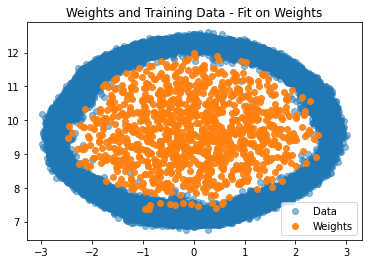

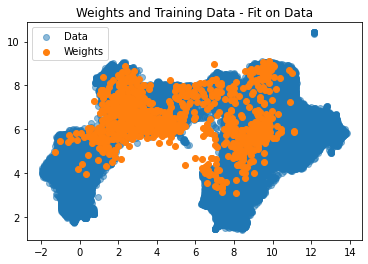

../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/ReLU_SGD_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks


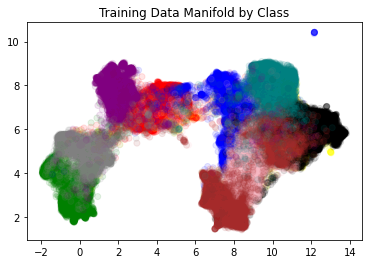

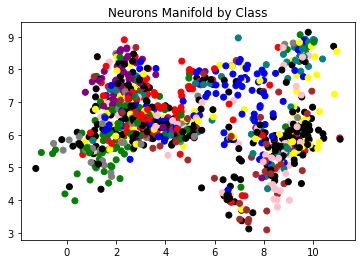

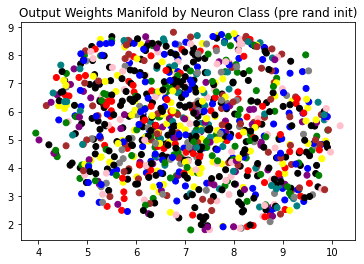

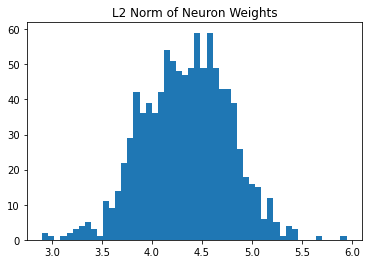

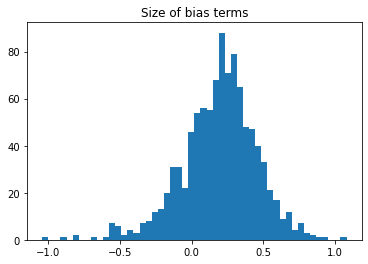

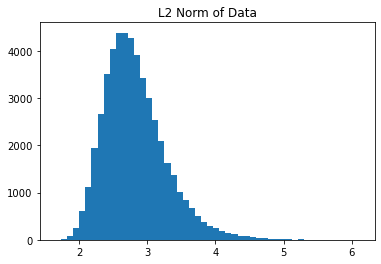

Perc alive neurons tensor(1.)


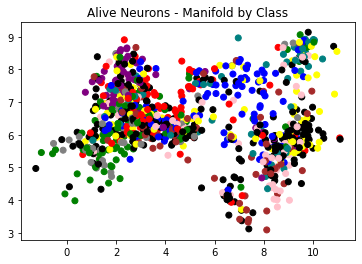

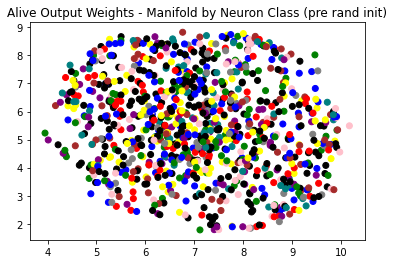

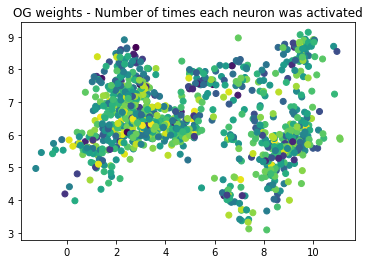

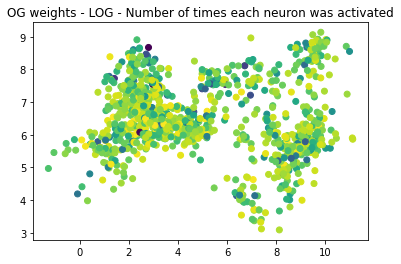

Epoch 0
Data split 0


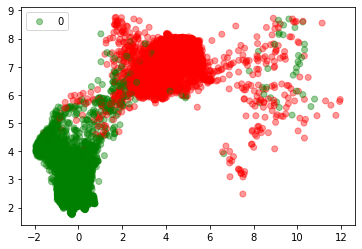

Trimming the output weights. model index is: 0
../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/ReLU_SGD_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks
Perc alive neurons tensor(1.)
Label 0, % neurons most activated=0.09
Label 1, % neurons most activated=0.1


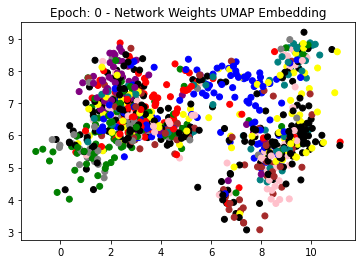

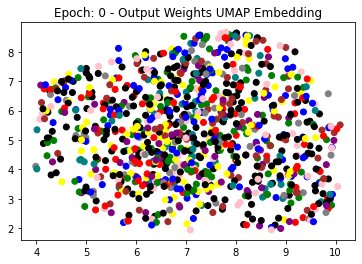

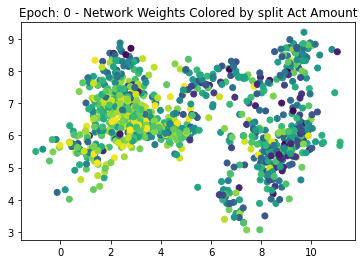

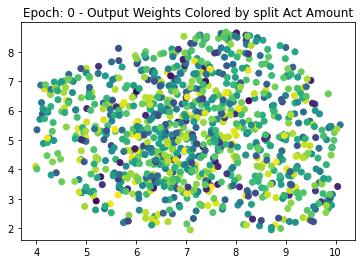

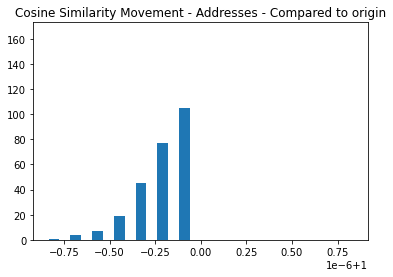

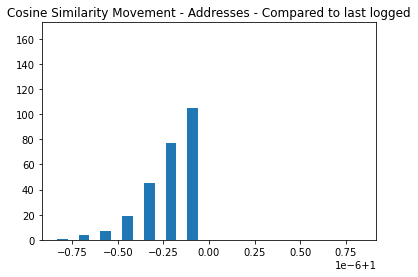

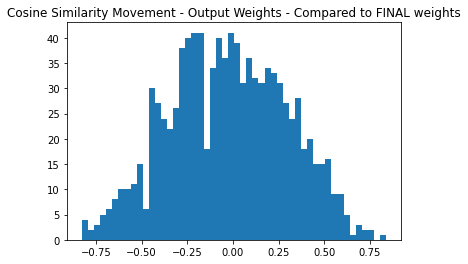

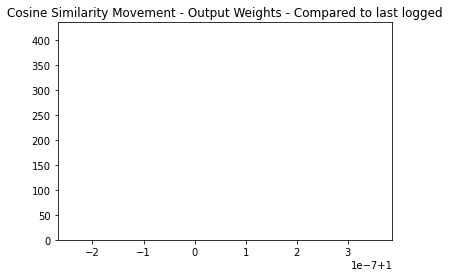

Epoch 99
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=99-step=7899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 0, % neurons most activated=0.09
Label 1, % neurons most activated=0.1


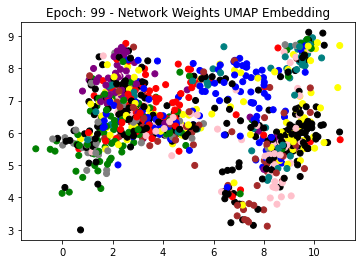

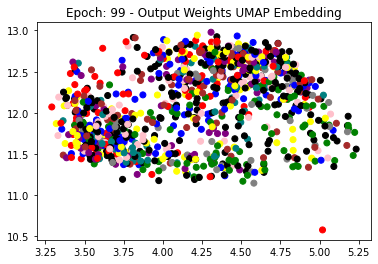

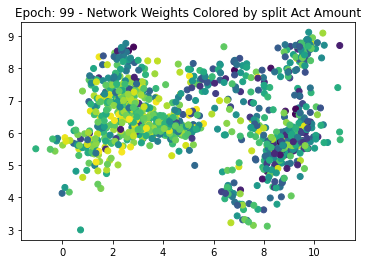

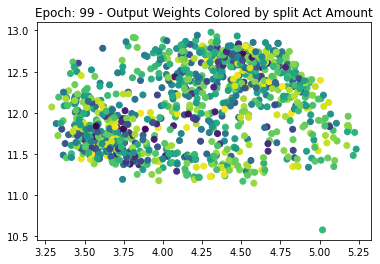

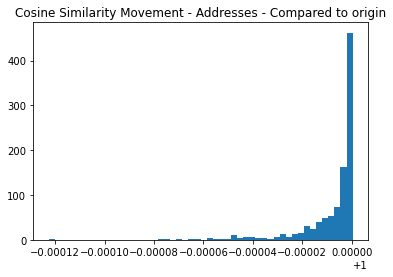

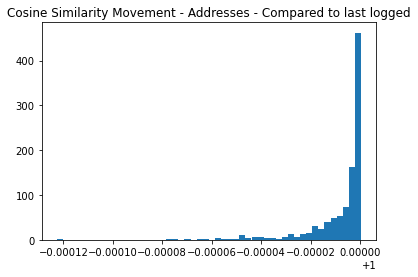

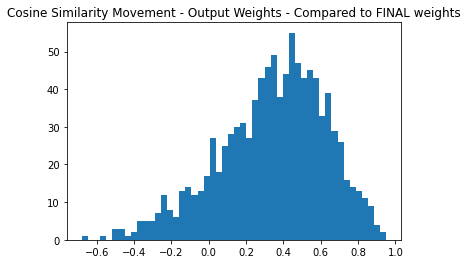

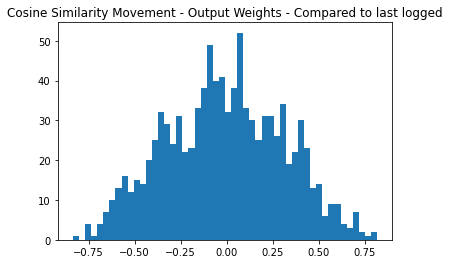

Epoch 199
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=199-step=15799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 0, % neurons most activated=0.09
Label 1, % neurons most activated=0.1


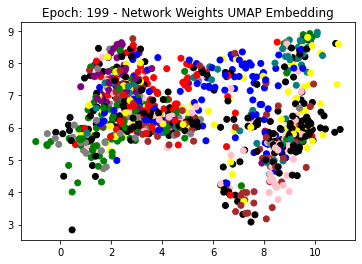

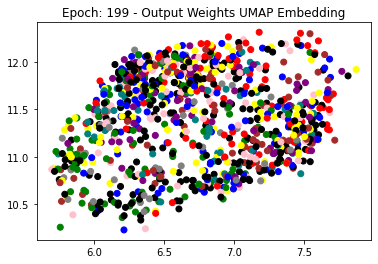

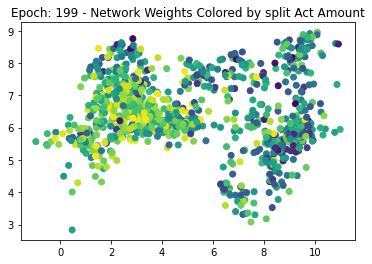

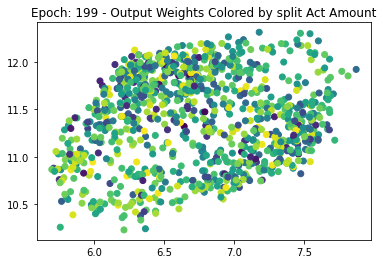

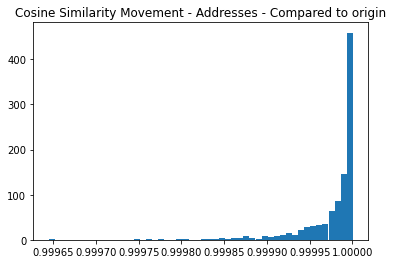

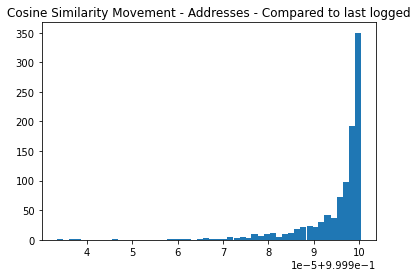

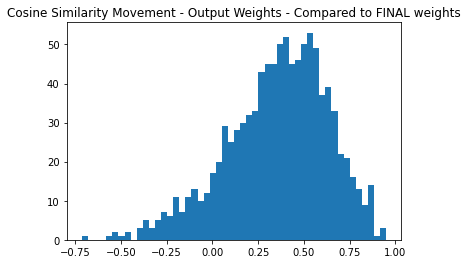

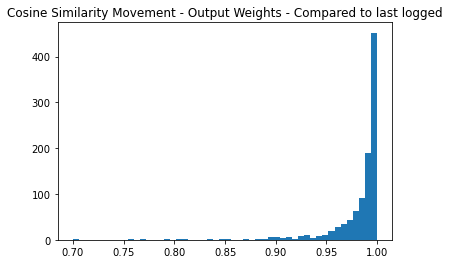

Epoch 299
Data split 1


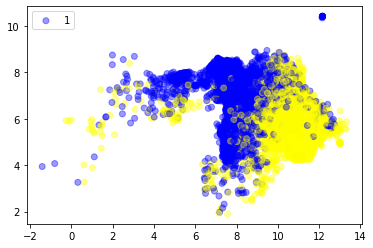

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=299-step=23699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 2, % neurons most activated=0.12
Label 3, % neurons most activated=0.1


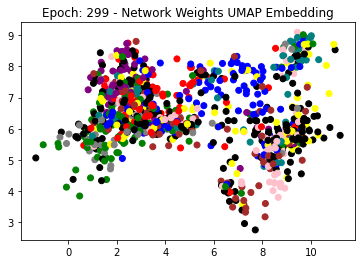

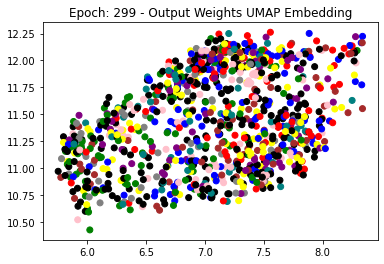

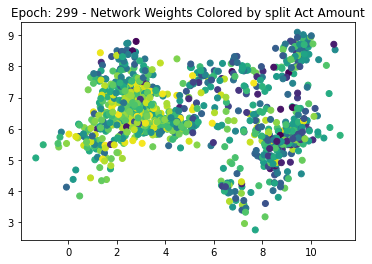

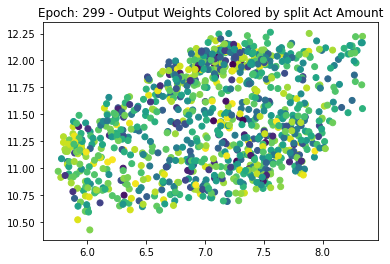

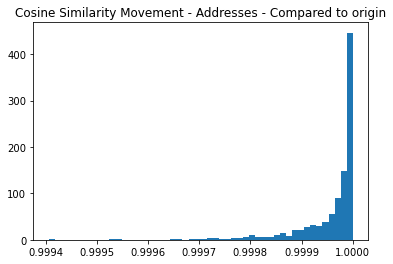

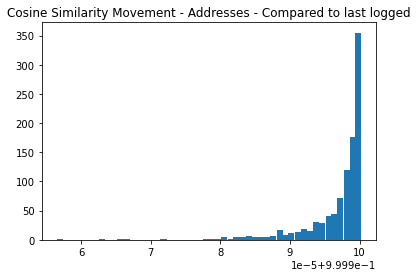

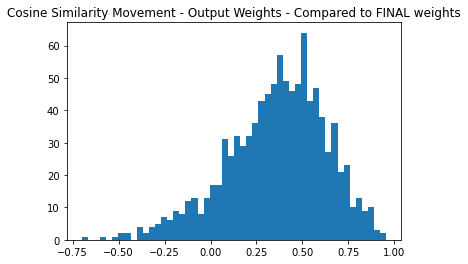

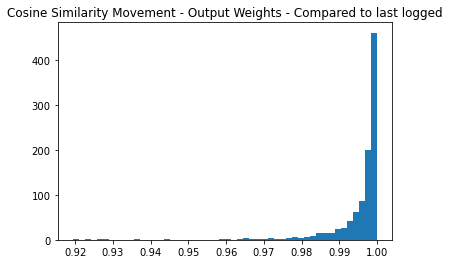

Epoch 399
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=399-step=31599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 2, % neurons most activated=0.12
Label 3, % neurons most activated=0.1


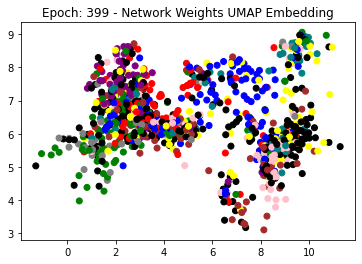

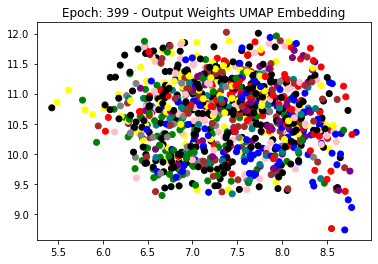

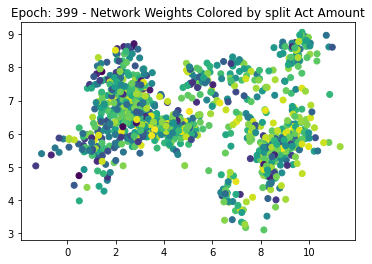

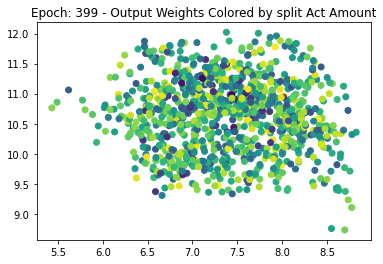

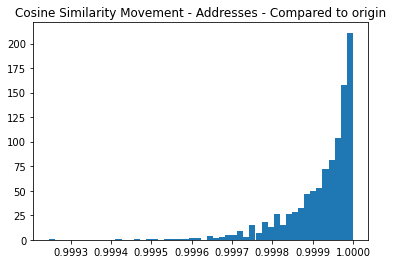

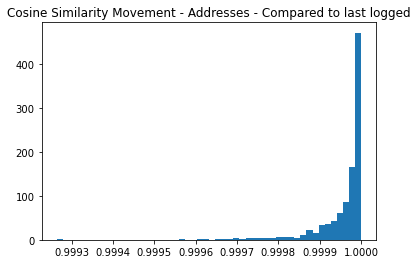

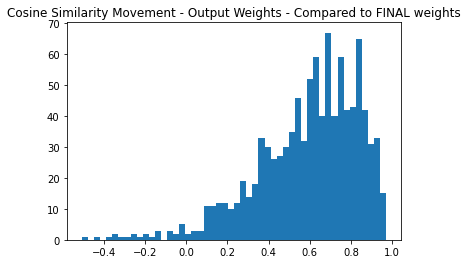

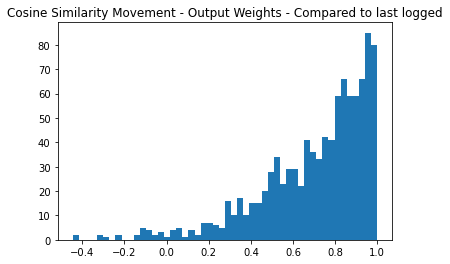

Epoch 499
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=499-step=39499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 2, % neurons most activated=0.12
Label 3, % neurons most activated=0.1


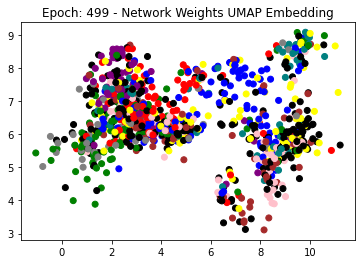

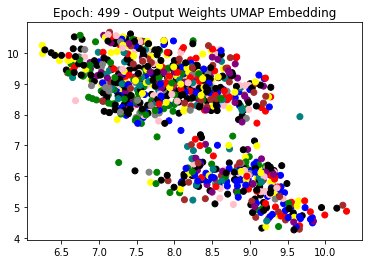

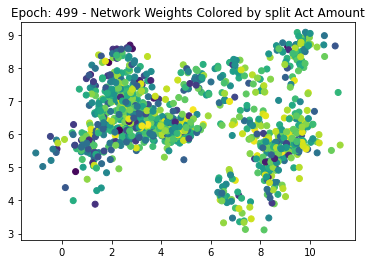

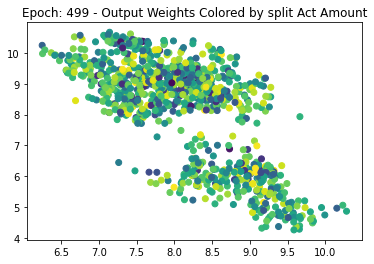

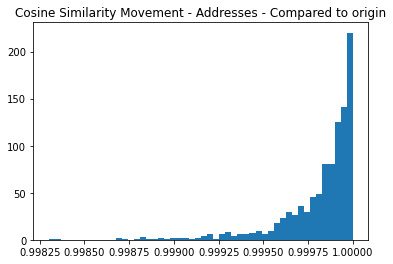

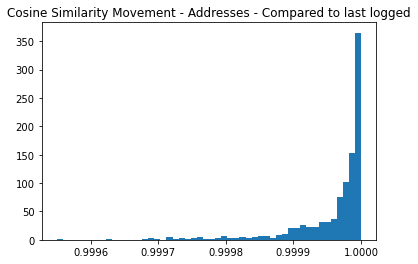

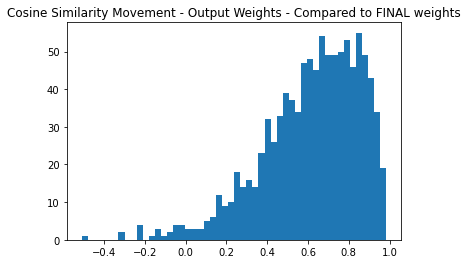

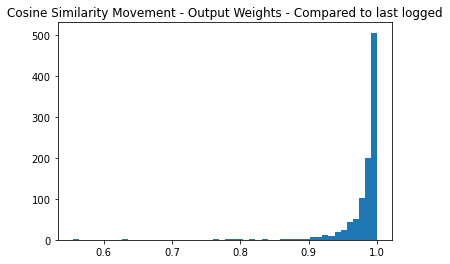

Epoch 599
Data split 2


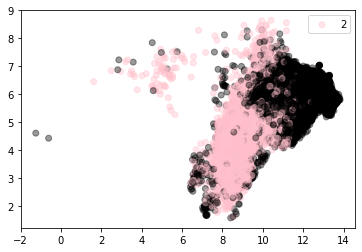

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=599-step=47399.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 4, % neurons most activated=0.07
Label 5, % neurons most activated=0.26


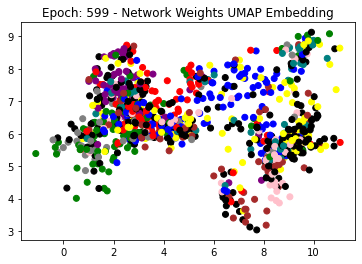

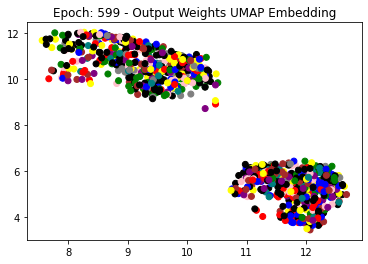

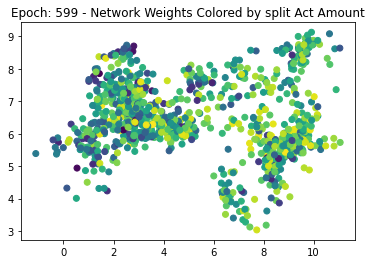

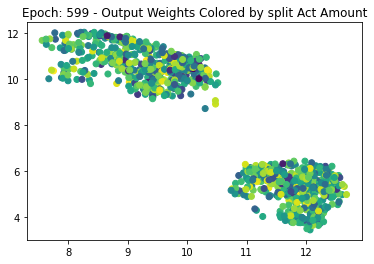

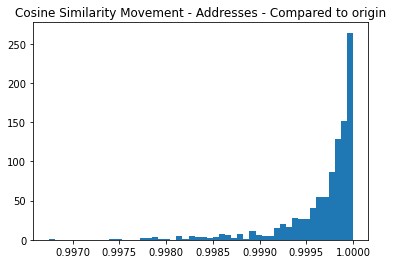

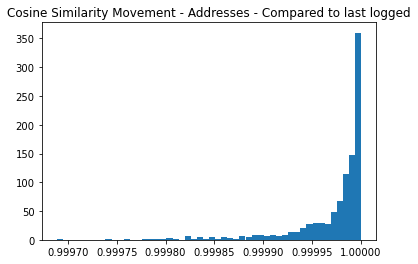

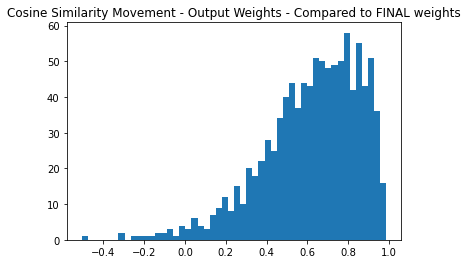

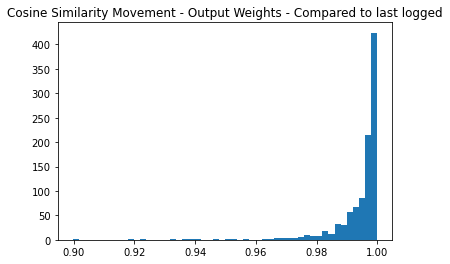

Epoch 699
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=699-step=55299.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 4, % neurons most activated=0.07
Label 5, % neurons most activated=0.26


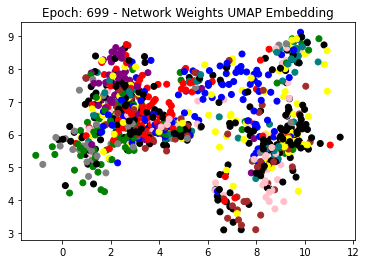

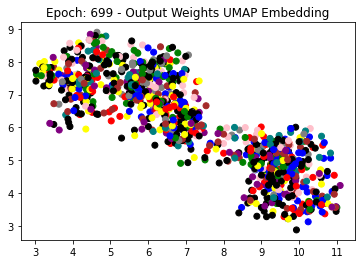

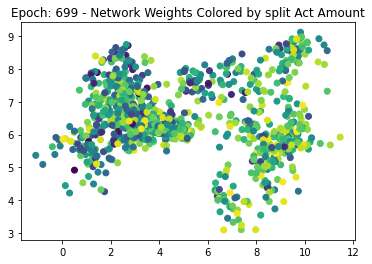

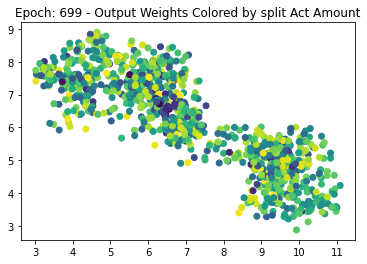

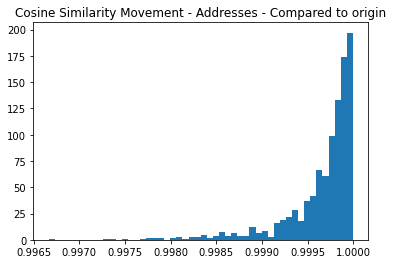

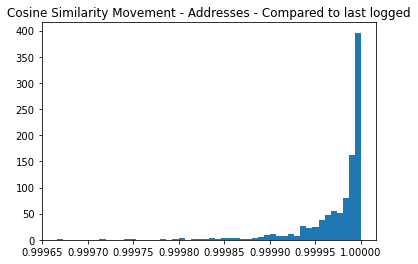

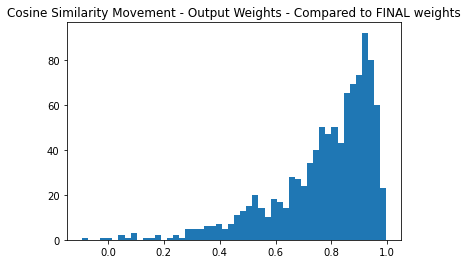

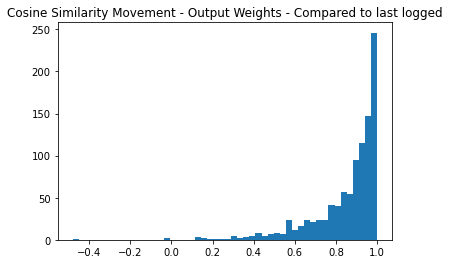

Epoch 799
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=799-step=63199.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 4, % neurons most activated=0.07
Label 5, % neurons most activated=0.26


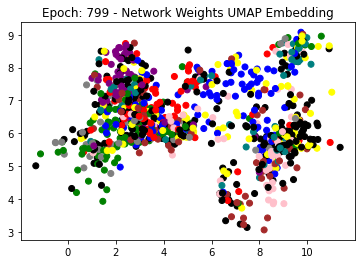

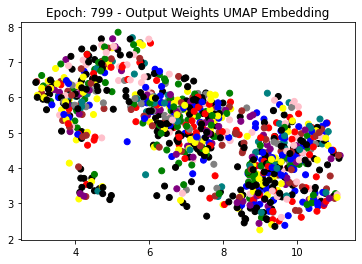

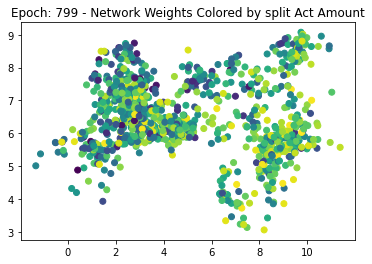

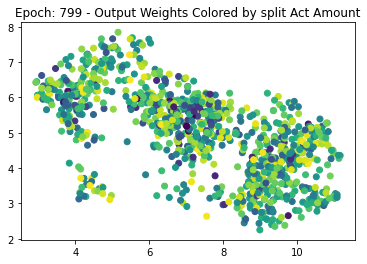

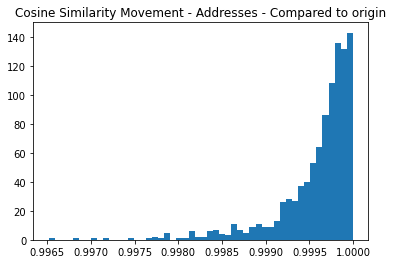

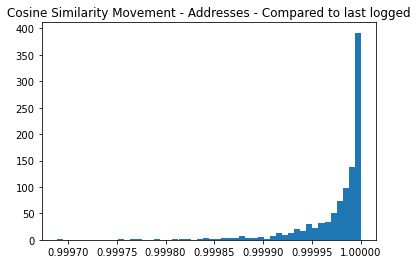

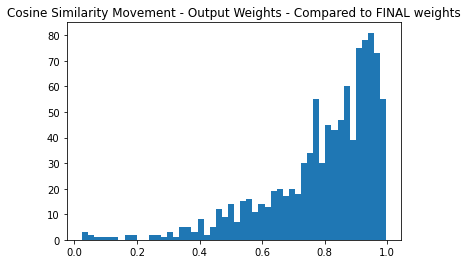

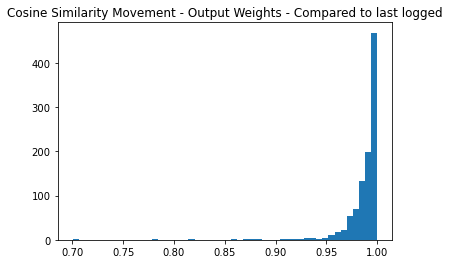

Epoch 899
Data split 3


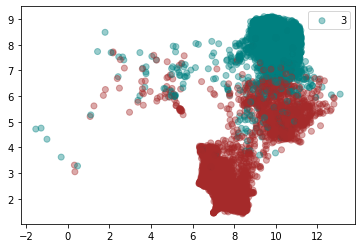

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=899-step=71099.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 6, % neurons most activated=0.06
Label 7, % neurons most activated=0.08


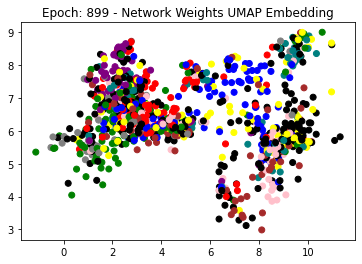

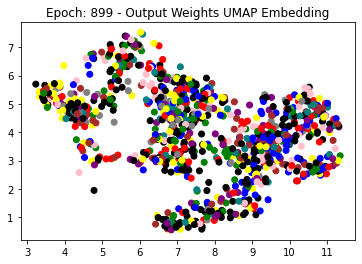

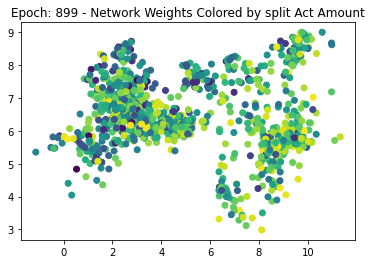

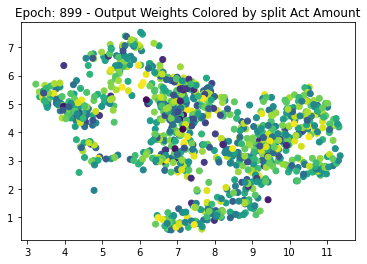

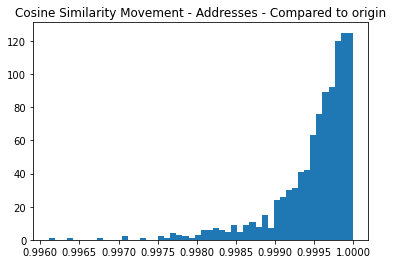

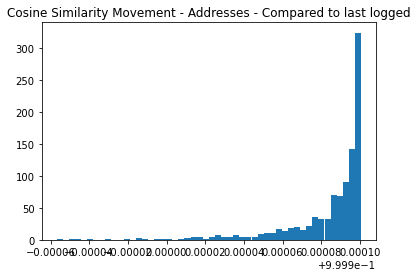

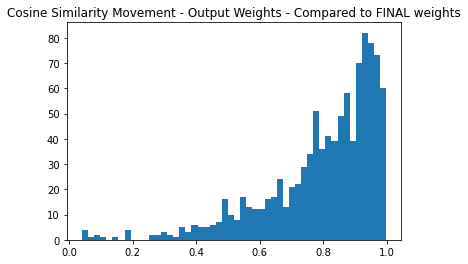

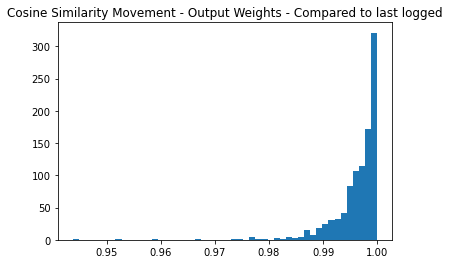

Epoch 999
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=999-step=78999.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 6, % neurons most activated=0.06
Label 7, % neurons most activated=0.08


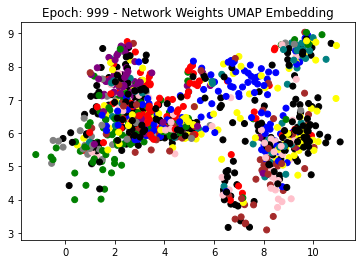

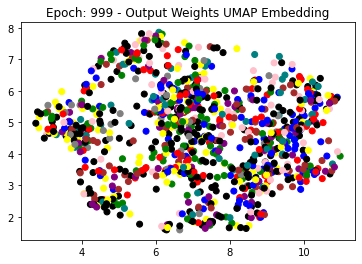

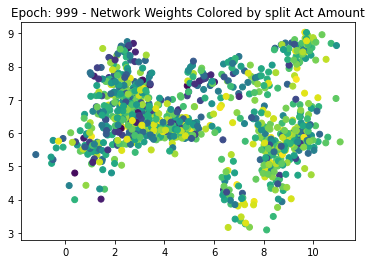

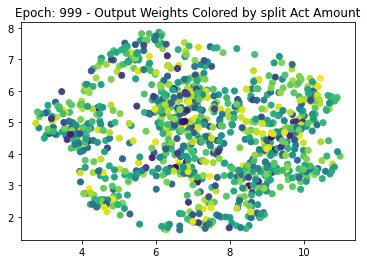

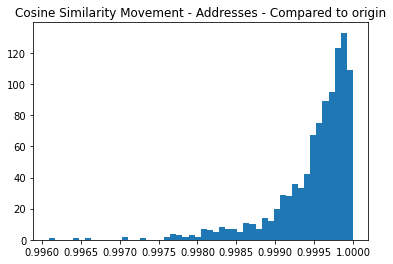

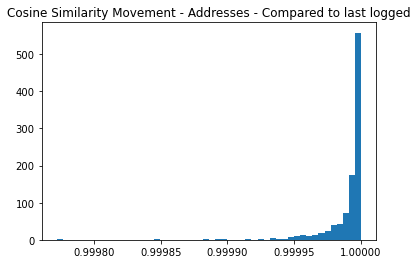

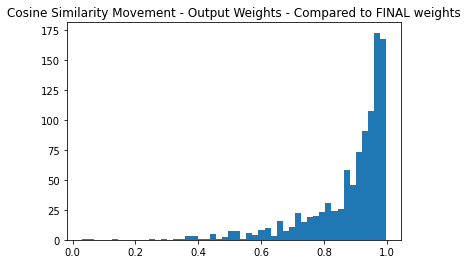

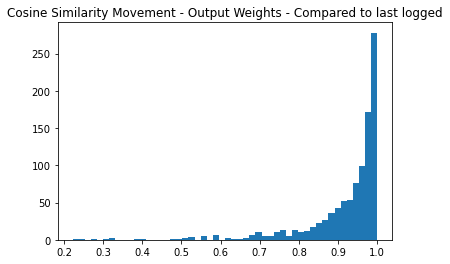

Epoch 1099
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=1099-step=86899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 6, % neurons most activated=0.06
Label 7, % neurons most activated=0.08


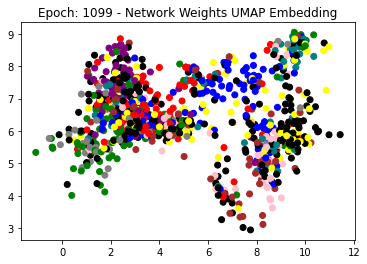

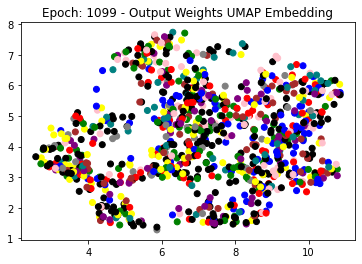

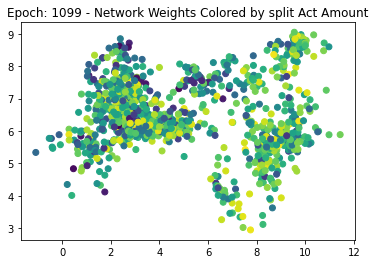

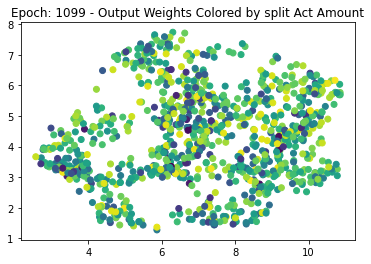

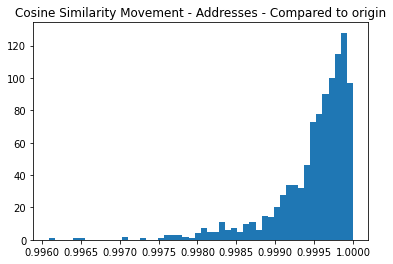

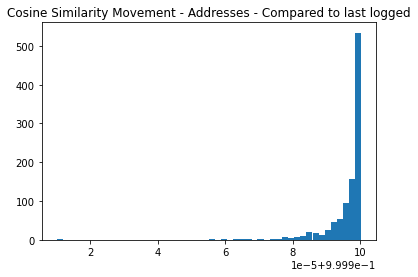

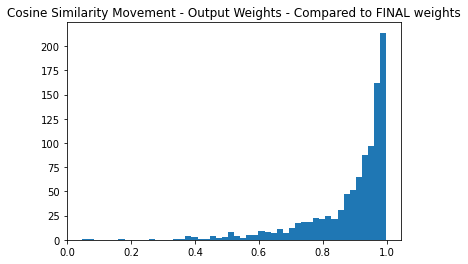

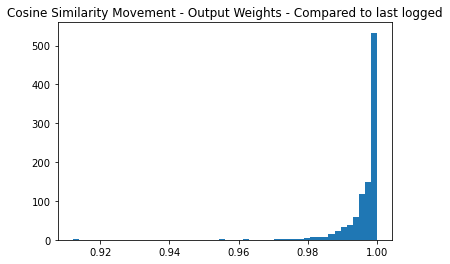

Epoch 1199
Data split 4


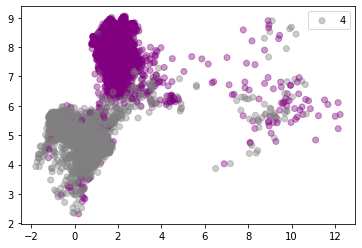

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=1199-step=94799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 8, % neurons most activated=0.07
Label 9, % neurons most activated=0.04


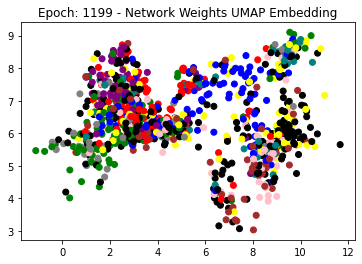

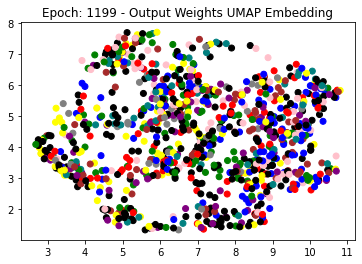

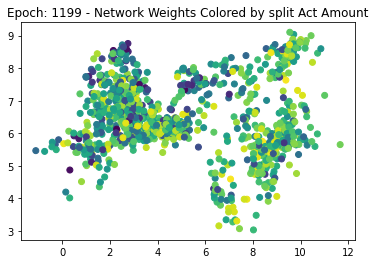

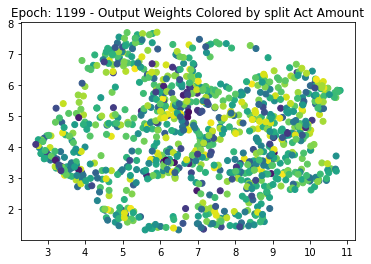

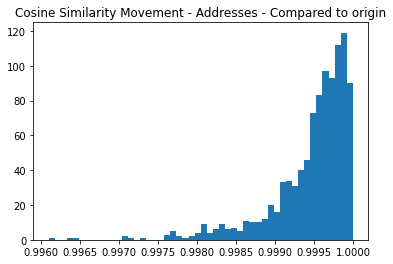

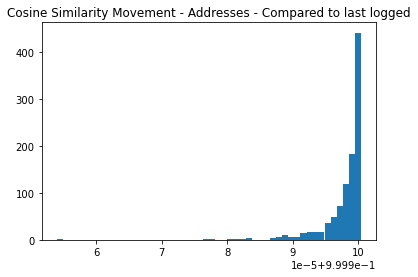

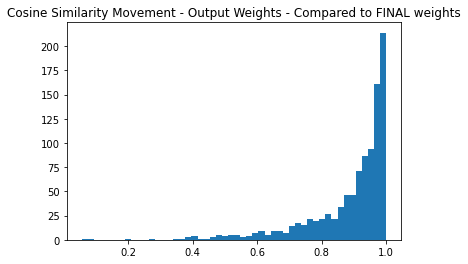

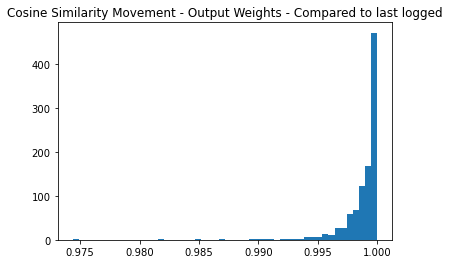

Epoch 1299
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=1299-step=102699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 8, % neurons most activated=0.07
Label 9, % neurons most activated=0.05


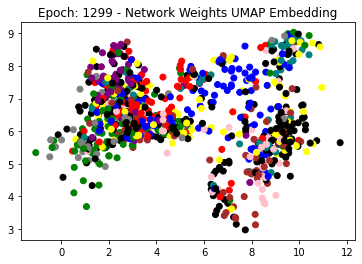

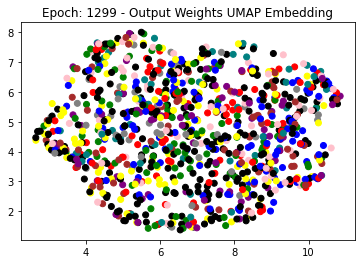

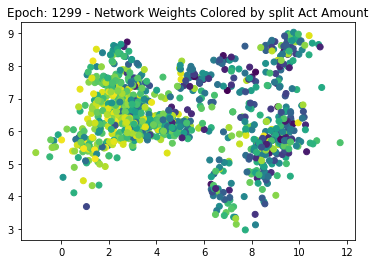

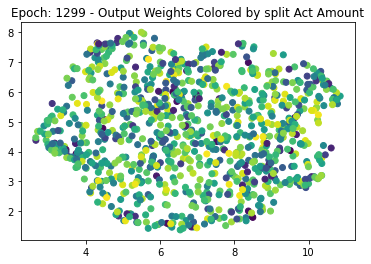

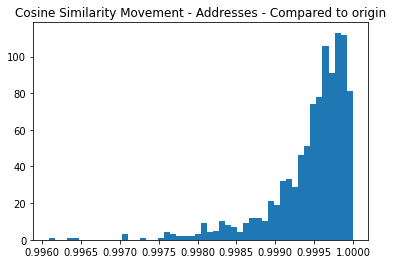

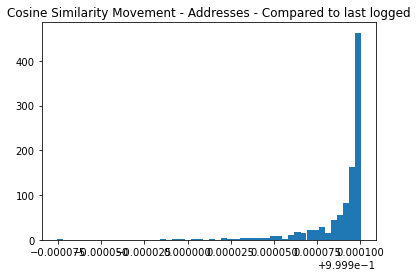

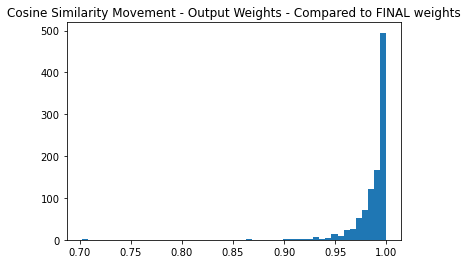

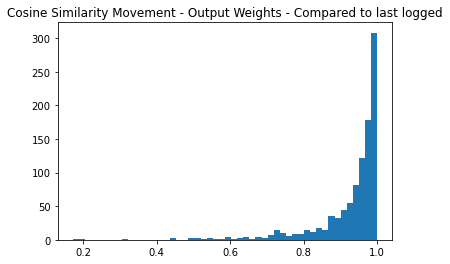

Epoch 1399
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=1399-step=110599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)
Label 8, % neurons most activated=0.07
Label 9, % neurons most activated=0.05


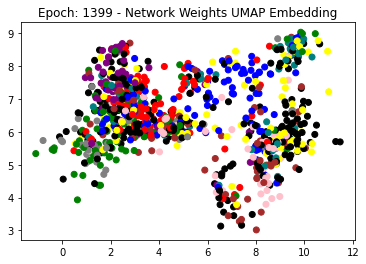

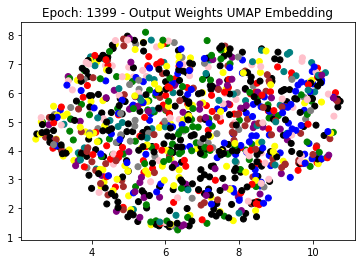

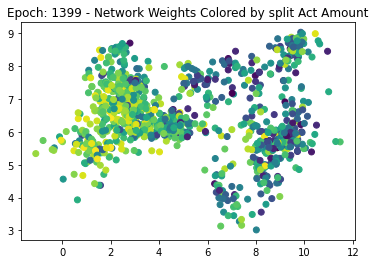

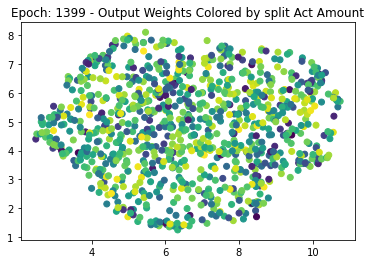

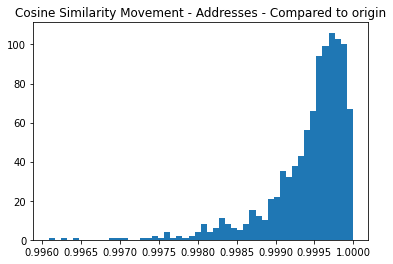

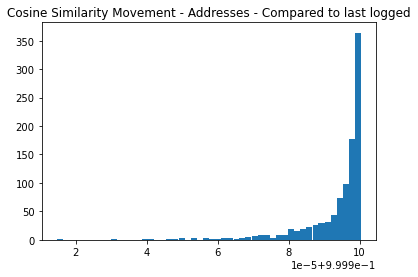

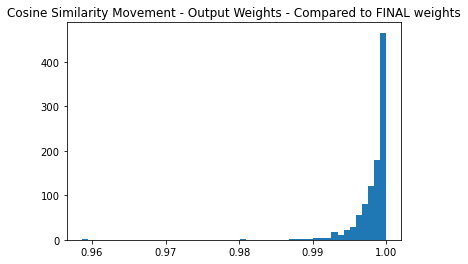

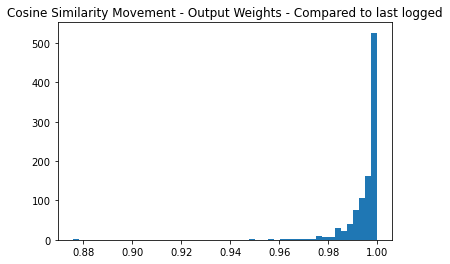

Epoch 1499
Data split 5


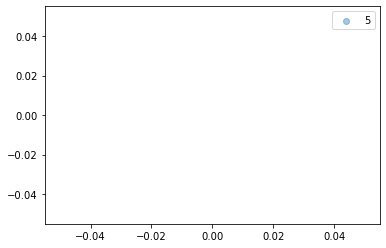

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/20runydu/checkpoints/epoch=1499-step=118499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(1.)


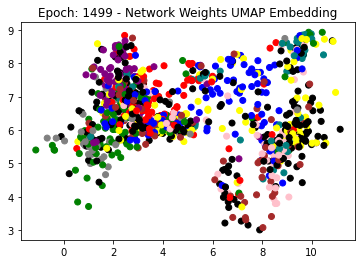

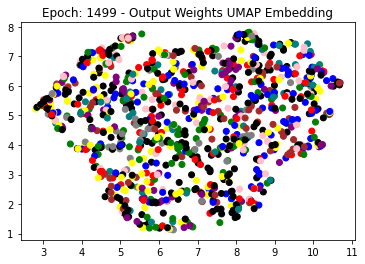

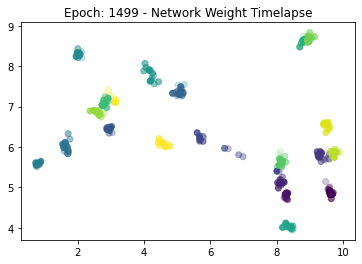

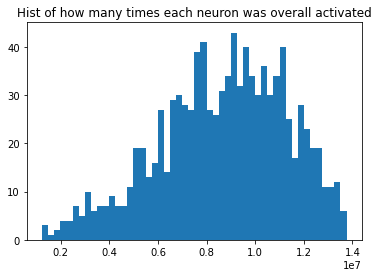

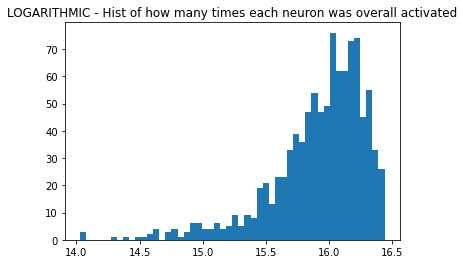

Run is: 2vldgubc
SDM_NoL2Norms_Investigate_ContLearning <class 'models.SDM.SDM'>
data path ../data/ params namespace(act_func=ReLU(), act_string='ReLU()', active_threshold=0.0001, adamw_l2_loss_weight=0.001, adversarial_attack_norm=inf, adversarial_attacks=False, adversarial_max_distortion=0.03, alex_net_freeze_layer_swap=False, all_positive_weights=False, apply_cnn_layer=False, batch_size=128, can_enforce_positive_weights_on_bias_terms=True, check_val_every_n_epoch=1, checkpoint_every_n_epochs=100, classification=True, cnn_kern_size=4, cnn_model=False, cnn_nfilters=128, cnn_padding=0, cnn_relu=True, cnn_stride=None, continual_learning=True, count_dead_train_neurons=False, dataset=<DataSet.SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10: 27>, dataset_path_suffix='CachedOutputs/ConvMixerWTransforms_ImgNet32_CIFAR10/all_data_', dataset_str='SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10', device=device(type='cuda'), dropout_prob=0.0, early_stopping=False, enforce_ewc=False, 

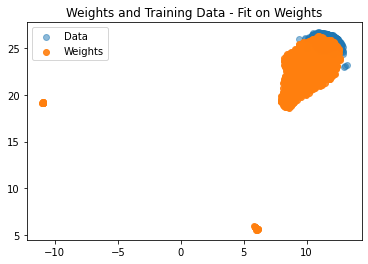

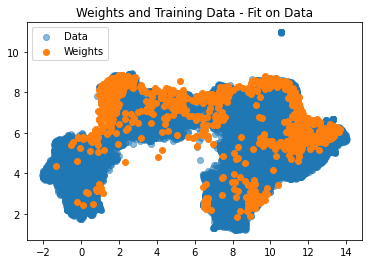

../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/SDM_NoL2Norms_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks


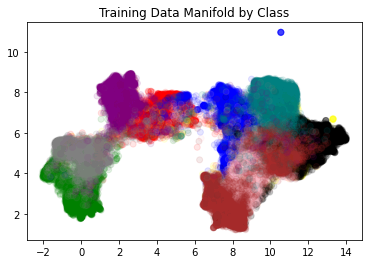

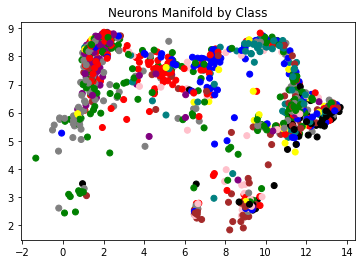

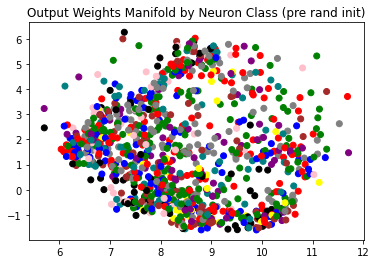

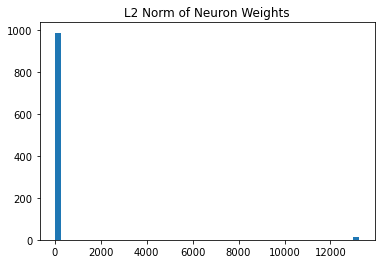

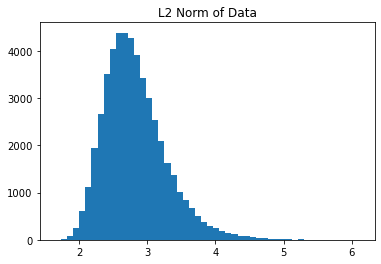

Perc alive neurons tensor(0.8280)


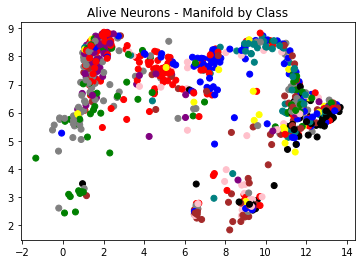

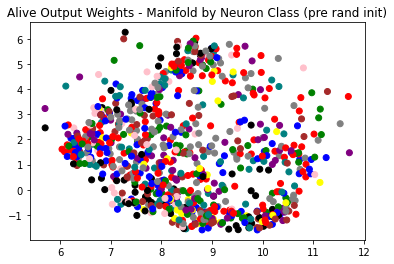

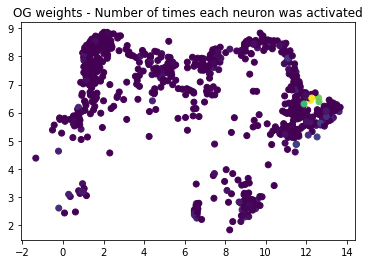

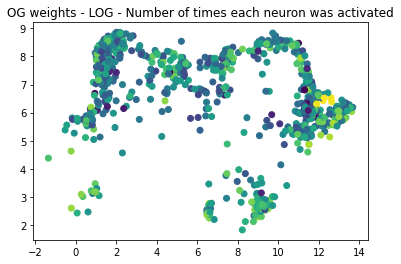

Epoch 0
Data split 0


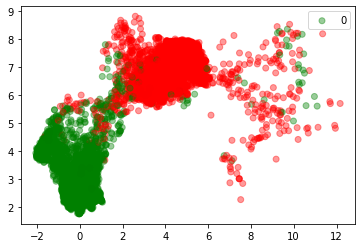

Trimming the output weights. model index is: 0
../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/SDM_NoL2Norms_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks
Perc alive neurons tensor(0.5290)
Label 0, % neurons most activated=0.17
Label 1, % neurons most activated=0.09


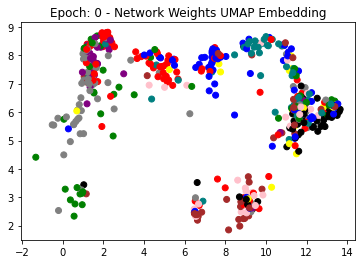

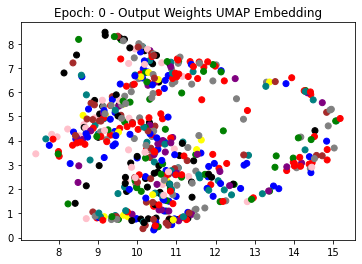

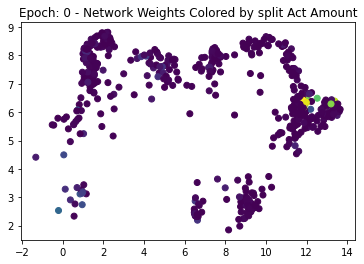

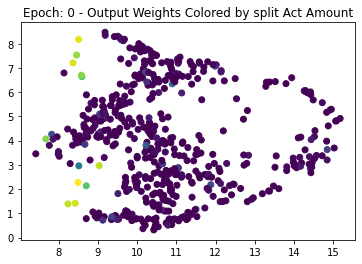

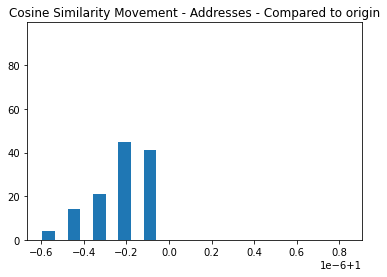

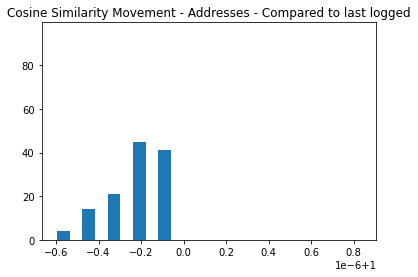

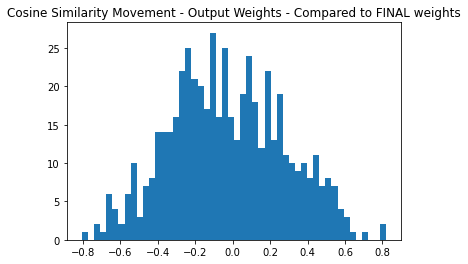

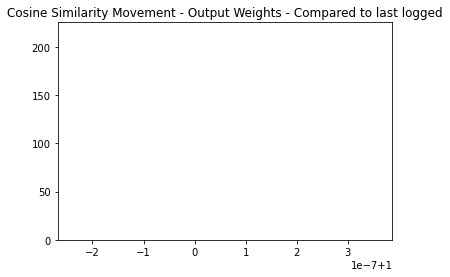

Epoch 99
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=99-step=7899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.5000)
Label 0, % neurons most activated=0.16
Label 1, % neurons most activated=0.09


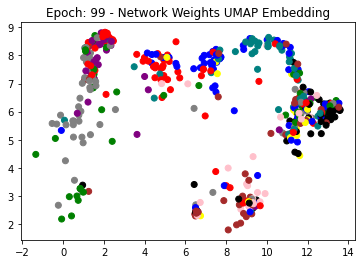

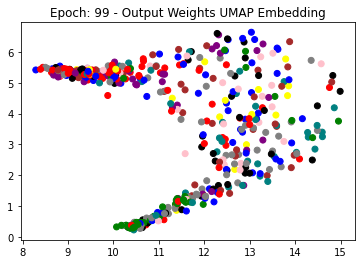

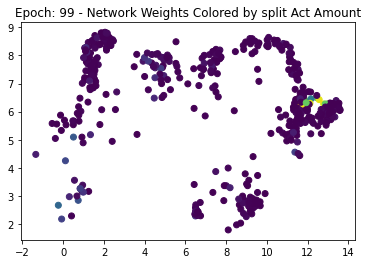

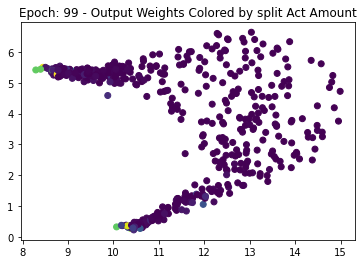

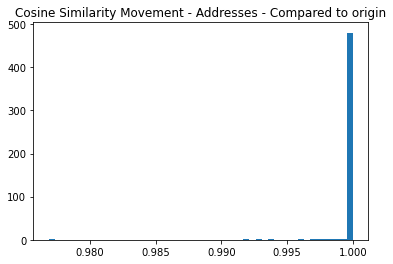

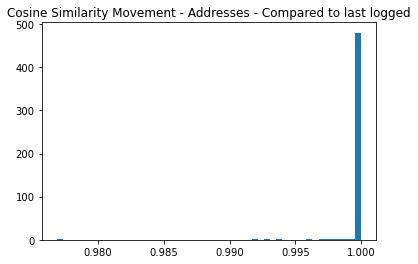

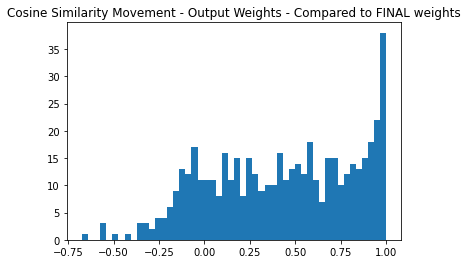

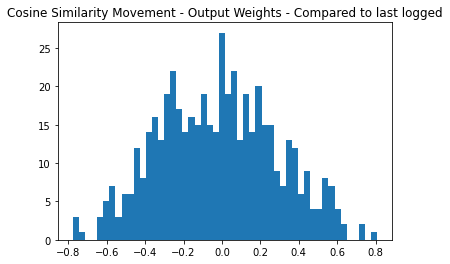

Epoch 199
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=199-step=15799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4940)
Label 0, % neurons most activated=0.16
Label 1, % neurons most activated=0.09


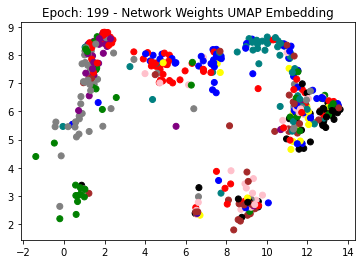

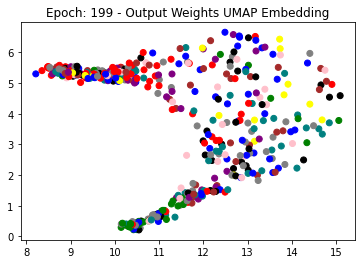

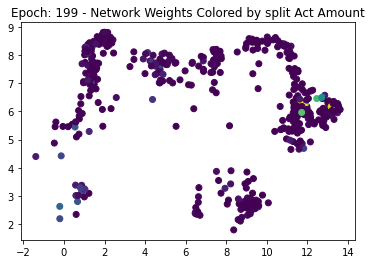

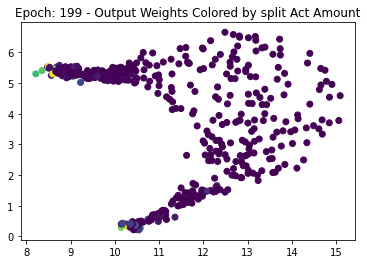

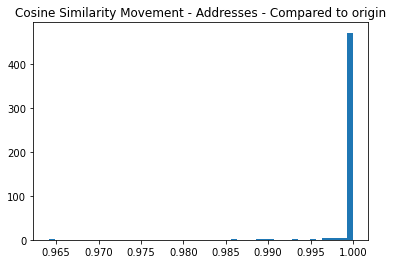

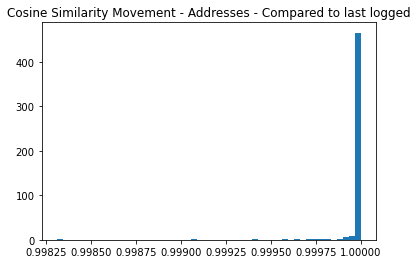

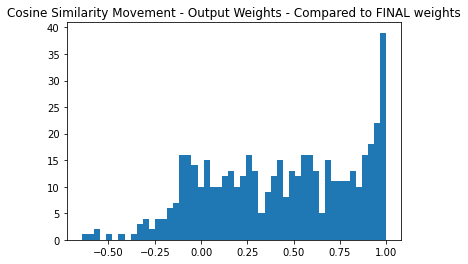

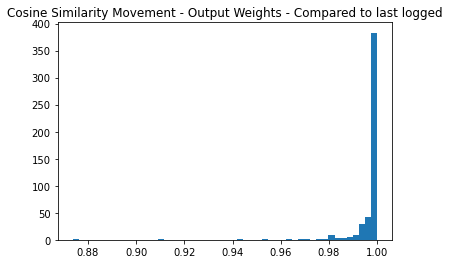

Epoch 299
Data split 1


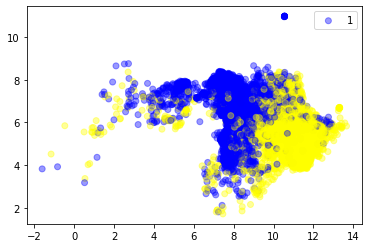

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=299-step=23699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4920)
Label 2, % neurons most activated=0.14
Label 3, % neurons most activated=0.04


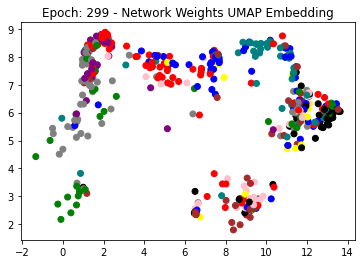

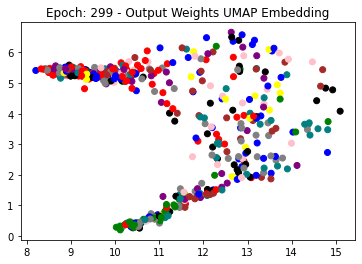

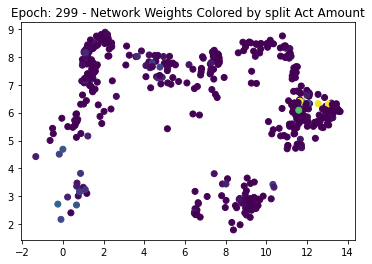

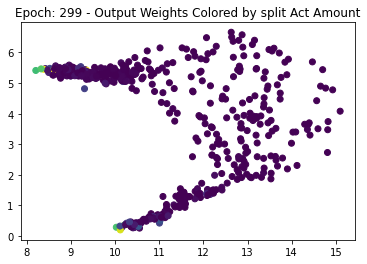

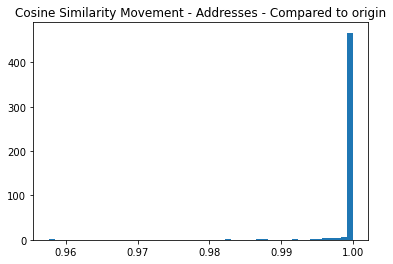

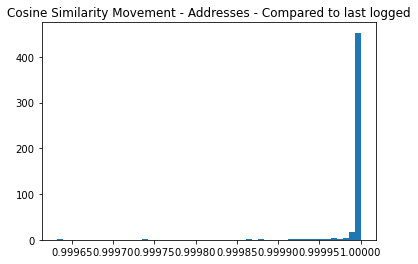

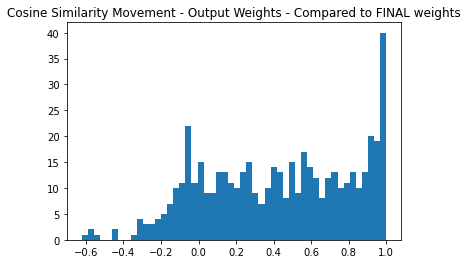

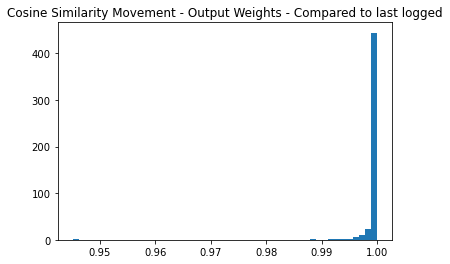

Epoch 399
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=399-step=31599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4700)
Label 2, % neurons most activated=0.13
Label 3, % neurons most activated=0.05


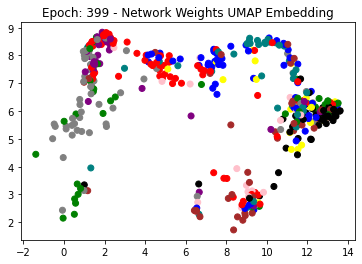

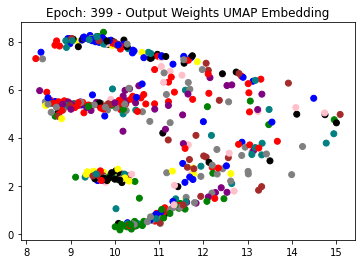

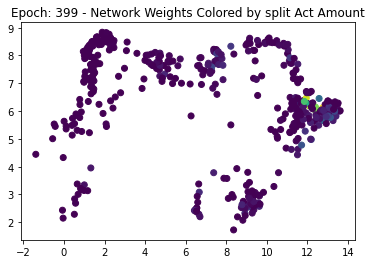

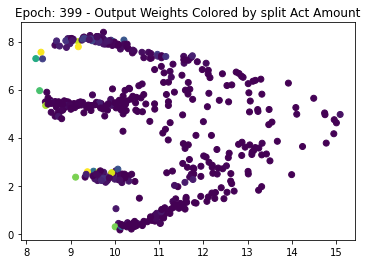

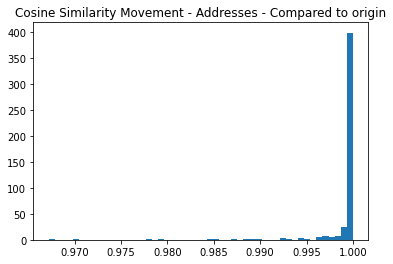

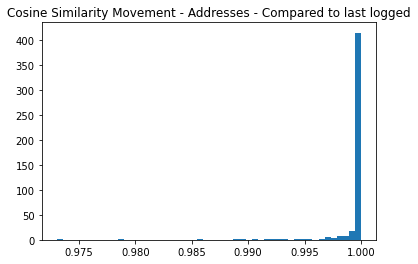

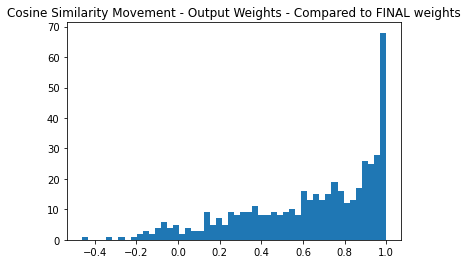

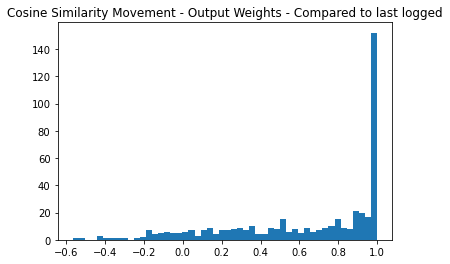

Epoch 499
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=499-step=39499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4630)
Label 2, % neurons most activated=0.14
Label 3, % neurons most activated=0.05


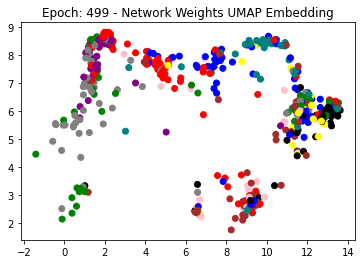

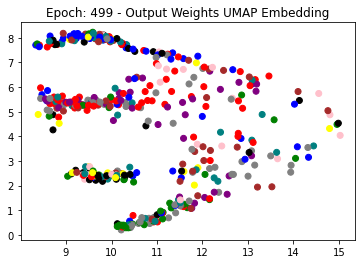

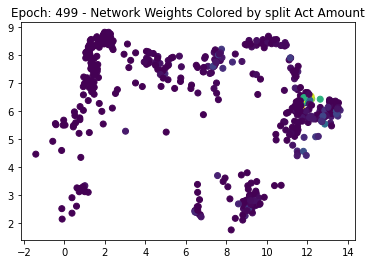

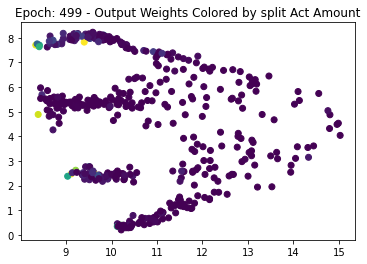

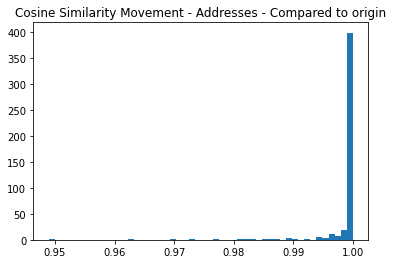

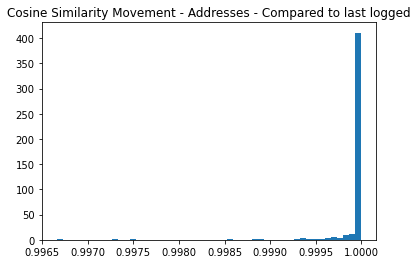

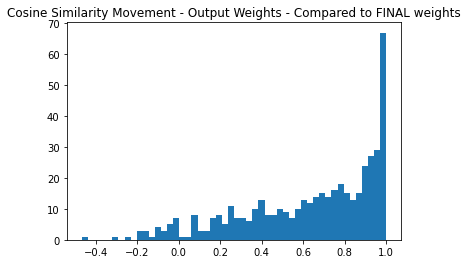

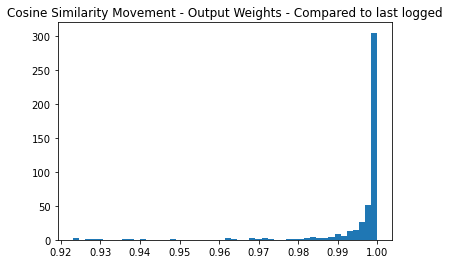

Epoch 599
Data split 2


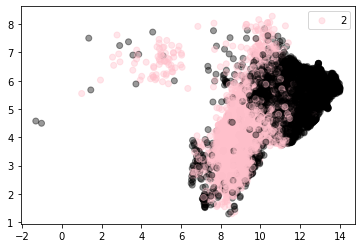

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=599-step=47399.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4570)
Label 4, % neurons most activated=0.06
Label 5, % neurons most activated=0.09


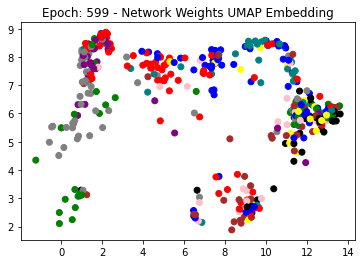

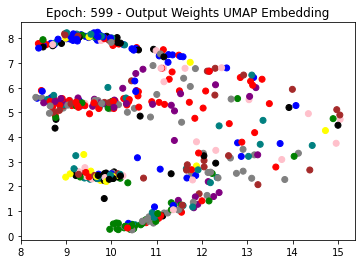

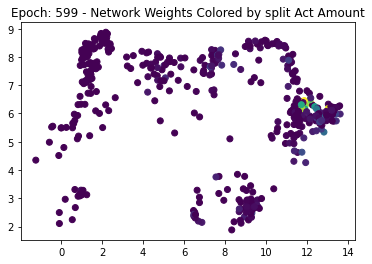

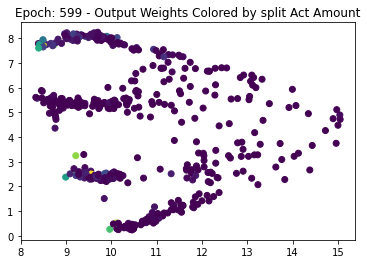

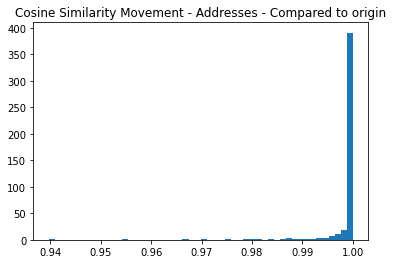

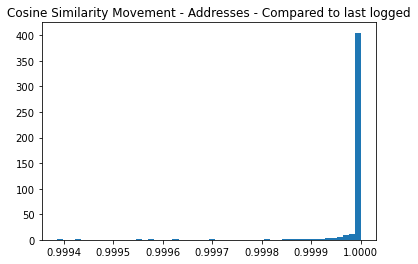

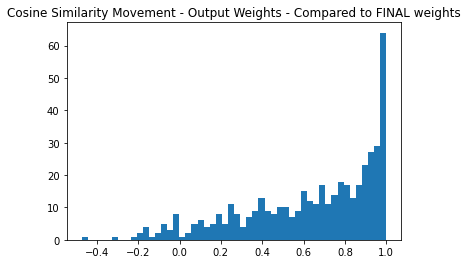

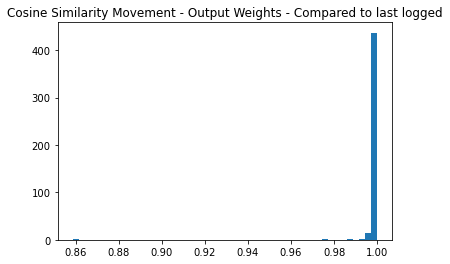

Epoch 699
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=699-step=55299.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4490)
Label 4, % neurons most activated=0.05
Label 5, % neurons most activated=0.1


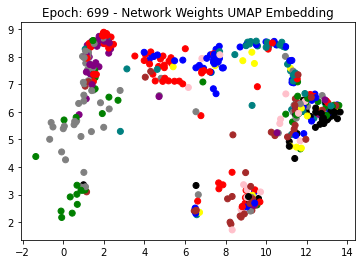

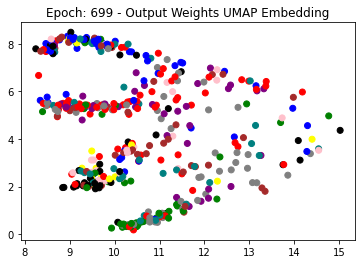

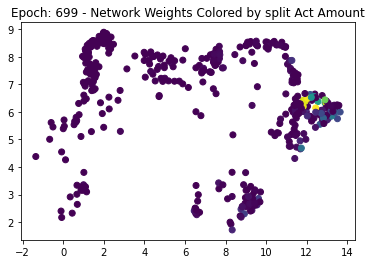

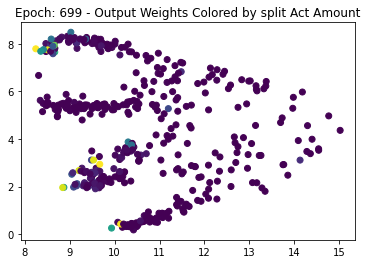

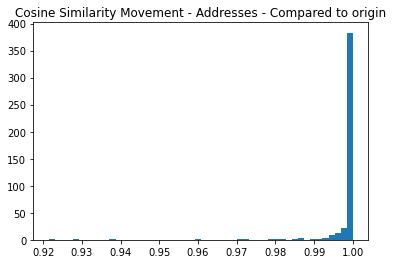

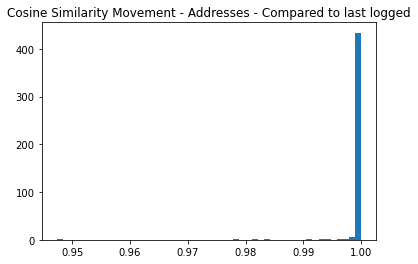

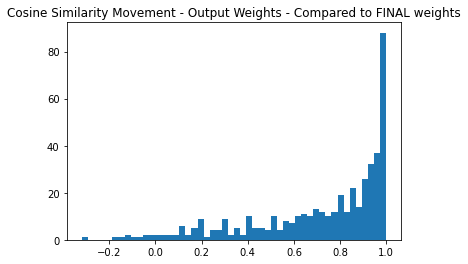

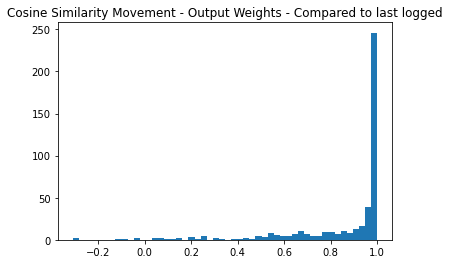

Epoch 799
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=799-step=63199.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4380)
Label 4, % neurons most activated=0.05
Label 5, % neurons most activated=0.09


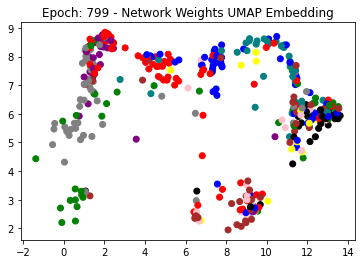

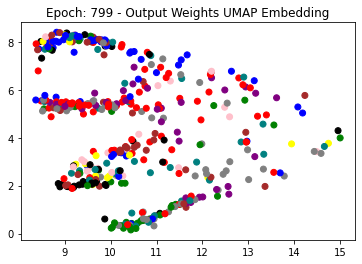

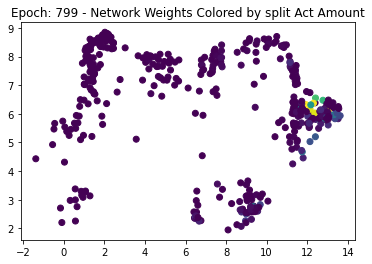

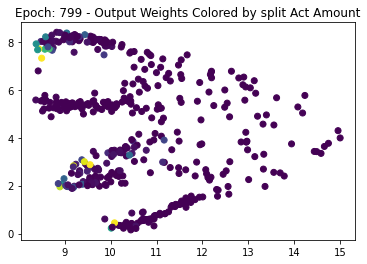

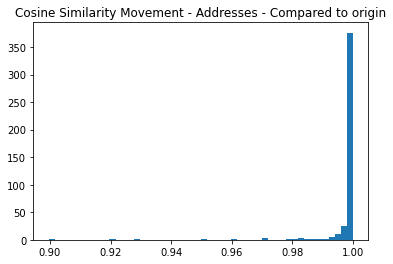

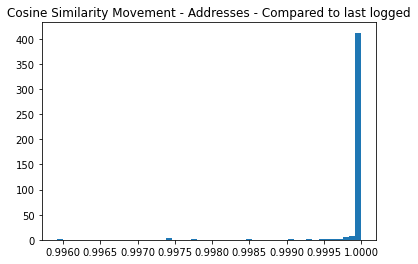

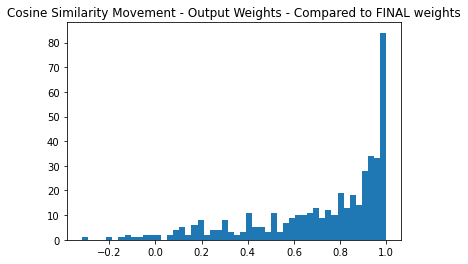

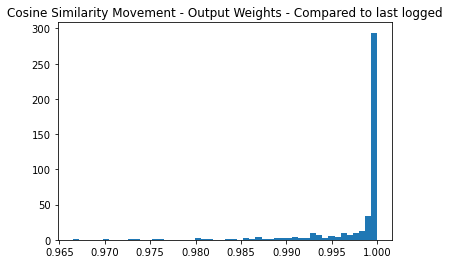

Epoch 899
Data split 3


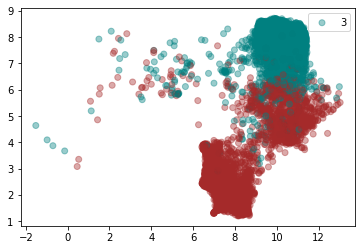

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=899-step=71099.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4330)
Label 6, % neurons most activated=0.09
Label 7, % neurons most activated=0.09


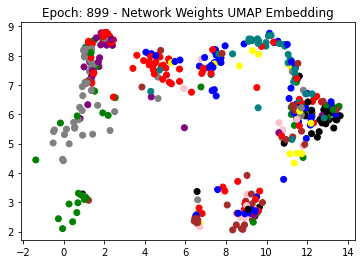

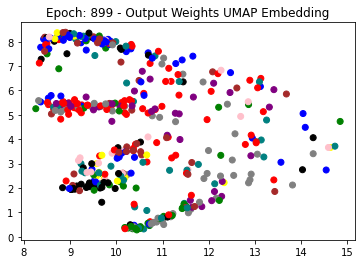

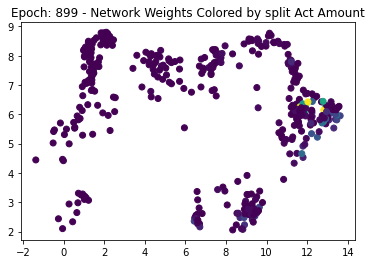

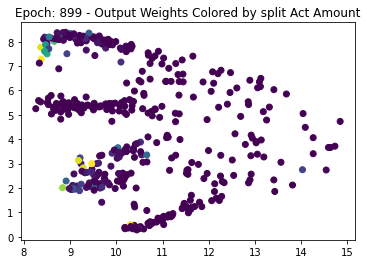

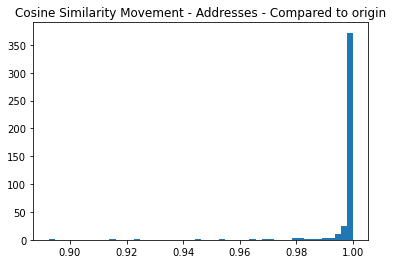

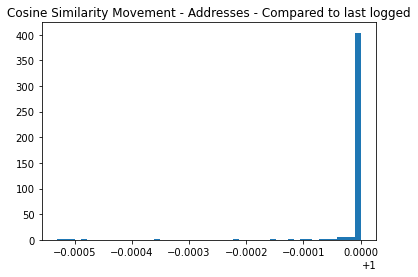

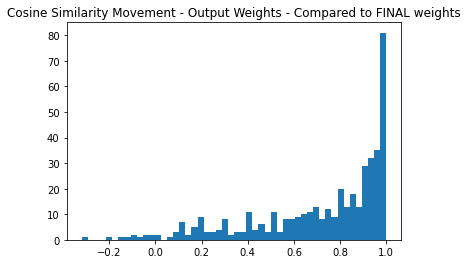

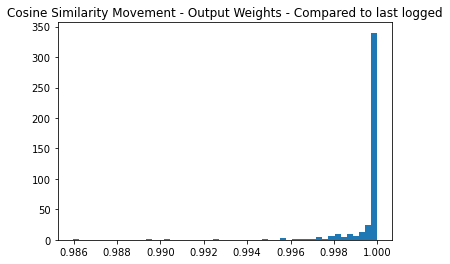

Epoch 999
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=999-step=78999.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4250)
Label 6, % neurons most activated=0.1
Label 7, % neurons most activated=0.07


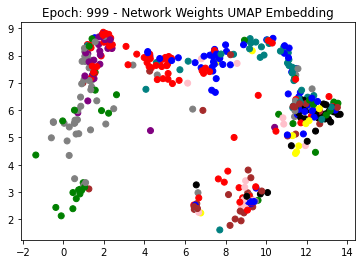

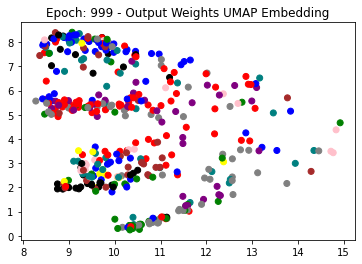

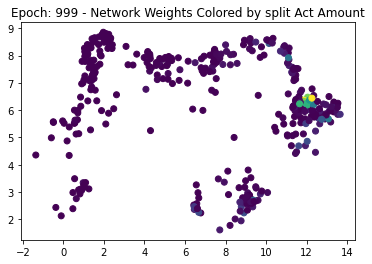

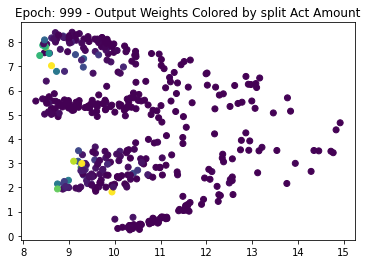

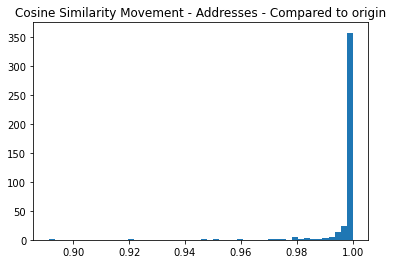

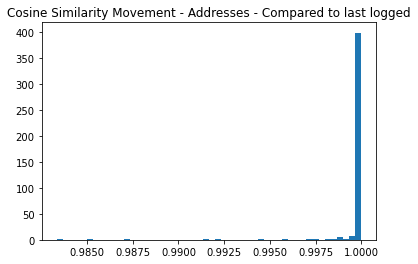

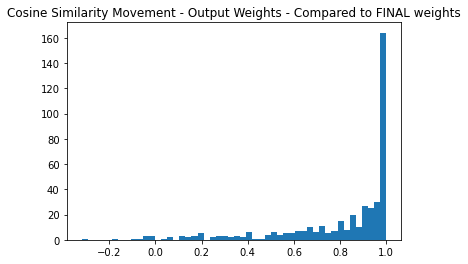

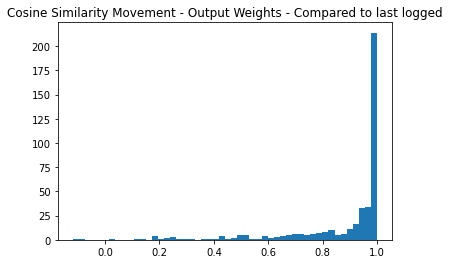

Epoch 1099
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=1099-step=86899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4160)
Label 6, % neurons most activated=0.1
Label 7, % neurons most activated=0.08


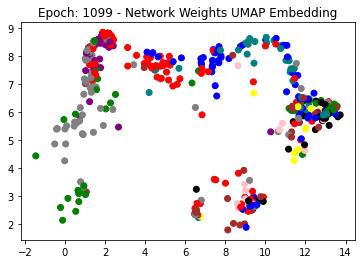

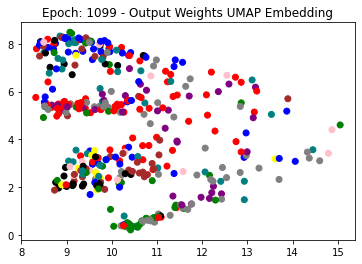

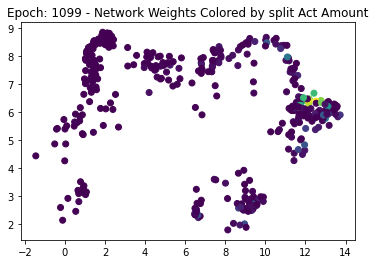

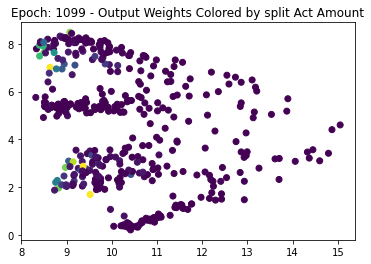

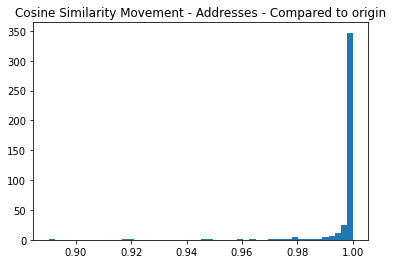

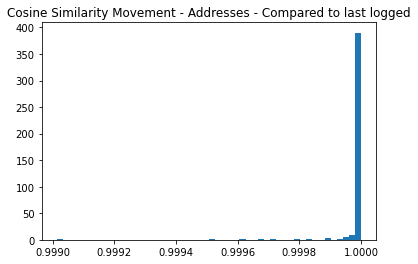

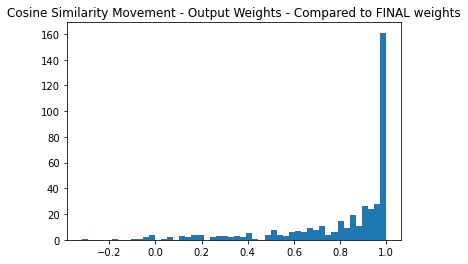

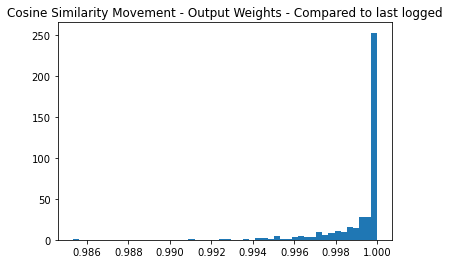

Epoch 1199
Data split 4


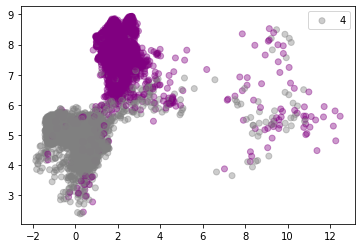

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=1199-step=94799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4140)
Label 8, % neurons most activated=0.08
Label 9, % neurons most activated=0.15


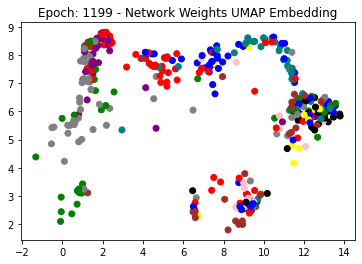

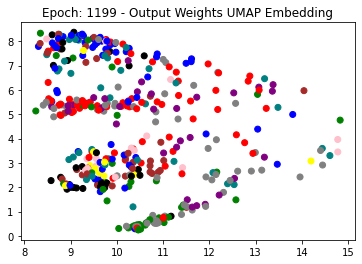

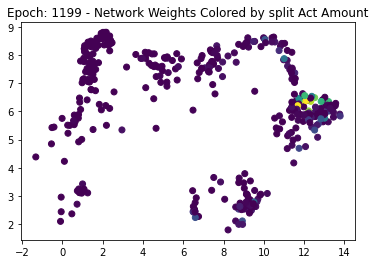

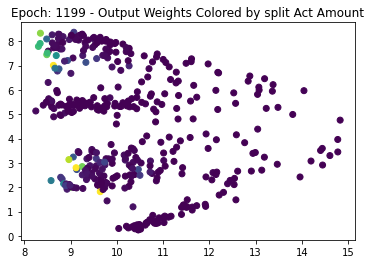

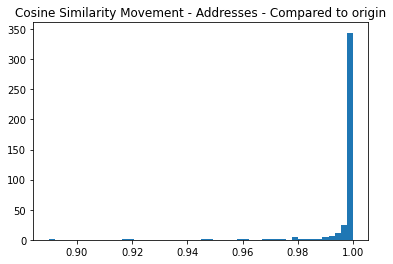

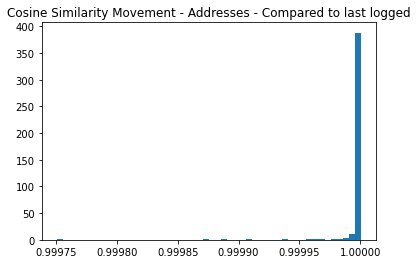

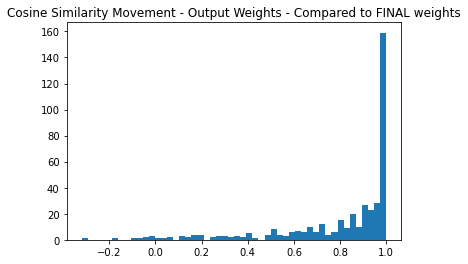

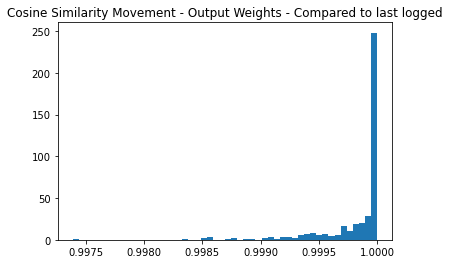

Epoch 1299
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=1299-step=102699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.4040)
Label 8, % neurons most activated=0.08
Label 9, % neurons most activated=0.12


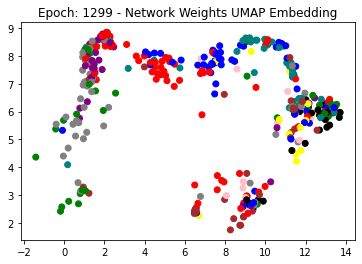

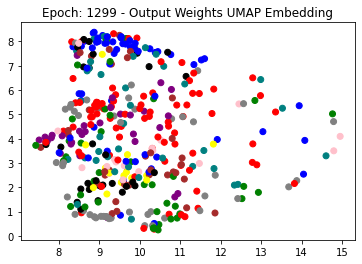

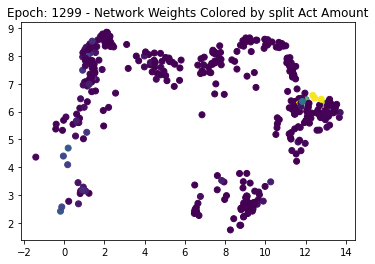

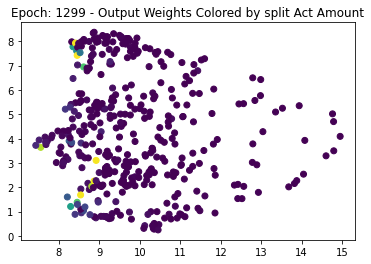

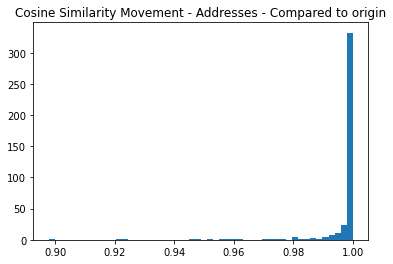

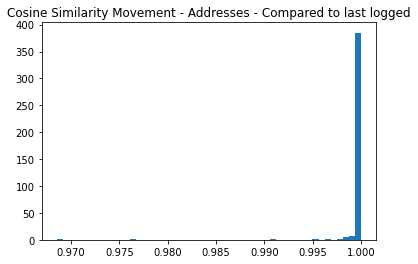

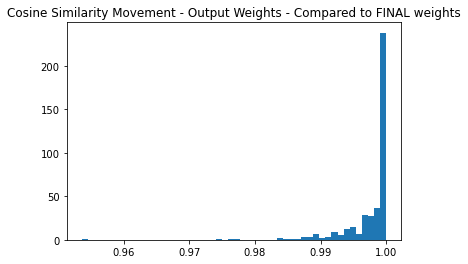

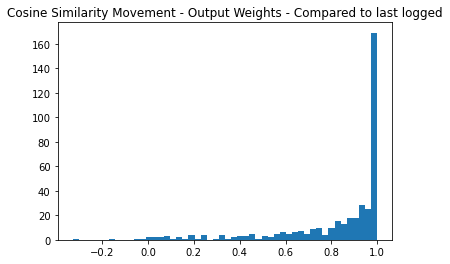

Epoch 1399
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=1399-step=110599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.3990)
Label 8, % neurons most activated=0.08
Label 9, % neurons most activated=0.12


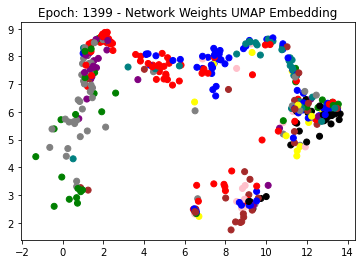

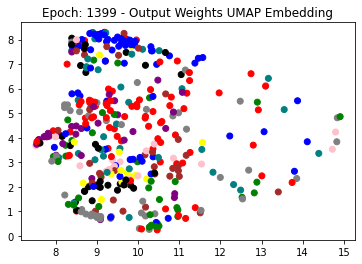

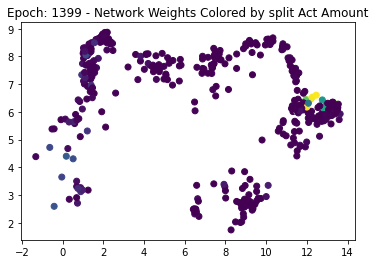

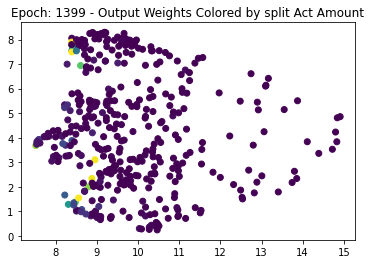

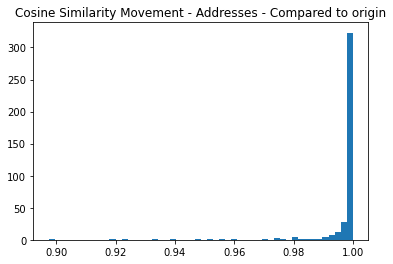

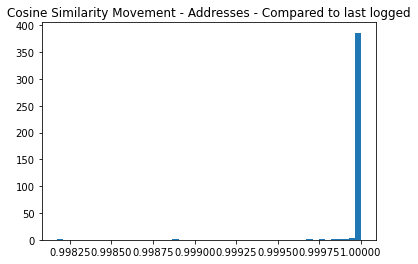

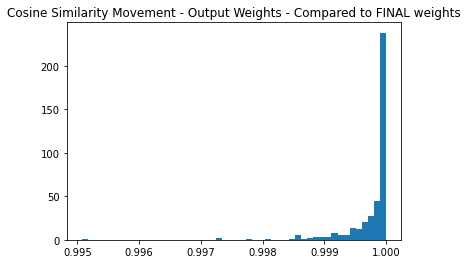

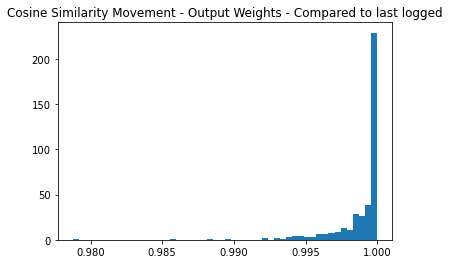

Epoch 1499
Data split 5


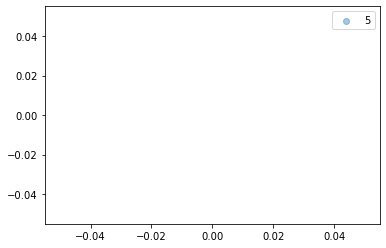

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/2vldgubc/checkpoints/epoch=1499-step=118499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.3970)


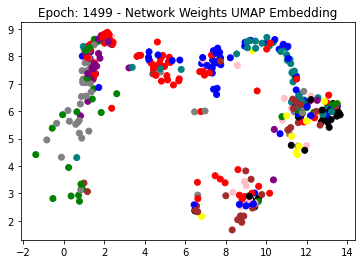

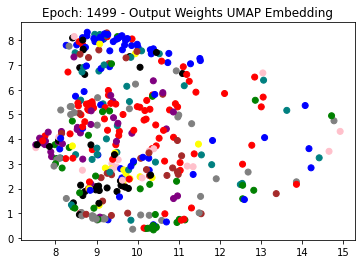

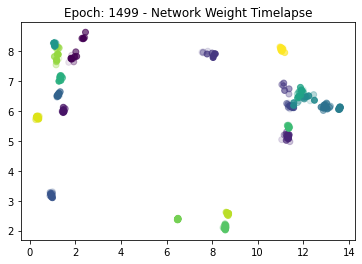

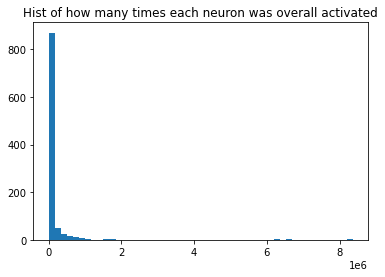

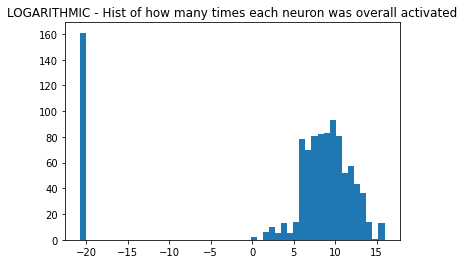

Run is: f2baqhx6
SDM_Investigate_ContLearning <class 'models.SDM.SDM'>
data path ../data/ params namespace(act_func=ReLU(), act_string='ReLU()', active_threshold=0.0001, adamw_l2_loss_weight=0.001, adversarial_attack_norm=inf, adversarial_attacks=False, adversarial_max_distortion=0.03, alex_net_freeze_layer_swap=False, all_positive_weights=False, apply_cnn_layer=False, batch_size=128, can_enforce_positive_weights_on_bias_terms=True, check_val_every_n_epoch=1, checkpoint_every_n_epochs=100, classification=True, cnn_kern_size=4, cnn_model=False, cnn_nfilters=128, cnn_padding=0, cnn_relu=True, cnn_stride=None, continual_learning=True, count_dead_train_neurons=False, dataset=<DataSet.SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10: 27>, dataset_path_suffix='CachedOutputs/ConvMixerWTransforms_ImgNet32_CIFAR10/all_data_', dataset_str='SPLIT_Cached_ConvMixer_WTransforms_ImageNet32_CIFAR10', device=device(type='cuda'), dropout_prob=0.0, early_stopping=False, enforce_ewc=False, epoch_rela

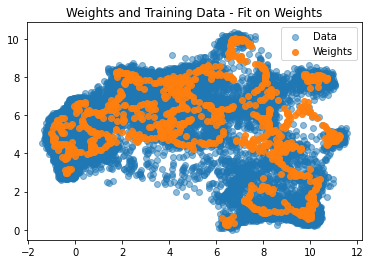

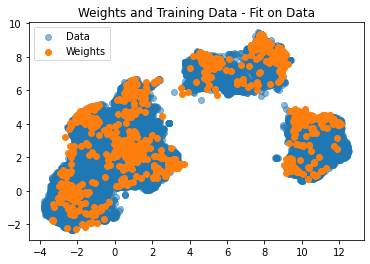

../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/SDM_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks


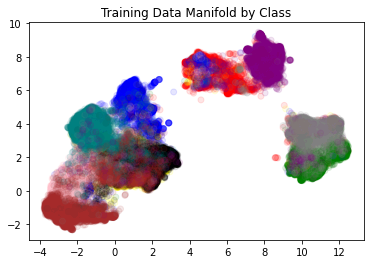

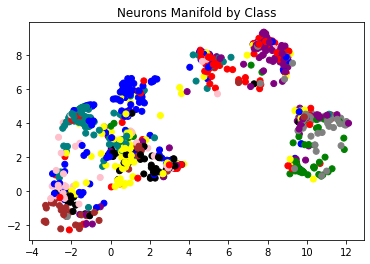

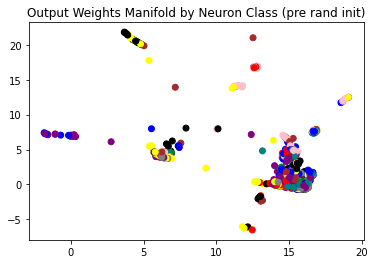

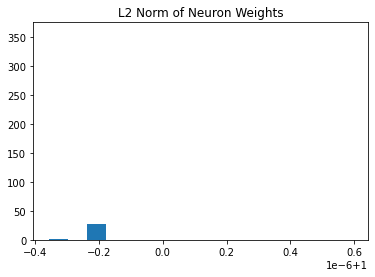

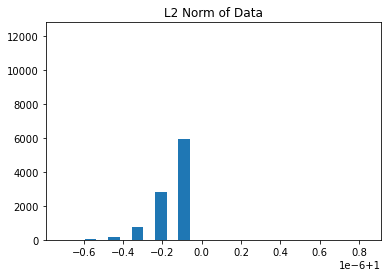

Perc alive neurons tensor(0.9910)


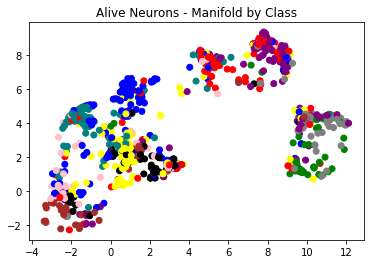

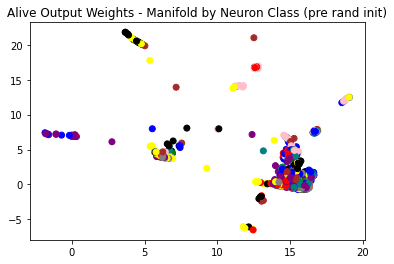

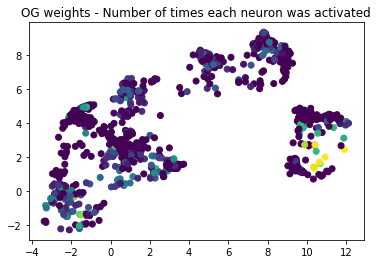

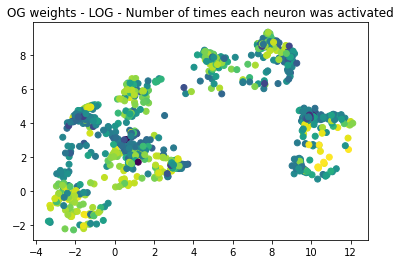

Epoch 0
Data split 0


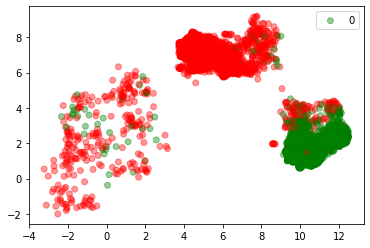

Trimming the output weights. model index is: 0
../experiments/ConvMixer_ImageNet32_ImageNet32_ContLearnStarters/SDM_ContinualLearningPretrains_ConvMixer_WTransforms_ImageNet32_ImageNet32 /home/tbb16/Foundational-SDM/notebooks
Perc alive neurons tensor(0.2760)
Label 0, % neurons most activated=0.09
Label 1, % neurons most activated=0.05


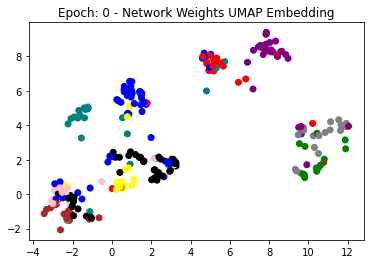

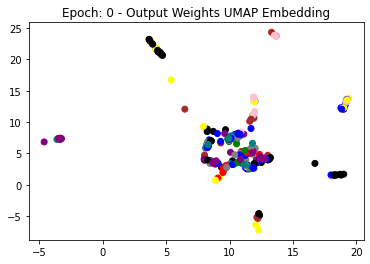

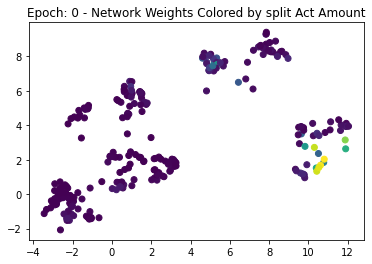

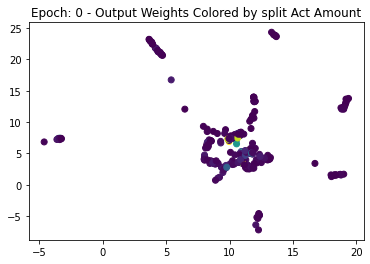

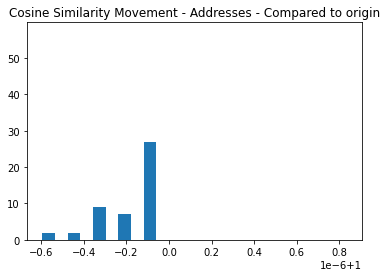

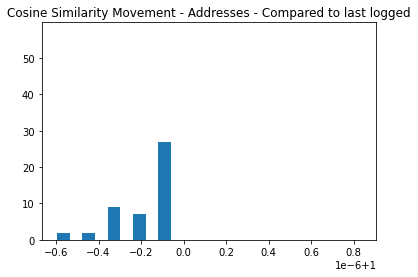

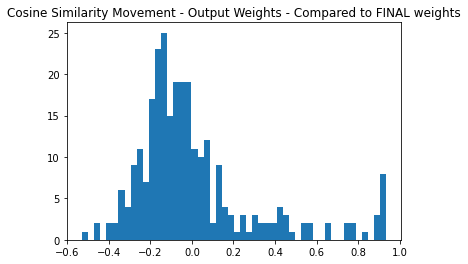

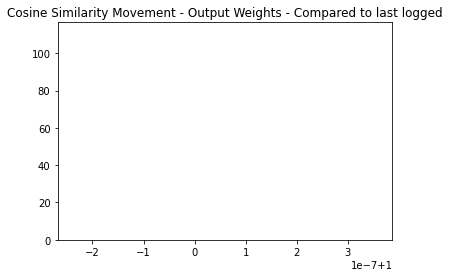

Epoch 99
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=99-step=7899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2330)
Label 0, % neurons most activated=0.19
Label 1, % neurons most activated=0.05


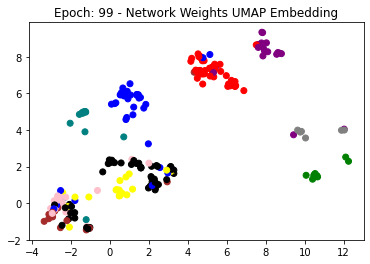

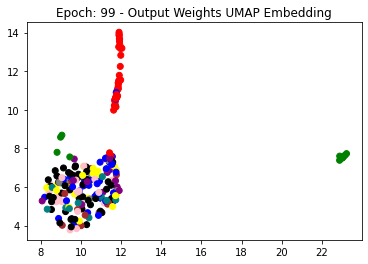

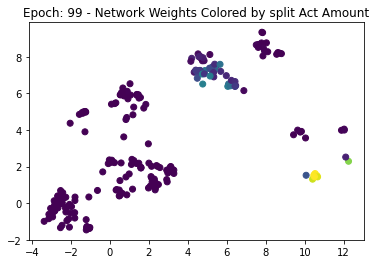

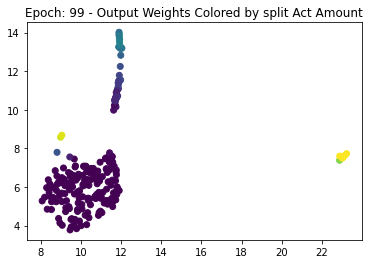

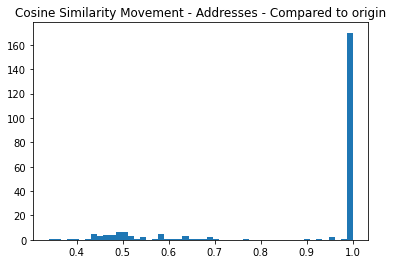

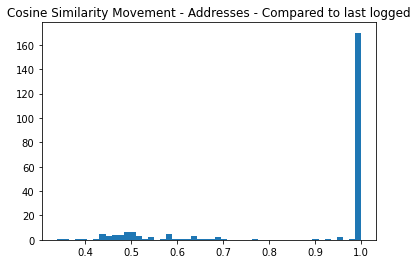

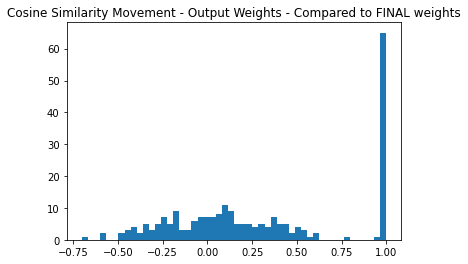

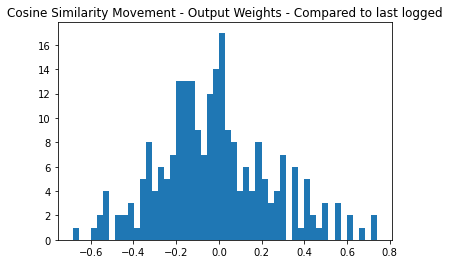

Epoch 199
Data split 0
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=199-step=15799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2400)
Label 0, % neurons most activated=0.21
Label 1, % neurons most activated=0.05


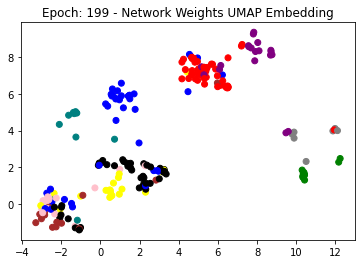

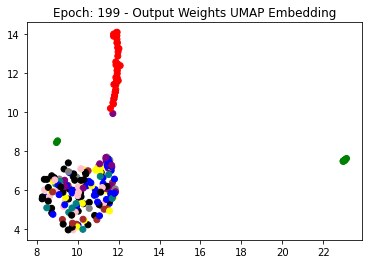

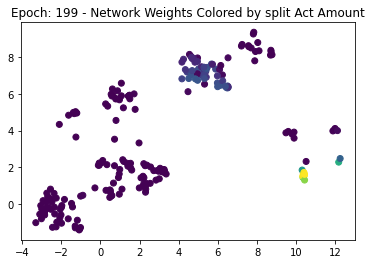

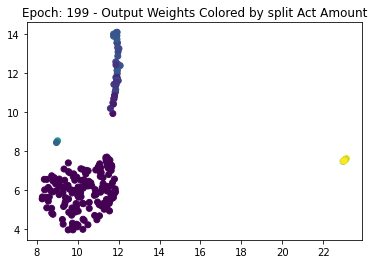

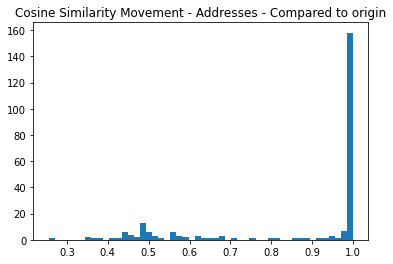

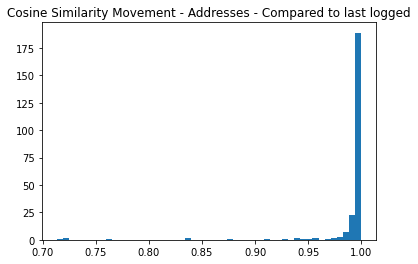

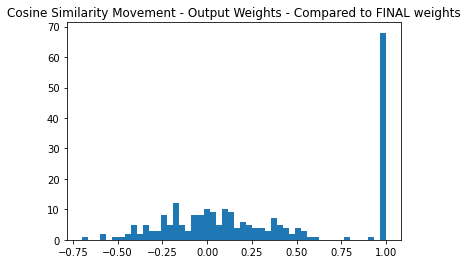

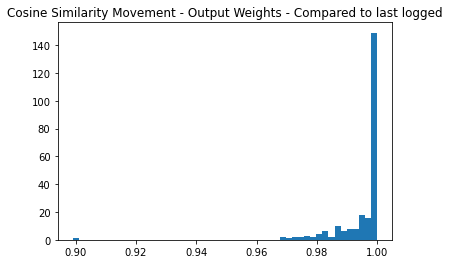

Epoch 299
Data split 1


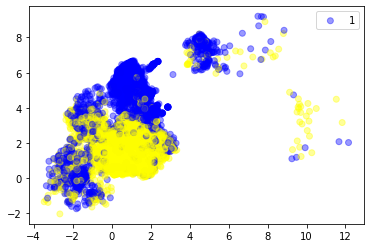

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=299-step=23699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2480)
Label 2, % neurons most activated=0.15
Label 3, % neurons most activated=0.06


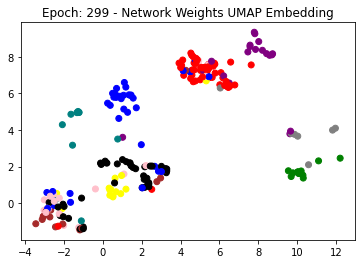

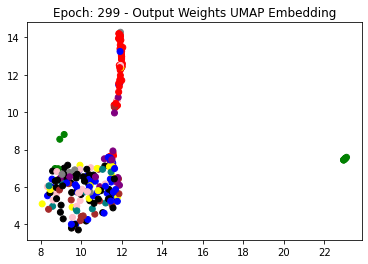

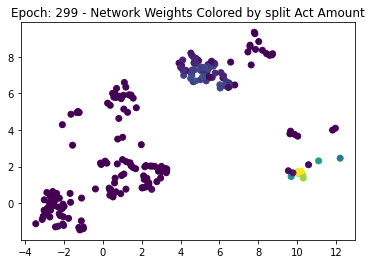

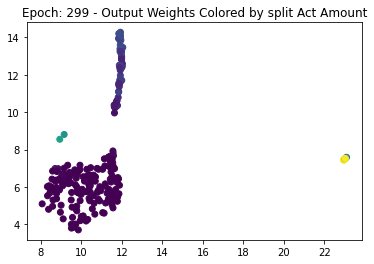

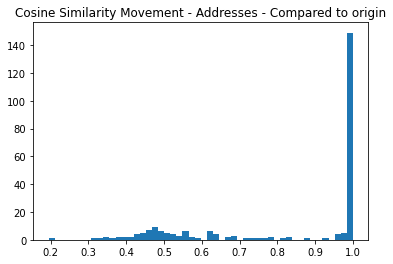

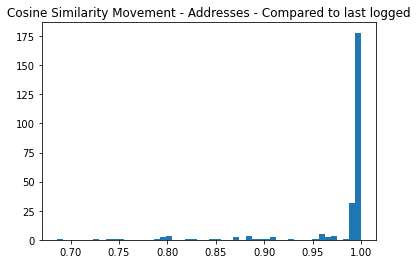

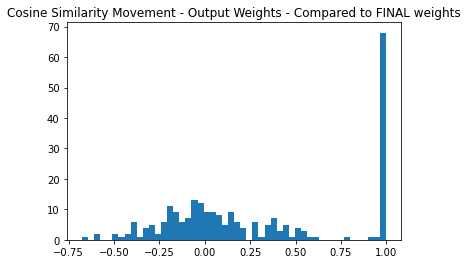

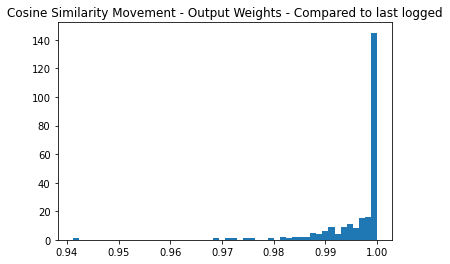

Epoch 399
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=399-step=31599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2200)
Label 2, % neurons most activated=0.23
Label 3, % neurons most activated=0.11


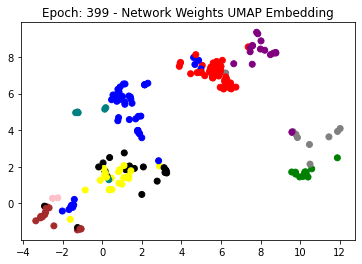

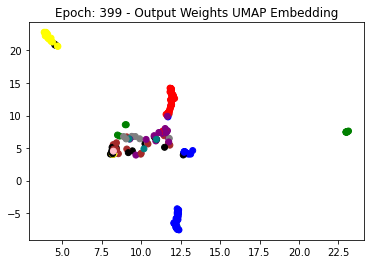

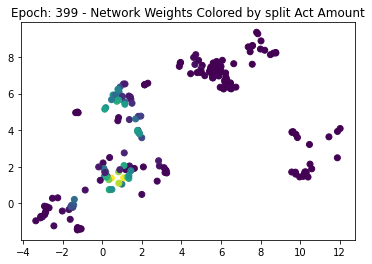

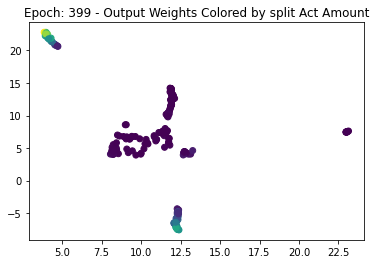

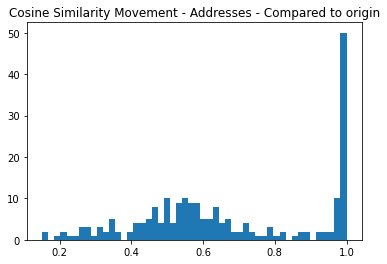

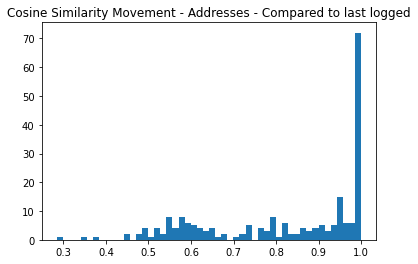

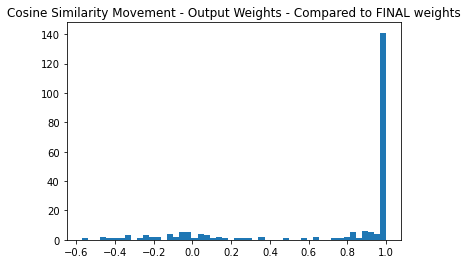

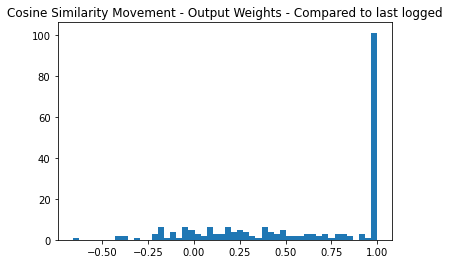

Epoch 499
Data split 1
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=499-step=39499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2420)
Label 2, % neurons most activated=0.26
Label 3, % neurons most activated=0.12


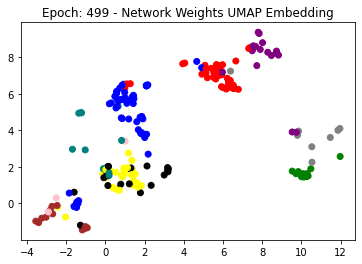

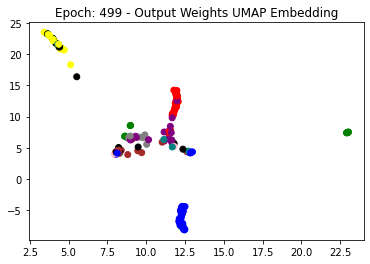

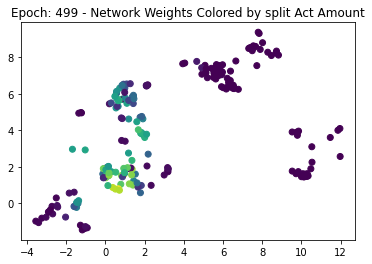

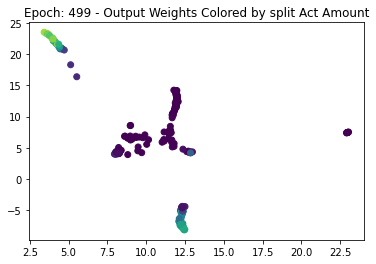

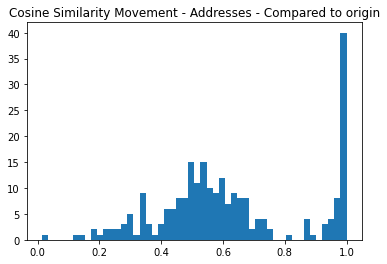

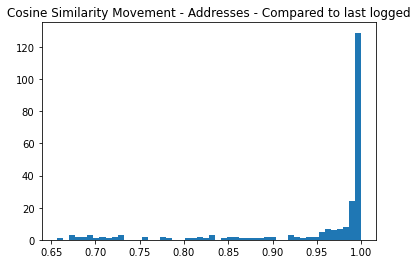

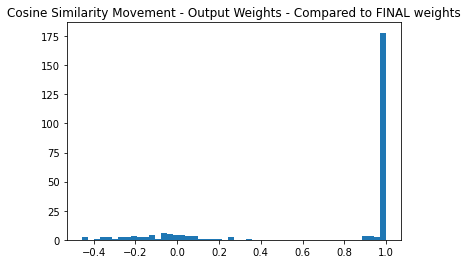

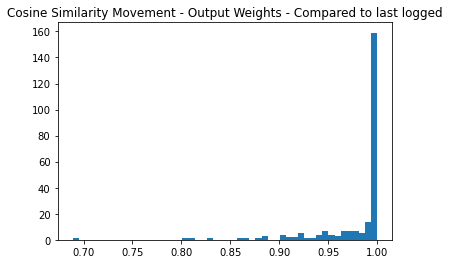

Epoch 599
Data split 2


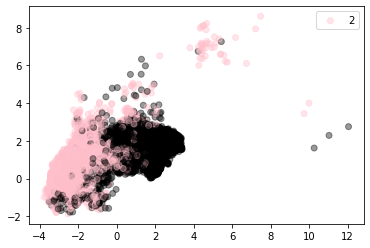

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=599-step=47399.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2790)
Label 4, % neurons most activated=0.03
Label 5, % neurons most activated=0.07


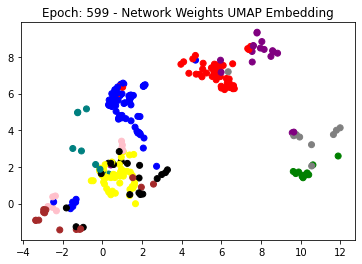

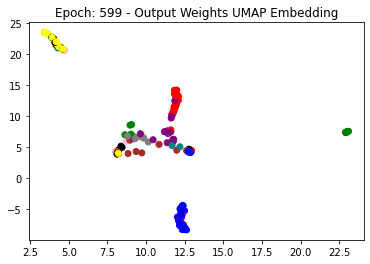

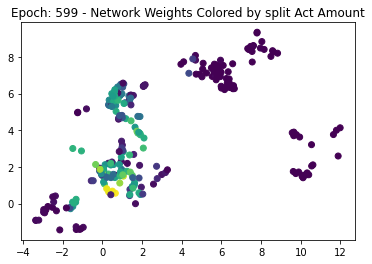

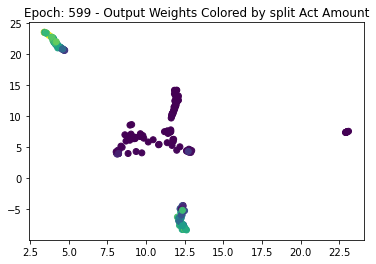

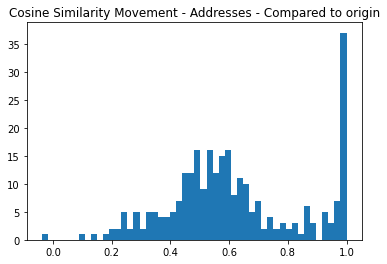

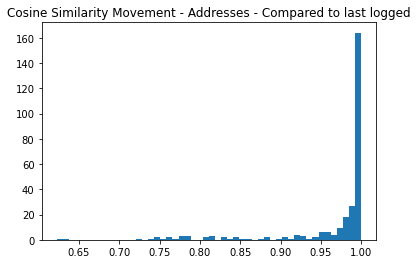

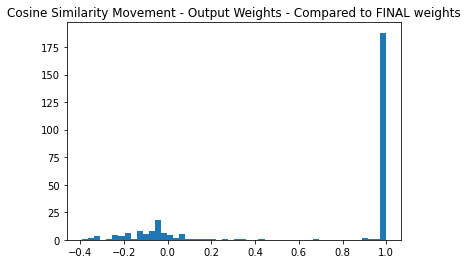

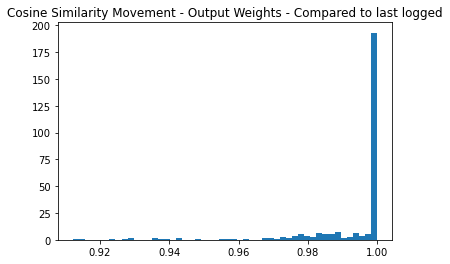

Epoch 699
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=699-step=55299.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2580)
Label 4, % neurons most activated=0.07
Label 5, % neurons most activated=0.13


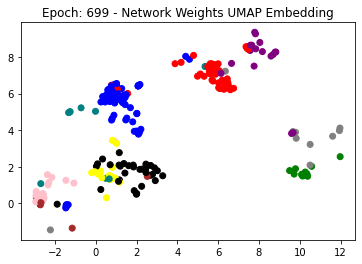

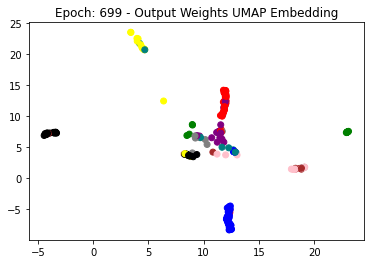

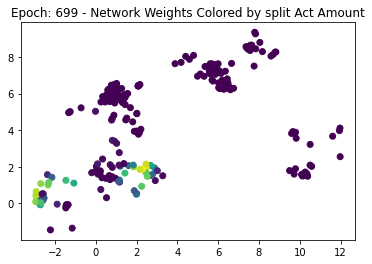

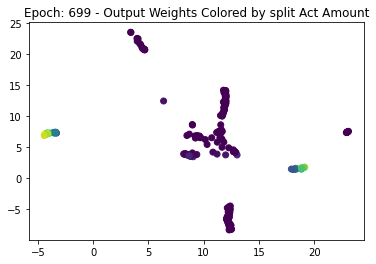

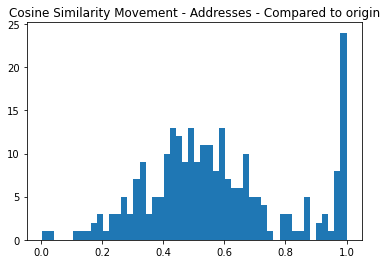

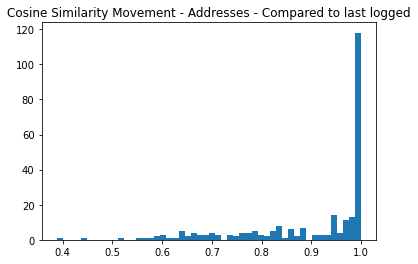

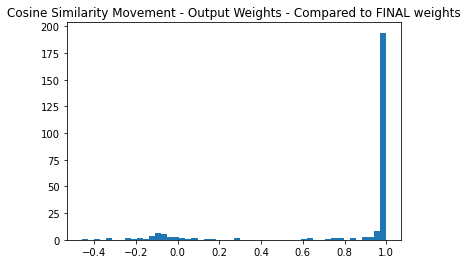

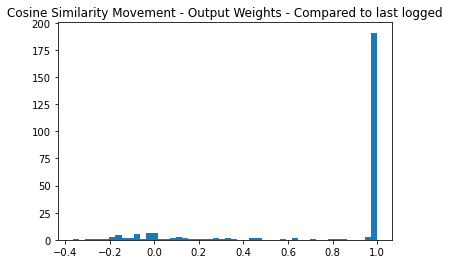

Epoch 799
Data split 2
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=799-step=63199.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2610)
Label 4, % neurons most activated=0.11
Label 5, % neurons most activated=0.14


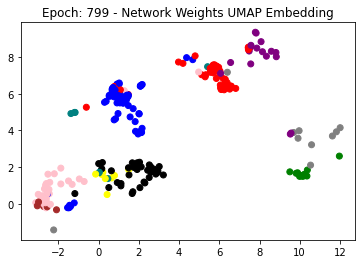

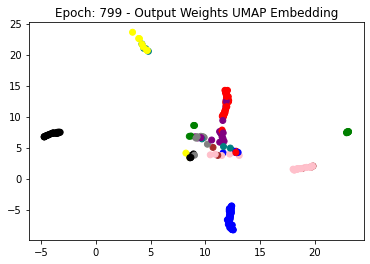

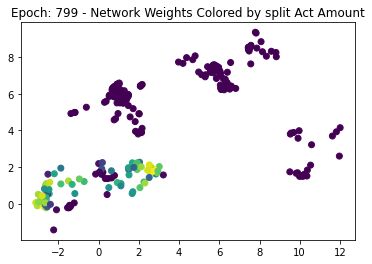

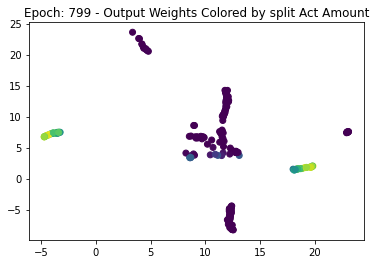

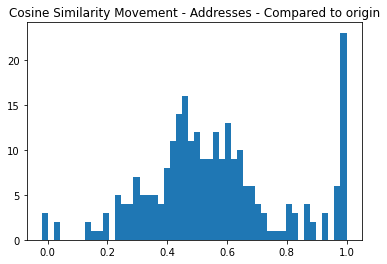

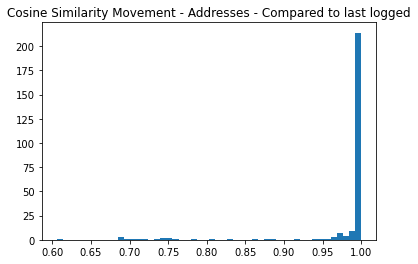

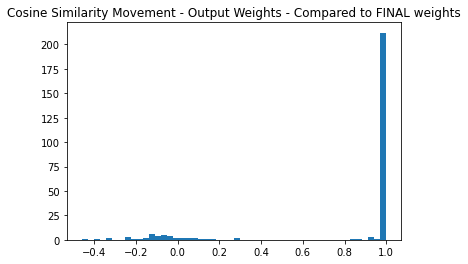

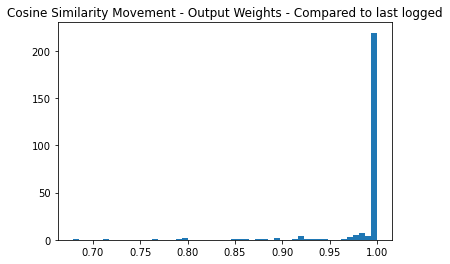

Epoch 899
Data split 3


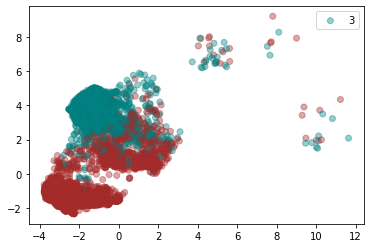

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=899-step=71099.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2620)
Label 6, % neurons most activated=0.04
Label 7, % neurons most activated=0.02


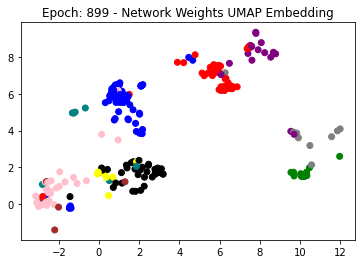

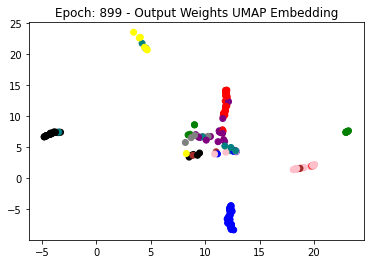

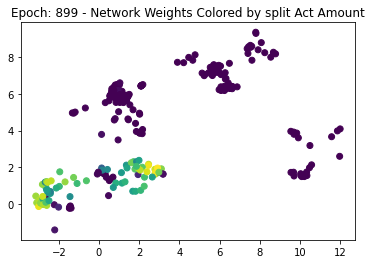

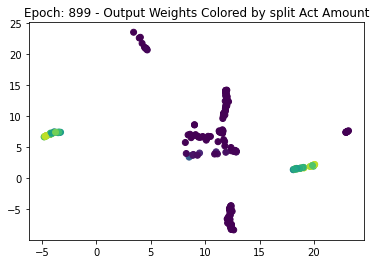

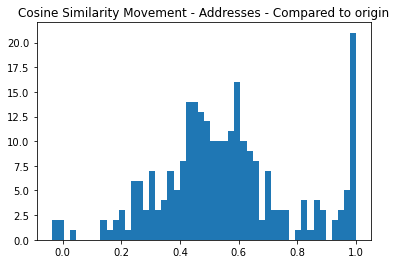

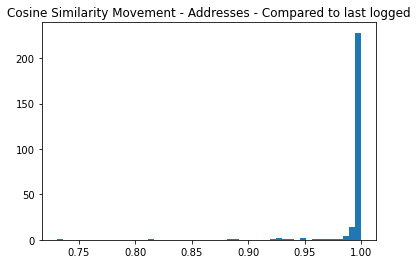

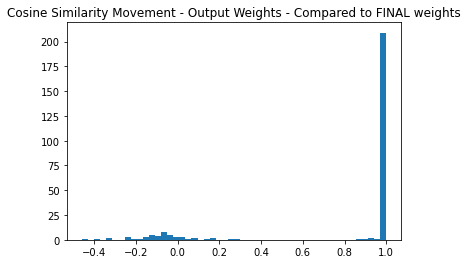

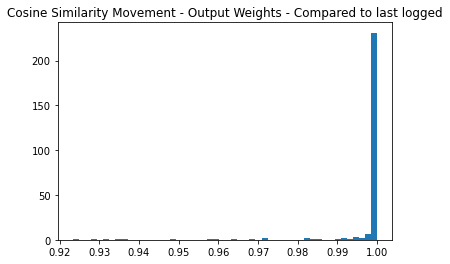

Epoch 999
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=999-step=78999.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2410)
Label 6, % neurons most activated=0.11
Label 7, % neurons most activated=0.06


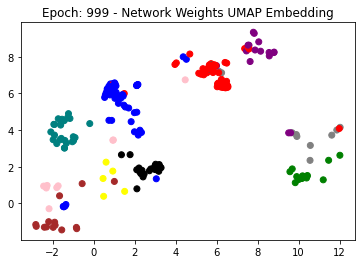

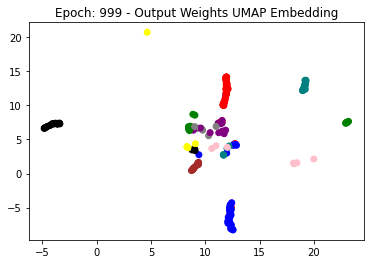

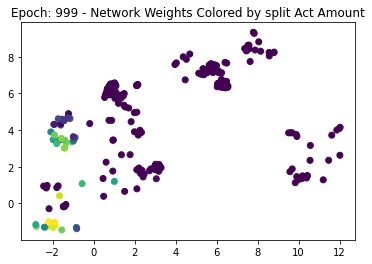

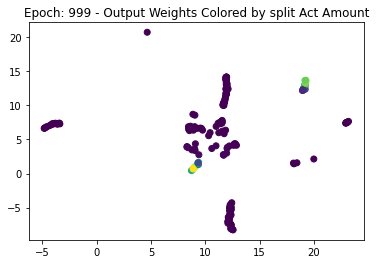

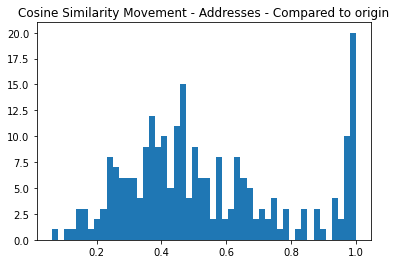

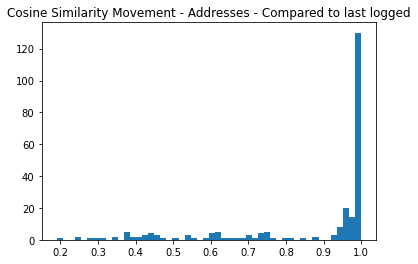

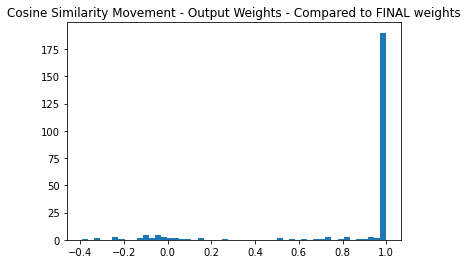

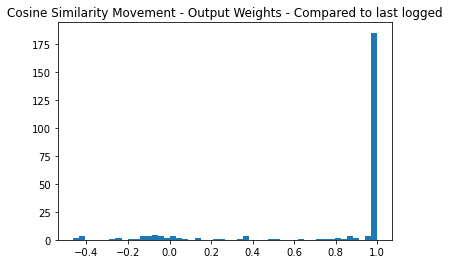

Epoch 1099
Data split 3
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=1099-step=86899.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2530)
Label 6, % neurons most activated=0.13
Label 7, % neurons most activated=0.08


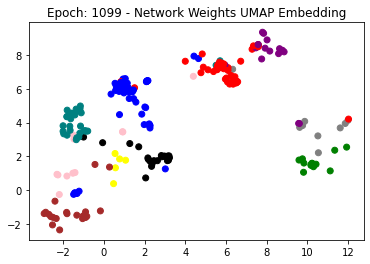

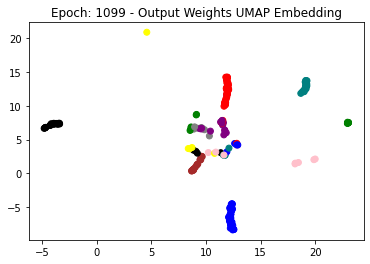

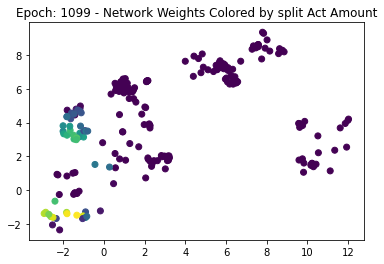

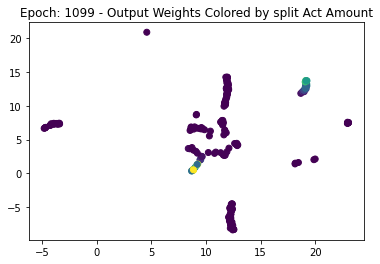

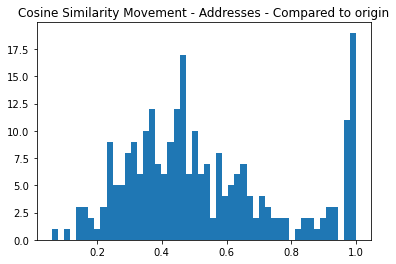

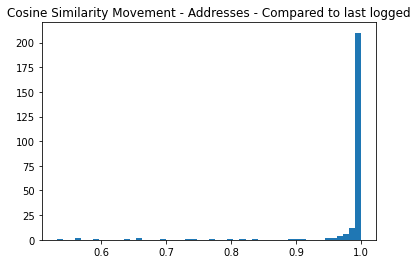

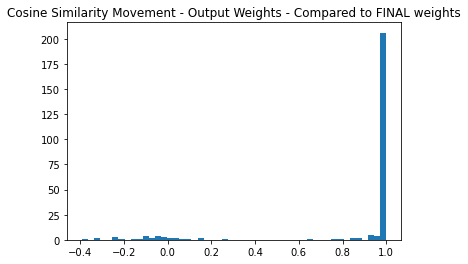

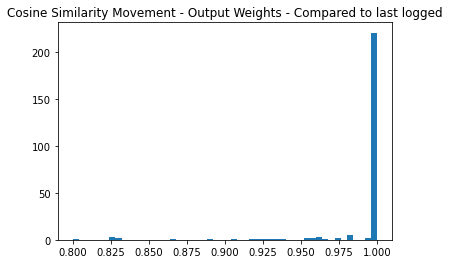

Epoch 1199
Data split 4


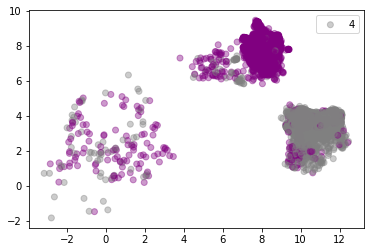

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=1199-step=94799.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2570)
Label 8, % neurons most activated=0.07
Label 9, % neurons most activated=0.04


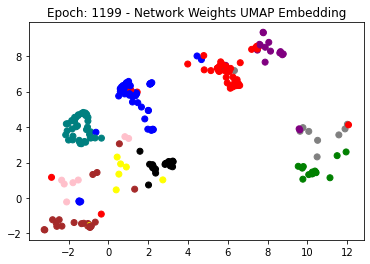

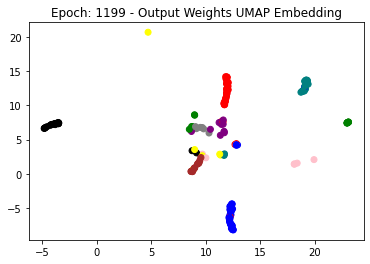

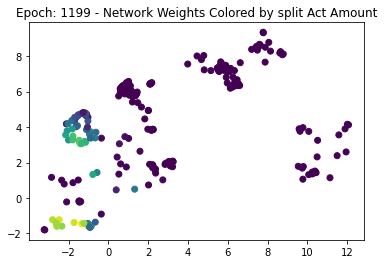

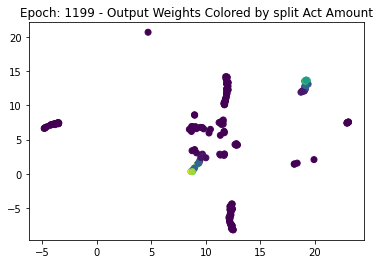

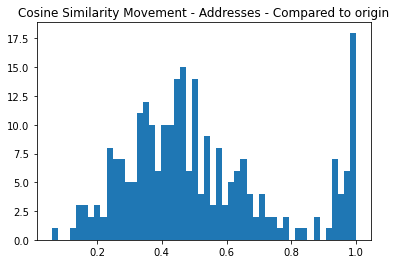

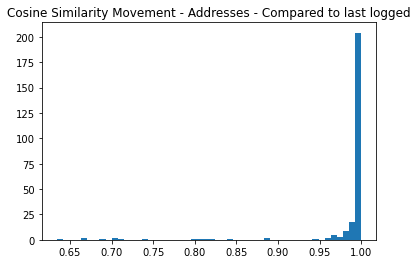

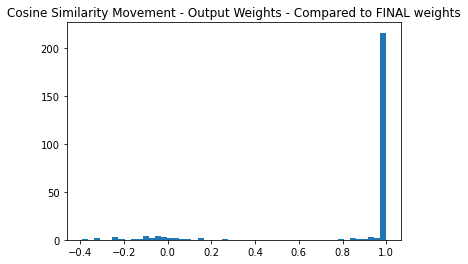

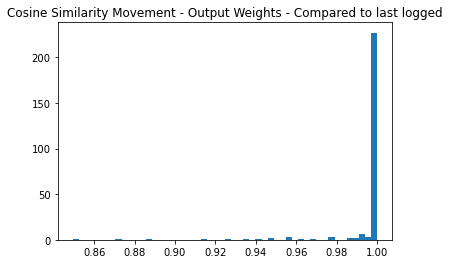

Epoch 1299
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=1299-step=102699.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2520)
Label 8, % neurons most activated=0.11
Label 9, % neurons most activated=0.05


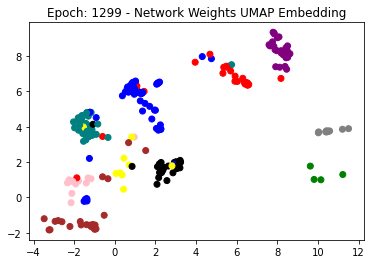

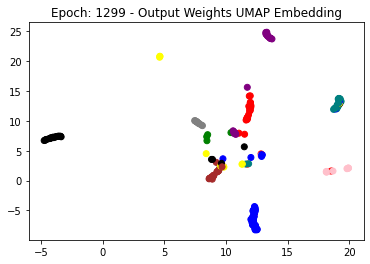

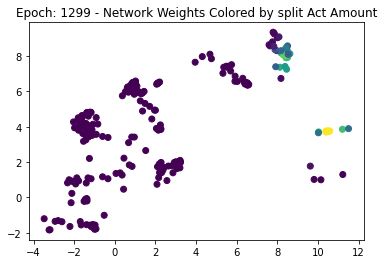

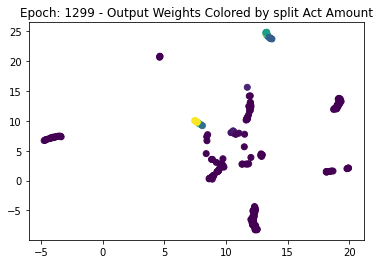

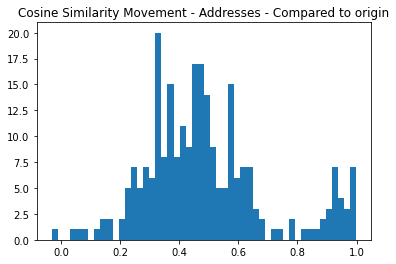

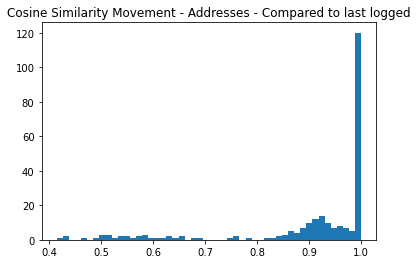

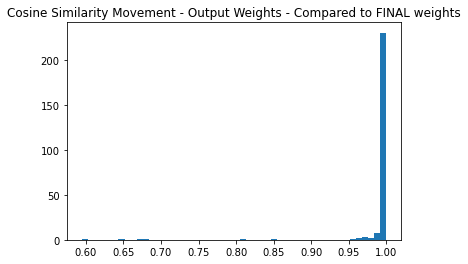

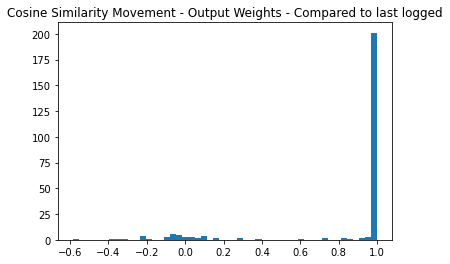

Epoch 1399
Data split 4
../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=1399-step=110599.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2660)
Label 8, % neurons most activated=0.12
Label 9, % neurons most activated=0.07


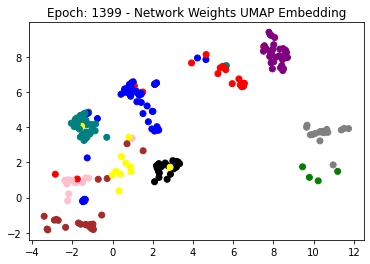

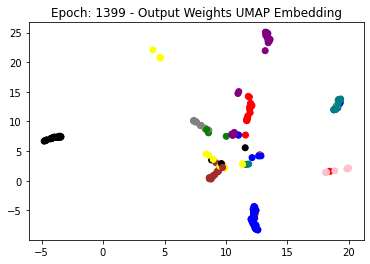

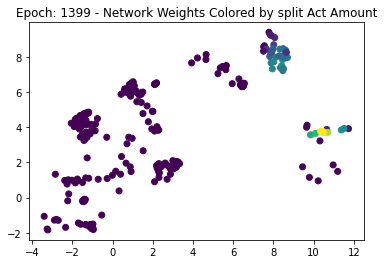

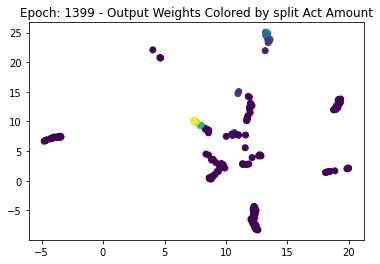

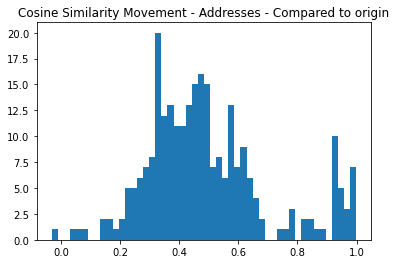

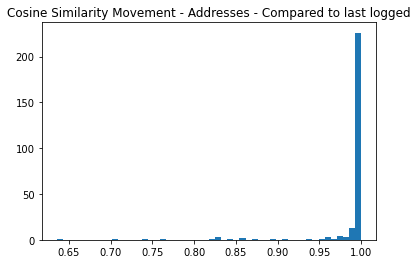

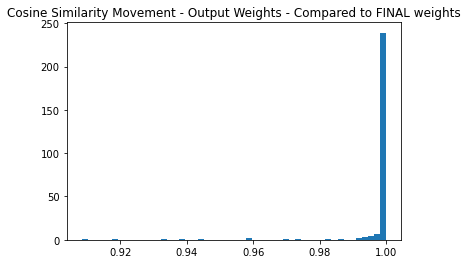

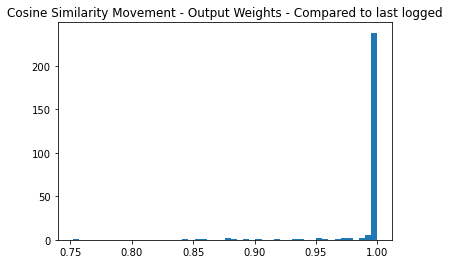

Epoch 1499
Data split 5


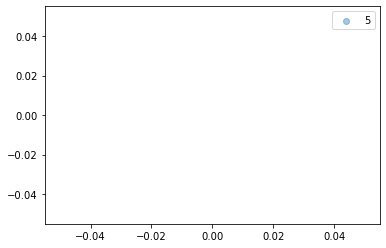

../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/f2baqhx6/checkpoints/epoch=1499-step=118499.ckpt /home/tbb16/Foundational-SDM/notebooks
CHANGING OUTPUT LAYER FOR CONTINUAL LEARNING ON NEW DATASET!
Perc alive neurons tensor(0.2750)


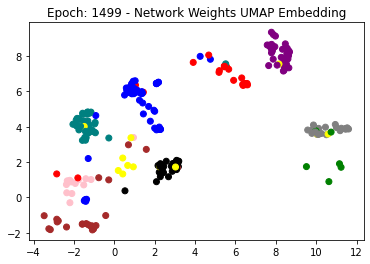

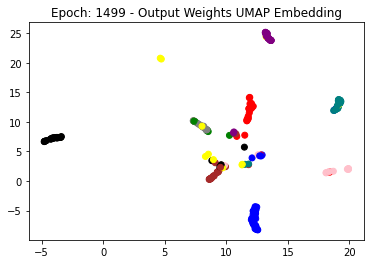

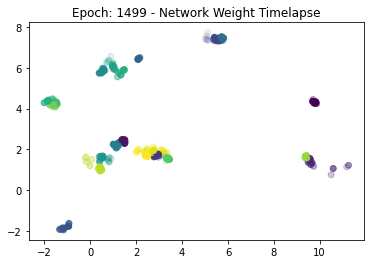

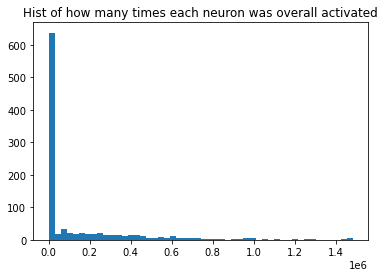

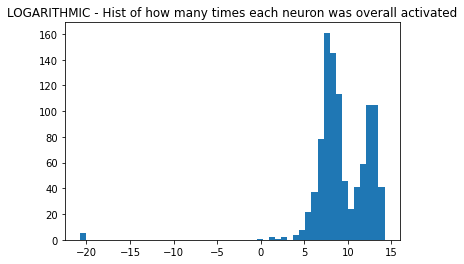

In [8]:
print_cosine = True 
print_output_weights = True 

for run in model_run_ids:

    # add the og model to the list of models. 
    src = f"../../scratch_link/Foundational-SDM/wandb_Logger/Foundational-SDM/{run}/checkpoints/*"
    model_checkpoints = glob.glob(src)
    ckpt = torch.load(model_checkpoints[0], map_location=device)
    og_model_path = "../"+ckpt['hyper_parameters']['load_from_checkpoint']
    
    print("===="*10)
    print("Run is:", run)
    print(ckpt['hyper_parameters']['test_name'], ckpt['hyper_parameters']['model_foundation'])
    print("===="*10)

    # sort the models. 
    models_dict = {0:og_model_path}
    for c in model_checkpoints:
        c_epoch = int(c.split('epoch=')[-1].split('-')[0])
        models_dict[c_epoch] = c
    sorted_models = list(models_dict.keys())
    sorted_models.sort()
    
    # load in the original model weights
    og_ckpt = torch.load(og_model_path, map_location=device)
    og_params = og_ckpt['hyper_parameters']
    og_params = SimpleNamespace(**og_params)
    #og_params.dataset = DataSet.Cached_ConvMixer_WTransforms_ImageNet32_ImageNet32
    og_weights, og_out_weights = get_weights(og_ckpt, og_params)
    og_out_weights = og_out_weights[:,:10]
    
    # get the dataset that corresponds to one of the data splits by loading in the last model. 
    # have the params from the split models too. 
    model_path = models_dict[sorted_models[-1]]
    ckpt = torch.load(model_path, map_location=device)
    params = ckpt['hyper_parameters']
    params = SimpleNamespace(**params)
    last_model_weights, last_model_out_weights = get_weights(ckpt, params)
    print("data path", dataset_path, "params", params)
    data_module = LightningDataModule(
            params,
            data_path=dataset_path
        )
    data_module.setup(None, train_shuffle=False, test_shuffle=False)
    
    # sort the pickles. Needed to wait to load in parameters from above. 
    act_pickles = glob.glob(f'../../scratch_link/Foundational-SDM/pickles/{params.test_name}_*')
    pickles_dict = {}
    for c in act_pickles:
        c_epoch = int(c.split('Learning_')[-1].split('_')[0])
        pickles_dict[c_epoch] = c
    sorted_pickles = list(pickles_dict.keys())
    sorted_pickles.sort()
    
    all_data = torch.stack( [d.images for d in data_module.train_datasets]).flatten(end_dim=1)
    all_labels = torch.stack( [d.img_labels for d in data_module.train_datasets]).flatten(end_dim=1)
    
    # ensure that weights and data are L2 normed if it is SDM!
    if "SDM" in str(params.model_foundation) and params.norm_addresses:
        all_data = all_data/torch.norm(all_data, dim=1, keepdim=True)
        
    # fit on the weights first
    reducer, all_data_embedding, og_weight_embedding = umap_data_and_weights(all_data, og_weights)
    
    # looking at activations using the original weights not the final ones. 
    activations = get_activations(all_data, og_model_path, og_params, extras) #get_activations(all_data,og_weights, ckpt)
        
    vals, inds = activations.max(dim=1)
    max_act_classes = all_labels[inds]
    
    plt.figure()
    plt.scatter(all_data_embedding[:, 0], all_data_embedding[:, 1], 
            c=map_colors(all_labels), alpha=0.1)
    plt.title("Training Data Manifold by Class")
    #plt.legend()
    plt.show()
    
    plt.figure()
    plt.scatter(og_weight_embedding[:, 0], og_weight_embedding[:, 1], 
            c=map_colors(max_act_classes))
    plt.title("Neurons Manifold by Class")
    #plt.legend()
    plt.show()
    
    if print_output_weights:
        out_reducer = umap.UMAP()  # parallel=False
        # fit to the last weights as these are meaningful
        out_reducer.fit(last_model_out_weights)
        og_out_weights_embedding = out_reducer.transform(og_out_weights)
        plt.figure()
        plt.scatter(og_out_weights_embedding[:, 0], og_out_weights_embedding[:, 1], 
                c=map_colors(max_act_classes))
        plt.title("Output Weights Manifold by Neuron Class (pre rand init)")
        #plt.legend()
        plt.show()
    
    ## L2 norm of the neuron weights: 
    plt.figure()
    plt.hist(torch.norm(og_weights, dim=1), bins=50)
    plt.title("L2 Norm of Neuron Weights")
    plt.show()
    
    if params.use_bias: 
        plt.figure()
        plt.hist(og_ckpt['state_dict']['fc1.bias'].flatten(), bins=50)
        plt.title("Size of bias terms")
        plt.show()
    
    
    # L2 norm of the data
    plt.figure()
    plt.hist(torch.norm(all_data, dim=1), bins=50)
    plt.title("L2 Norm of Data")
    plt.show()
    
    # which neurons are activated over the course of training: 
    # last pickle that has all the neuron activation amounts. 
    # should I also be storing the gradients? 
    pic = pickle.load(open(pickles_dict[sorted_pickles[-1]], 'rb'))
    all_splits_frac_activated_sum = pic['over_all_splits_fraction_activated'].sum(0)
    
    # removing dead neurons
    full_act_weights_mask = all_splits_frac_activated_sum>dead_threshold_activation_amount
    print("Perc alive neurons", full_act_weights_mask.type(torch.float).mean())
    live_og_weight_embedding = og_weight_embedding[full_act_weights_mask]
    live_max_act_classes = max_act_classes[full_act_weights_mask]
    live_all_splits_frac_activated_sum = all_splits_frac_activated_sum[full_act_weights_mask]
    
    plt.figure()
    plt.scatter(live_og_weight_embedding[:, 0], live_og_weight_embedding[:, 1], 
            c=map_colors(live_max_act_classes))
    plt.title("Alive Neurons - Manifold by Class")
    #plt.legend()
    plt.show()
    
    if print_output_weights:
        live_og_out_weights_embedding = og_out_weights_embedding[full_act_weights_mask]
        
        plt.figure()
        plt.scatter(live_og_out_weights_embedding[:, 0], live_og_out_weights_embedding[:, 1], 
                c=map_colors(live_max_act_classes))
        plt.title("Alive Output Weights - Manifold by Neuron Class (pre rand init)")
        #plt.legend()
        plt.show()
    
    plt.figure()
    plt.scatter(live_og_weight_embedding[:, 0], live_og_weight_embedding[:, 1], 
            c=live_all_splits_frac_activated_sum, 
            alpha=1)
    plt.title(f"OG weights - Number of times each neuron was activated")
    plt.show()
    
    plt.figure()
    plt.scatter(live_og_weight_embedding[:, 0], live_og_weight_embedding[:, 1], 
            c=(live_all_splits_frac_activated_sum+1e-9).log(), 
            alpha=1)
    plt.title(f"OG weights - LOG - Number of times each neuron was activated")
    plt.show()
    
    if print_cosine: 
        prev_weights = copy.deepcopy(og_weights)
        prev_out_weights = copy.deepcopy(og_out_weights)
    
    # showing evolution of the weights in the context of the data
    for mind, k in enumerate(sorted_models): 

        data_split_ind = (k+1)//params.epochs_per_dataset
        print("Epoch", k)
        print(f"Data split {data_split_ind}")
        
        # embedding from the data split: 
        if (k+1)%params.epochs_per_dataset==0 or mind==0:
            # then it is a new split
            start_ind, end_ind = data_split_ind*imgs_per_split, (data_split_ind+1)*imgs_per_split
            print("==="*10)
            plt.figure()
            plt.scatter(all_data_embedding[start_ind:end_ind, 0], 
                        all_data_embedding[start_ind:end_ind, 1], 
                        c=map_colors(all_labels[start_ind:end_ind]), 
                        label=f"{data_split_ind}", alpha=0.4)
            plt.legend()
            plt.show()


        model_path = models_dict[k]
        ckpt = torch.load(model_path, map_location=device)
        params = ckpt['hyper_parameters']
        params = SimpleNamespace(**params)

        all_weights, all_out_weights = get_weights(ckpt, params) #ckpt['state_dict']['sdm_module.fc1.weight']

        if all_out_weights.shape[1]>10:
            print("Trimming the output weights. model index is:", mind)
            all_out_weights = all_out_weights[:,:10]
        # assuming that the data has already been L2 normed. 
        activations = get_activations(all_data, model_path, params, extras)#get_activations(all_data,all_weights, ckpt)
        
        # removing dead neurons. now using the activations from the current state of the weights
        weights_mask = activations.sum(1)>dead_threshold_activation_amount
        print("Perc alive neurons", weights_mask.type(torch.float).mean())
        live_activations = activations[weights_mask]
        live_weights = all_weights[weights_mask]

        vals, inds = live_activations.max(dim=1)
        max_act_classes = all_labels[inds]

        # how many neurons are most active from each class? 
        for split_label in all_labels[start_ind:end_ind].unique():
            print(f"Label {split_label}, % neurons most activated={round( float((max_act_classes==split_label).type(torch.float).mean().numpy()), 2)}")

        select_weights = live_weights

        embedding = reducer.transform(select_weights)
        plt.figure()
        plt.scatter(embedding[:, 0], embedding[:, 1], c=map_colors(max_act_classes), alpha=1)
        plt.title(f"Epoch: {k} - Network Weights UMAP Embedding") 
        plt.show()
        
        if print_output_weights:
            live_out_weights = all_out_weights[weights_mask]
            live_out_weights_embedding = out_reducer.transform(live_out_weights)
            plt.figure()
            plt.scatter(live_out_weights_embedding[:, 0], live_out_weights_embedding[:, 1], 
                    c=map_colors(max_act_classes))
            plt.title(f"Epoch: {k} - Output Weights UMAP Embedding")
            #plt.legend()
            plt.show()
        
        if mind == (len(sorted_models)-1):
            # there is no final storage of pickle
            continue
            #mind = mind-1

        pic = pickle.load(open(pickles_dict[sorted_pickles[mind]], 'rb'))
        pic_acts = pic['over_all_splits_fraction_activated'] if data_split_or_overall == 'overall' else pic['split_fraction_activated']
        live_pic_acts = pic_acts.sum(0)[weights_mask]

        # also show the number of activations here
        plt.figure()
        plt.scatter(embedding[:, 0], embedding[:, 1], c=live_pic_acts, alpha=1)
        plt.title(f"Epoch: {k} - Network Weights Colored by {data_split_or_overall} Act Amount")
        plt.show()
        
        if print_output_weights:
            plt.figure()
            plt.scatter(live_out_weights_embedding[:, 0], live_out_weights_embedding[:, 1], 
                    c=live_pic_acts)
            plt.title(f"Epoch: {k} - Output Weights Colored by {data_split_or_overall} Act Amount")
            #plt.legend()
            plt.show()
        
        # cosine plots
        if print_cosine:
            # everything is already l2 normed? 
            weight_cosine_sims = compute_cosine_sim(og_weights[weights_mask],select_weights)
            # most of these should be 1. want to see how many are much larger
            plt.hist(weight_cosine_sims, bins=50)
            plt.title("Cosine Similarity Movement - Addresses - Compared to origin")
            plt.show()

            # everything is already l2 normed? 
            weight_cosine_sims = compute_cosine_sim(prev_weights[weights_mask],select_weights)
            # most of these should be 1. want to see how many are much larger
            plt.hist(weight_cosine_sims, bins=50)
            plt.title("Cosine Similarity Movement - Addresses - Compared to last logged")
            plt.show()

            prev_weights = copy.deepcopy(all_weights)
            
            if print_output_weights:
                
                weight_cosine_sims = compute_cosine_sim(last_model_out_weights[weights_mask],live_out_weights)
                # most of these should be 1. want to see how many are much larger
                plt.hist(weight_cosine_sims, bins=50)
                plt.title("Cosine Similarity Movement - Output Weights - Compared to FINAL weights")
                plt.show()

                # everything is already l2 normed? 
                weight_cosine_sims = compute_cosine_sim(prev_out_weights[weights_mask],live_out_weights)
                # most of these should be 1. want to see how many are much larger
                plt.hist(weight_cosine_sims, bins=50)
                plt.title("Cosine Similarity Movement - Output Weights - Compared to last logged")
                plt.show()
                
                prev_out_weights = copy.deepcopy(all_out_weights)
        
    # time lapse of the neuron weights.
    rand_inds = np.random.choice(np.arange(full_act_weights_mask.sum()), size = num_points, replace=False)
    
    plt.figure()
    for mind, k in enumerate(sorted_models):
        model_path = models_dict[k]
        ckpt = torch.load(model_path, map_location=device)
        params = ckpt['hyper_parameters']
        params = SimpleNamespace(**params)
        all_weights, all_out_weights = get_weights(ckpt, params) #getckpt['state_dict']['sdm_module.fc1.weight']
        select_weights = all_weights[full_act_weights_mask][rand_inds]
        embedding = reducer.transform(select_weights)
        alpha = 0.1+ ( (0.9/len(sorted_models))*mind )
        plt.scatter(embedding[:, 0], embedding[:, 1], c=np.arange(len(embedding)), alpha=alpha)
    plt.title(f"Epoch: {k} - Network Weight Timelapse")
    plt.show()
    
    # pickles: 
    # show overall activations: 
    plt.figure()
    plt.hist(all_splits_frac_activated_sum, bins=50)
    plt.title("Hist of how many times each neuron was overall activated")
    plt.show()
    
    plt.figure()
    plt.hist((all_splits_frac_activated_sum+1e-9).log(), bins=50)
    plt.title("LOGARITHMIC - Hist of how many times each neuron was overall activated")
    plt.show()
    
    

In [7]:
mind

1

In [4]:
prev_out_weights[weights_mask].shape#,live_out_weights

torch.Size([428, 1000])

In [6]:
og_out_weights.shape

torch.Size([1000, 10])

In [5]:
live_out_weights.shape

torch.Size([428, 10])

(array([ 1.,  0.,  0.,  0.,  0.,  1.,  0.,  1.,  0.,  1.,  2.,  0.,  1.,
         1.,  4.,  2.,  7.,  7.,  8., 11., 10., 19., 28., 44., 44., 67.,
        71., 75., 77., 63., 63., 43., 60., 53., 37., 29., 30., 27., 29.,
        19., 24., 14.,  9.,  6.,  8.,  1.,  1.,  1.,  0.,  1.]),
 array([-5.1690000e-01, -4.6998546e-01, -4.2307091e-01, -3.7615639e-01,
        -3.2924184e-01, -2.8232729e-01, -2.3541276e-01, -1.8849821e-01,
        -1.4158368e-01, -9.4669141e-02, -4.7754597e-02, -8.4005715e-04,
         4.6074484e-02,  9.2989028e-02,  1.3990356e-01,  1.8681811e-01,
         2.3373264e-01,  2.8064719e-01,  3.2756174e-01,  3.7447625e-01,
         4.2139080e-01,  4.6830535e-01,  5.1521987e-01,  5.6213444e-01,
         6.0904896e-01,  6.5596354e-01,  7.0287806e-01,  7.4979258e-01,
         7.9670715e-01,  8.4362167e-01,  8.9053619e-01,  9.3745077e-01,
         9.8436528e-01,  1.0312798e+00,  1.0781944e+00,  1.1251090e+00,
         1.1720234e+00,  1.2189380e+00,  1.2658526e+00,  1.3127670e+

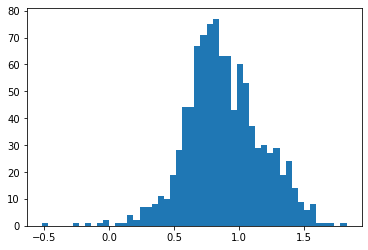

In [9]:
plt.hist(og_ckpt['state_dict']['fc1.bias'].flatten(), bins=50)

In [8]:
og_ckpt['state_dict']['fc1.bias'].shape

torch.Size([1000])

In [13]:
((og_weights@all_data.T) + ckpt['state_dict']['fc1.bias'].unsqueeze(1)).shape

torch.Size([1000, 50000])